In [1]:
import gym
import numpy as np
import pandas as pd
import seaborn as sns
from gym import spaces
import matplotlib.pyplot as plt

 # Very broad Introduction
 
The notebook's purpose is to develop and implement a custom environment for the hydrogen refuelling station. This environment will be the basic brick of the RL approach for the minimization of electric costs. 
In order to be able to implement this environment it will be useful to just remind the basic blocks of Reinforcement Learning. To implement RL approaches, there are three main components, the need to be defined:

- An **Environment**: It contains everything outside the agent and everything it interacts with.

- A **state**: The representation of the environment, the agent receives. The set of all potential states. The state space corresponds to all possible states in which our agent can evolve in.

- **Actions**: From the state received, the agente takes an action. The set of all potential action space is the action space.

Both action space and state space, can either be discrete or continuous.

It is necessary to have a precise definition of these three parts for the RL environment.
- How is the state space going to be defined ?
- What is the environment that ought to be chosen ?
- What actions will be defined first ?

But first and foremost:
- What is the main purpose of the agent ? For this, the answer is clear, the agent will have to minimize electricity costs. Another fundamental concept in RL is the **reward** function that needs to be maximized.

In order to implement the some data is imported so that different classes and methods can be tested.


# Importing data

For this study, a toy example of data will be used. This dataframe contains the wind speed indications from a ground station in the north west of France, and it contains a simulated hydrogen demand based on a poisson process.

In [2]:
wind_hydrogen = pd.read_csv('../data/wind_hydrogen_data_2.csv', parse_dates=['date'], 
                            date_parser=pd.to_datetime)
wind_hydrogen_15min = pd.read_csv('../data/wind_hydrogen_data_15min.csv', parse_dates=['date'], 
                            date_parser=pd.to_datetime)

In [3]:
wind_hydrogen.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26304 entries, 0 to 26303
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   date                26304 non-null  datetime64[ns]
 1   wind_speed          26286 non-null  float64       
 2   fcev_demand_hourly  26304 non-null  int64         
 3   h2_amount           26304 non-null  float64       
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 822.1 KB


In [4]:
wind_hydrogen_15min.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 105216 entries, 0 to 105215
Data columns (total 4 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   date         105216 non-null  datetime64[ns]
 1   wind_speed   105120 non-null  float64       
 2   fcev_demand  105216 non-null  int64         
 3   h2_amount    105216 non-null  float64       
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 3.2 MB


In [7]:
wind_hydrogen = wind_hydrogen.astype({"fcev_demand_hourly": float})
wind_hydrogen_15min = wind_hydrogen_15min.astype({"fcev_demand": float})

In [8]:
wind_hydrogen.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26304 entries, 0 to 26303
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   date                26304 non-null  datetime64[ns]
 1   wind_speed          26286 non-null  float64       
 2   fcev_demand_hourly  26304 non-null  float64       
 3   h2_amount           26304 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 822.1 KB


In [9]:
def grid_tariffs(date):
    
    month = date.month
    hour = date.hour
    
    if month in [1, 2, 12]:
        
        if (hour >= 6 and hour < 8) or \
        (hour >= 10 and hour < 17) or \
        (hour >= 19 and hour < 22):
            
            x = 'HPH'
            
        elif (hour >= 8 and hour < 10) or \
        (hour >= 17 and hour <= 19):
            
            x = 'P'
            
        else:
            x = 'HCH'
            
    elif month in [3, 11]:
        
        if hour >= 6 and hour < 22:
            x = 'HPH'
        else:
            x = 'HCH'
    else:
        if hour >= 6 and hour < 22:
            x = 'HPE'
        else:
            x = 'HCE'
            
    return x

In [10]:
wind_hydrogen['tariffs'] = wind_hydrogen['date'].map(grid_tariffs)

In [12]:
wind_hydrogen_15min['tariffs'] = wind_hydrogen_15min['date'].map(grid_tariffs)

In [13]:
wind_hydrogen_15min.tail()

,date,wind_speed,fcev_demand,h2_amount,tariffs
105211,2018-12-31 22:45:00,1.900000,3.0,9.39,HCH
105212,2018-12-31 23:00:00,2.000000,1.0,3.13,HCH
105213,2018-12-31 23:15:00,1.700000,1.0,3.13,HCH
105214,2018-12-31 23:30:00,1.866667,1.0,3.13,HCH
105215,2018-12-31 23:45:00,2.250000,1.0,3.13,HCH


In [14]:
wind_hydrogen.tail()

,date,wind_speed,fcev_demand_hourly,h2_amount,tariffs
26299,2018-12-31 19:00:00,0.95,4.0,12.52,HPH
26300,2018-12-31 20:00:00,1.71,2.0,6.26,HPH
26301,2018-12-31 21:00:00,2.16,4.0,12.52,HPH
26302,2018-12-31 22:00:00,1.97,1.0,3.13,HCH
26303,2018-12-31 23:00:00,1.95,2.0,6.26,HCH


In [15]:
wind_hydrogen.set_index('date', inplace=True)

In [16]:
wind_hydrogen_15min.set_index('date', inplace=True)

In [17]:
wind_hydrogen['month'] = wind_hydrogen.index.month
wind_hydrogen['hour'] = wind_hydrogen.index.hour

In [18]:
wind_hydrogen_15min['month'] = wind_hydrogen_15min.index.month
wind_hydrogen_15min['hour'] = wind_hydrogen_15min.index.hour

In [19]:
wind_hydrogen.head()

,wind_speed,fcev_demand_hourly,h2_amount,tariffs,month,hour
date,,,,,,
2016-01-01 00:00:00,3.05,2.0,6.26,HCH,1,0
2016-01-01 01:00:00,2.57,3.0,9.39,HCH,1,1
2016-01-01 02:00:00,2.26,3.0,9.39,HCH,1,2
2016-01-01 03:00:00,2.62,3.0,9.39,HCH,1,3
2016-01-01 04:00:00,2.99,2.0,6.26,HCH,1,4


In [20]:
wind_hydrogen_15min.head()

,wind_speed,fcev_demand,h2_amount,tariffs,month,hour
date,,,,,,
2016-01-01 00:00:00,4.033333,3.0,9.39,HCH,1,0
2016-01-01 00:15:00,3.100000,0.0,0.00,HCH,1,0
2016-01-01 00:30:00,2.600000,0.0,0.00,HCH,1,0
2016-01-01 00:45:00,2.200000,1.0,3.13,HCH,1,0
2016-01-01 01:00:00,2.666667,1.0,3.13,HCH,1,1


Now that tarifs are fixed based on EDF tarif Vert A5 2022: https://www.fournisseurs-electricite.com/edf/pro/tarifs-reglementes/vert#Le_tarif_vert_A5

Below is a dictionary matching the time period as key and the price as value. For the price, EDF distinguishes them by span of use. It will be considered that a hydrogen refuelling station is in the "Très Longues Utilisation" category. It is then this price range that will be used for now.

In [21]:
price_dict = {"P": 7.154, 
              "HPH": 5.820, 
              "HCH": 4.452,
              "HPE": 4.458,
              "HCE": 2.820}

In [35]:
# Mapping tarifs to their prices
wind_hydrogen['prices'] = wind_hydrogen['tariffs'].map(price_dict)

KeyError: 'tariffs'

In [22]:
# Mapping tarifs to their prices
wind_hydrogen_15min['prices'] = wind_hydrogen_15min['tariffs'].map(price_dict)

In [23]:
wind_hydrogen.head()

,wind_speed,fcev_demand_hourly,h2_amount,tariffs,month,hour
date,,,,,,
2016-01-01 00:00:00,3.05,2.0,6.26,HCH,1,0
2016-01-01 01:00:00,2.57,3.0,9.39,HCH,1,1
2016-01-01 02:00:00,2.26,3.0,9.39,HCH,1,2
2016-01-01 03:00:00,2.62,3.0,9.39,HCH,1,3
2016-01-01 04:00:00,2.99,2.0,6.26,HCH,1,4


In [24]:
wind_hydrogen.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 26304 entries, 2016-01-01 00:00:00 to 2018-12-31 23:00:00
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   wind_speed          26286 non-null  float64
 1   fcev_demand_hourly  26304 non-null  float64
 2   h2_amount           26304 non-null  float64
 3   tariffs             26304 non-null  object 
 4   month               26304 non-null  int64  
 5   hour                26304 non-null  int64  
dtypes: float64(3), int64(2), object(1)
memory usage: 1.4+ MB


In [25]:
wind_hydrogen.isna().sum(axis=0)

wind_speed            18
fcev_demand_hourly     0
h2_amount              0
tariffs                0
month                  0
hour                   0
dtype: int64

In [26]:
wind_hydrogen_15min.isna().sum(axis=0)

wind_speed     96
fcev_demand     0
h2_amount       0
tariffs         0
month           0
hour            0
prices          0
dtype: int64

In [27]:
# replacing missing values with forward fill
wind_hydrogen.fillna(method='ffill', inplace=True)

In [28]:
# replacing missing values with forward fill
wind_hydrogen_15min.fillna(method='ffill', inplace=True)

In [29]:
wind_hydrogen.isna().sum(axis=0)

wind_speed            0
fcev_demand_hourly    0
h2_amount             0
tariffs               0
month                 0
hour                  0
dtype: int64

In [30]:
wind_hydrogen_15min.isna().sum(axis=0)

wind_speed     0
fcev_demand    0
h2_amount      0
tariffs        0
month          0
hour           0
prices         0
dtype: int64

In [31]:
#wind_hydrogen = wind_hydrogen[["wind_speed", "fcev_demand", "h2_amount", "month", "hour", "prices"]]
# Easier to just drop the column
wind_hydrogen.drop(['tariffs'], axis=1, inplace=True)

In [32]:
#wind_hydrogen = wind_hydrogen[["wind_speed", "fcev_demand", "h2_amount", "month", "hour", "prices"]]
# Easier to just drop the column
wind_hydrogen_15min.drop(['tariffs'], axis=1, inplace=True)

In [33]:
wind_hydrogen.head()

,wind_speed,fcev_demand_hourly,h2_amount,month,hour
date,,,,,
2016-01-01 00:00:00,3.05,2.0,6.26,1,0
2016-01-01 01:00:00,2.57,3.0,9.39,1,1
2016-01-01 02:00:00,2.26,3.0,9.39,1,2
2016-01-01 03:00:00,2.62,3.0,9.39,1,3
2016-01-01 04:00:00,2.99,2.0,6.26,1,4


In [36]:
# Dividing the price by 100 to get the amount in euros
wind_hydrogen_15min['prices'] /= 100
wind_hydrogen_15min.head()

,wind_speed,fcev_demand,h2_amount,month,hour,prices
date,,,,,,
2016-01-01 00:00:00,4.033333,3.0,9.39,1,0,0.04452
2016-01-01 00:15:00,3.100000,0.0,0.00,1,0,0.04452
2016-01-01 00:30:00,2.600000,0.0,0.00,1,0,0.04452
2016-01-01 00:45:00,2.200000,1.0,3.13,1,0,0.04452
2016-01-01 01:00:00,2.666667,1.0,3.13,1,1,0.04452


# HRS modelling

It is believed, that the problem of electricity cost minimization, a RL approach can be considered becaus it is believed that the environment would follow a markovian assumption. And that it is possible to take actions that aim at effectively reducing electricity costs.

- It should be kept in mind that the study will be focused on the case of an on-site hydrogen production refuelling station with a mixed energy source (grid + wind turbine)

## Presenting the different components of the refuelling station

There are basically three main components for the HRS:
- Energy sources
    - The renewable energy source producing electricity on-site (for free at this level), as mentionned above only a wind turbine will be considered
    - The main electricity grid containing which supplies electricity if/when needed when renewable energies are not enough. The main grid sells electricity at different tarifs depending on the time of day it is being purchased (based on demand). But it is also possible to sell electricity to the station.

- The refuelling station *complex*, made of all the components:
    - The producing part (electrolysis) which produces hydrogen from water electrolysis, no other technology will be conisdered
    - The storage part: Low pressure hydrogen and after compression, high pressure hydrogen storage tanks
    - The refuelling part: Which distributes hydrogen to vehicles
- Finally the demand side:
    - The FCEVs demand for hydrogen

These make the basic building blocks of the environment and give a precise idea of the potential actions to be taken and state spaces.

But the environment is also made of important information that are available and that play crucial role in the actions taken. Two at least can be taken into consideration:
- The weather data and prediction, because it is essential for the renewable electricity production part
    - In the case of wind electricity wind speed will be necessary, and perhaps the time
- The anticipated demand of hydrogen (a simulation for the moment)

All these components should be modelled in order to make the custom environment.

# Renewable energy components

# Wind turbine representation

The wind turbine, produces electricity in certain certain wind-speed range that are named cut-in speed and cut-out speed. It starts producing electricity when wind speed reaches the level of the cut-in speed, and then it production increases with wind speed up until it reaches a maximum speed limit the cut-out speed after which the turbine stops turning.

A `WindTurbine` class would then require two attributes:
    - Cut-in speed
    - Cut-out speed
And it should contain at least one method `WindTurbine.power_generation(self, speed)` for computing the amount of electricity produced.

In [37]:
class WindTurbine:
    
    def __init__(self, cut_in_speed=3.5, cut_out_speed=20, 
                 rated_speed=10, rated_power=100):
        
        self.cut_in_speed = cut_in_speed
        self.cut_out_speed = cut_out_speed
        self.rated_speed = rated_speed
        self.rated_power = rated_power
        #self.power = power
        
    def power_generation(self, speed):
        
        if speed <= self.cut_in_speed or speed >= self.cut_out_speed:
            
            power = 0. # put the formula here
            
        elif speed >= self.cut_in_speed and speed < self.rated_speed:
            
            denominator = self.rated_speed - self.cut_in_speed
            
            power = speed * (self.rated_power / denominator) 
            power-= self.rated_power * (self.cut_in_speed / denominator)
            # write at the end annoying
            
        elif speed >= self.rated_speed and speed < self.cut_out_speed:
            
            power = self.rated_power
        else:
            raise ValueError('There is a problem')
            
        return power

In [38]:
wt0 = wind_hydrogen.iloc[100]
ws = wt0['wind_speed']

In [39]:
ws

5.42

In [40]:
wt = WindTurbine()
wt.power_generation(ws)

29.53846153846154

# The Hydrogen refuelling station

- The HRS is made of several components, and each of these should be made in a class of its own. Namely:
    - The `Electrolyser` class, implementing the electrolyser
    - The `Compressor` class
    - The `StorageTanks` implementing the hydrogen storage tanks, for the moment no difference will be made concerning low or high pressure storage tanks, even though the difference is important
    - The `PreCooling` class implementing the pre-cooling unit that arrives before distributing hydrogen
    
Except the storage, all other components consume electricity, they must all have a common method `cls.power_consumption()`. The method computes the amount of power consumed by each component.

## The Electrolyser

In [41]:
class Electrolyser:
    
    def __init__(self, lhv=33.3, efficiency=0.6, 
                 min_power=0, max_power=600, hour_prod=10):
        
        self._lhv = lhv # in kWh/kg
        self._efficiency = efficiency # 60%
        self._min_power = min_power # kW
        self._max_power = max_power # kW
        self._hour_prod = hour_prod # hydrogen produced per hour in kg
        
    def power_consumption(self, delta=1):
        
        numerator = self._hour_prod * self._lhv
        denominator = self._efficiency * delta
        power_need = (numerator / denominator) * 100
        return power_need

    def get_hour_prod(self):
        """returns the amount of hydrogen produced per hour. 
        It is a private attribute, that is given at instanciation"""
        return self._hour_prod

In [42]:
elec = Electrolyser()
elec.power_consumption()

55500.0

In [43]:
class Compressor:
    
    def __init__(self, heat_cp=14.304, 
                 pressure_in=1, pressure_out=90, 
                 t_in=293, motor_eff=0.9, 
                 comp_eff=0.7, r=1.4):
        
        # Specific heat of hydrogen at constant pressure [kJ/kg/K]
        self.heat_cp = heat_cp
        self.pressure_in = pressure_in # MPa
        self.pressure_out = pressure_out # MPa
        self.t_in = t_in # Hydrogen temperature at the compressor inlet [K]
        self.motor_eff = motor_eff # %
        self.comp_eff = comp_eff # %
        self.r = r # ratio of specific heat of hydrogen
    
    def power_consumption(self, hy_prod, delta=1):
        
        power = self.heat_cp * ((self.t_in * 1e4)/self.motor_eff * self.comp_eff * delta)
        power = power * ((self.pressure_out/self.pressure_in)**((self.r-1)/self.r) - 1)
        power = power * (hy_prod / 3600)
        
        return power

In [44]:
comp = Compressor()
comp.power_consumption(10)

236968.62556073593

## The storage tank

In [45]:
class StorageTank:
    
    def __init__(self, 
                 min_capacity=3, 
                 max_capacity=30, 
                 loss_coef=0.01):
        
        self.min_capacity = min_capacity # kg
        self.max_capacity = max_capacity # kg
        self.loss_coef = loss_coef # %
        self.capacity = max_capacity / 2 # should perhaps be made into a private attribute ._capacity
        
    def available_amount(self, step_idx, h_prod_elec, h_demand):

        storage_amount = (1 - self.loss_coef)*self.capacity

        storage_amount = storage_amount + h_prod_elec - h_demand

        self.capacity = storage_amount

    def get_capacity(self):

        return self.capacity

    def set_capacity(self, capacity):
        
        self.capacity = capacity

    def store_hydrogen(self, hy_amount):

        self.capacity += hy_amount

## The Pre cooling unit

In [46]:
class PreCooling:
    
    def __init__(self, chill_energy=0.33):
        
        self.chill_energy = chill_energy
    
    def power_consumption(self, hy_demand):
        
        return self.chill_energy * hy_demand

In [47]:
precool = PreCooling()
precool.power_consumption(8.)

2.64

## The hydrogen station

The hydrogen station just takes all the previously developped components and puts them together.

In [48]:
class HydrogenStation:
    
    def __init__(self, wind_turbine):
        """Class for the hydrogen station, using all different components of the station, 
        the electrolyser, the compressor, the storage tank, the pre cooling unit in addition
        to the renewable energy components"""
        
        self.electrolyser = Electrolyser()
        self.compressor = Compressor()
        self.storage_tank = StorageTank()
        self.pre_cooling = PreCooling()
        self.wind_turbine = wind_turbine
        
        
    def power_consumption(self, hy_demand, wind_speed, 
                          delta_elec=1., delta_comp=1., clean=True):

        hy_prod = self.electrolyser.get_hour_prod() # get the hour production of the electrolyser

        pc_elec = self.electrolyser.power_consumption(delta_elec)
        pc_comp = self.compressor.power_consumption(delta_comp, hy_prod) # hourly production
        pc_precool = self.pre_cooling.power_consumption(hy_demand)

        # Compute the amount of power necessary for the station's components
        pc_total = pc_elec + pc_comp + pc_precool
        
        if clean:
            # Get the clean power production
            clean_power = self._clean_energy_production(wind_speed)

            # Compute total needed power
            required_power = pc_total - clean_power
            
            if required_power <= 0.:
                
                return 0.
            
            else:
                
                return required_power
            
        else:
            
            return pc_total


    def buy_from_grid(self, hy_demand, price, wind_speed, 
                      delta_elec=1, delta_comp=1, clean=True):

        required_power = self.power_consumption(hy_demand, wind_speed, 
                                                delta_elec, delta_comp, clean)
        elec_price = required_power * price

        return elec_price

    def _clean_energy_production(self, wind_speed):

        clean_power = self.wind_turbine.power_generation(wind_speed)
        return clean_power


    def refuel(self, hy_demand, wind_speed, price):

        capacity = self.storage_tank.get_capacity()

        if h_demand <= capacity:

            capacity -= hy_demand
            self.storage_tank.set_capacity(capacity) # Updates the storage capacity

        else: # Hydrogen needs to be produced
            required_power = self.power_consumption(hy_demand, wind_speed)
            elec_price = self.buy_from_grid(required_power, price)

            # Because it is fixed to 10 kg per hour, hourly production of electrolyser
            self.storage_tank.set_capacity(10)
            capacity = self.storage_tank.get_capacity()
            new_capacity = capacity - hy_demand
            self.storage_tank.set_capacity(new_capacity)

After creating the necessary components for refuelling stations, a custom environment is developped in order to represent the set of actions, the observation spaces and state spaces for the agent to make decisions.

# Implementing a simple RL agent to start with

Before starting to fully implement the model, it  might be wise to start with an easy toy example that would perform simple actions and tasks.

Let us start with a discrete set of actions where the agent would simply start with whether it buys electricity from the grid or not.
- Buy electricity to produce hydrogen and store it (for the moment)
- Produce hydrogen from Renewable source and store it
- Do nothing

For this case, the basic reward function would be the total price of electricity that should be multiplied by -1 since the objective is to minimize it except in the case where electricity is produced out of renewable energies. **So the smaller the electricity cost, the larger the reward will be.**

In the first easy case, some prerequisites will be arbitrarily admitted:
- If there is the storage capacity of refueller is not enough, hydrogen will be compressed immediately (compression time is zero) which will make hydrogen capacity constantly available, but the amount of power necessary will be taken into consideration
- PROBLEM: If storage tanks are not taken into consideration, then it will be hard to enjoy renewable source...
- Naturally from the point above, storage tanks potentiall have an infinite amount of hydrogen (for the moment it will do)

In [95]:
class HydrogenStationEnv(gym.Env):
    
    metadata = {'render.modes': ['human']}
    
    def __init__(self, df):
        super(HydrogenStationEnv, self).__init__()
        
        # Defining all the components of the 
        
#         self.episode_idx = 0
        self.current_step = 0
        self.df = df # takes the dataframe containing the required information
        self.storage_capacity = 30
        
        wt = WindTurbine() # Energy produced by wind turbine will always be used when possible
        
        self.hrs = HydrogenStation(wt)
                
        # Three basic actions are defined:
        # - Buy electricity from the grid to produce hydrogen and store it
        # - Store hydrogen produced from renewable energy
        # - Do nothing
        self.action_space = spaces.Discrete(3)
        
        # The observation space is a basic numpy array containing the following information:
        # - The wind speed at hour h (m.s-1)
        # - The fcev demand at hour h (number of vehicles to fuel)
        # - The h2 amount needed (in kg of hydrogen)
        # - The month
        # - The hour
        # - The price of electricity at hour h (based on the hour and month for the season)
        # - Th storage amount of hydrogen available (for the moment, the only information that the agent modifies)
        # For the moment, only one row for with the data at hour h is used
        self.observation_space = spaces.Box(
          low=-np.inf, high=np.inf, shape=(7,), dtype=np.float64)
        
    def reset(self):
        
        # Reset the env

        self.storage_capacity = 30

        # Set the current step to a random point within the data frame's length
        # self.current_step = random.randint(0, len(self.df)-26)
        self.current_step = 0

        frame = self.df.iloc[self.current_step].values
        obs = np.append(frame, [self.storage_capacity], axis=0)

        return obs


    def step(self, action: any) -> 'Tuple[np.array, float, bool, dict]':
        
        price = self.df.iloc[self.current_step]['prices']
        hy_demand = self.df.iloc[self.current_step]['h2_amount']
        wind_speed = self.df.iloc[self.current_step]['wind_speed']
                
        # initializing a reward
        reward = 0.
        
        # Hydrogen demand must be always be satisfied
        remnant = self.storage_capacity - hy_demand
        if remnant <=0:
            while remnant <= 0:
                
                elec_price = self.hrs.buy_from_grid(hy_demand, price, wind_speed)
                reward += -1 * elec_price
                # adding the hour production (divided by four for 15 min)
                self.storage_capacity += self.hrs.electrolyser.get_hour_prod() / 4 
                remnant = self.storage_capacity - hy_demand

            self.storage_capacity -= hy_demand
        else:
            self.storage_capacity -= hy_demand


        if action == 0:
            
            # Buy power and store hydrogen
            # For this we need the hour for grid prices
            
            # Then we will need to buy power for hydrogen production
            elec_price = self.hrs.buy_from_grid(10./4, price, wind_speed, clean=False)
            reward += -1 * elec_price
            
            
            # Once electricy is bought, hydrogen has to be stored -> need to increase storage capacity
            # adding the hour production (divided by four for 15 min)
            self.storage_capacity += self.hrs.electrolyser.get_hour_prod() / 4 # adding the hour production
                        

        elif action==1:
            
            #elec_price = self.hrs.buy_from_grid(5., price, wind_speed)
            renewable_power = wt.power_generation(wind_speed)
            pc_hy_10 = self.hrs.power_consumption(10./4, wind_speed, clean=False)
            ratio = renewable_power / pc_hy_10
            hy_amount = 10 * ratio
            reward += price * renewable_power
                
            # Storing a renewable energy hydrogen with 0 cost, for the moment fixed at 5 kg
            self.storage_capacity += hy_amount
                        
        elif action ==2:
            # do nothing, no reward, no storage
            reward += 0.
            
        else:
            raise ValueError(
                "Received invalid action={} which is not in the action space".format(action))

        frame = self.df.iloc[self.current_step, :].values
        observation = np.append(frame, [self.storage_capacity])

        self.current_step += 1
        done = (self.current_step == len(self.df)-1) # Is done when all the dataframe has been iterated
        info = {} # to fill later

        return observation, reward, done, info

    def render(self, mode='human'):
        
        hy_demand = self.df.iloc[self.current_step]['h2_amount']
        print(f"action taken: {action}")
        print(f"hydrogen demand is: {hy_demand}")
        print(f"current storage capacity is : {self.storage_capacity}")
        print(f"current step: {self.current_step}")
        print("----------current values-------------")
        print(self.df.iloc[self.current_step].values)

    def close(self):
        pass

# Testing the environment

In [51]:
wind_hydrogen_15min.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 105216 entries, 2016-01-01 00:00:00 to 2018-12-31 23:45:00
Data columns (total 6 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   wind_speed   105216 non-null  float64
 1   fcev_demand  105216 non-null  float64
 2   h2_amount    105216 non-null  float64
 3   month        105216 non-null  int64  
 4   hour         105216 non-null  int64  
 5   prices       105216 non-null  float64
dtypes: float64(4), int64(2)
memory usage: 5.6 MB


In [52]:
from stable_baselines3.common.env_checker import check_env

test = HydrogenStationEnv(wind_hydrogen_15min)
test.step(1)
check_env(test)

In [38]:
# test.reset()
# BUY_AND_STORE = 0
# n_steps = 20
# for step in range(n_steps):
#     action = test.action_space.sample()
#     print("Step {} and action taken {}".format(step + 1, action))
#     obs, reward, done, info = test.step(action)
#     print('obs = ', obs, 'reward = ', reward/100, 'done = ', done)
#     test.render()
#     if done:
#         print("Goal reached!", "reward=", reward)
#         break

# Using a Deep Learning model as a reward optimizer

## Creating a callback to monitor the training

Before training the model here are some functions used to monitor the training with a callback function.

In [53]:
from stable_baselines3.common import results_plotter
from stable_baselines3.common.monitor import Monitor
from stable_baselines3.common.results_plotter import load_results, ts2xy, plot_results
from stable_baselines3.common.noise import NormalActionNoise
from stable_baselines3.common.callbacks import BaseCallback


class SaveOnBestTrainingRewardCallback(BaseCallback):
    """
    Callback for saving a model (the check is done every ``check_freq`` steps)
    based on the training reward (in practice, we recommend using ``EvalCallback``).

    :param check_freq:
    :param log_dir: Path to the folder where the model will be saved.
      It must contains the file created by the ``Monitor`` wrapper.
    :param verbose: Verbosity level.
    """
    def __init__(self, check_freq: int, log_dir: str, verbose: int = 1):
        super(SaveOnBestTrainingRewardCallback, self).__init__(verbose)
        self.check_freq = check_freq
        self.log_dir = log_dir
        self.save_path = os.path.join(log_dir, 'best_model')
        self.best_mean_reward = -np.inf

    def _init_callback(self) -> None:
        # Create folder if needed
        if self.save_path is not None:
            os.makedirs(self.save_path, exist_ok=True)

    def _on_step(self) -> bool:
        
        if self.n_calls % self.check_freq == 0:
            # Retrieve training reward
            x, y = ts2xy(load_results(self.log_dir), 'timesteps')
            
            if len(x) > 0:
                
                # Mean training reward over the last 100 episodes
                mean_reward = np.mean(y[-100:])
                if self.verbose > 0:
                    print(f"Num timesteps: {self.num_timesteps}")
                    print(f"Best mean reward: {self.best_mean_reward:.2f} - Last mean reward per episode: {mean_reward:.2f}")

                # New best model, you could save the agent here
                if mean_reward > self.best_mean_reward:
                    self.best_mean_reward = mean_reward
                    # Example for saving best model
                    if self.verbose > 0:
                        print(f"Saving new best model to {self.save_path}")
                    self.model.save(self.save_path)

        return True

In [72]:
# import os
# Create log dir
# log_dir = "tmp/"
# os.makedirs(log_dir, exist_ok=True)

In [118]:
from stable_baselines3.ppo import PPO
from stable_baselines3.a2c import A2C
from stable_baselines3.dqn import DQN
from stable_baselines3.common.env_util import make_vec_env

env = HydrogenStationEnv(wind_hydrogen_15min)
# env = Monitor(env, log_dir)

model = A2C("MlpPolicy", env, learning_rate=0.0001, seed=25876, verbose=0) # previous seed: 25876
# model = PPO("MlpPolicy",env, learning_rate=0.0005, batch_size=128, seed=25876, verbose=0)
# model = DQN('MlpPolicy', env, learning_rate=0.00003, batch_size=128, verbose=1)
print("----------------now learning---------------")
# callback = SaveOnBestTrainingRewardCallback(check_freq=10000, log_dir=log_dir)
# model.learn(total_timesteps=250_000, n_eval_episodes=20, callback=callback)
model.learn(total_timesteps=500_000, n_eval_episodes=50)
# model.learn(total_timesteps=250_000, n_eval_episodes=20, log_interval=4) # for dqn
print("----------------done learning---------------")
# model.save("acc_windhy_3")
# model.save("ppo_windhy")
# model.save("dqn_windhy")

# del model # remove to demonstrate saving and loading

# model = A2C.load("acc_windhy_2_1.zip")
# model = PPO.load("ppo_windhy")
# model = DQN.load("dqn_windhy")

----------------now learning---------------
----------------done learning---------------


In [119]:
# plot_results([log_dir], 500_000, results_plotter.X_TIMESTEPS, "Station optimization")
# plt.show()

In [120]:
reward_list = []
action_list = []
obs = env.reset()
done = False
while not done:
    action, _states = model.predict(obs)
    obs, rewards, done, info = env.step(action)
    action_list.append(action)
    reward_list.append(rewards)
    env.render()

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 20.61
current step: 1
----------current values-------------
[3.1     0.      0.      1.      0.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 20.61
current step: 2
----------current values-------------
[2.6     0.      0.      1.      0.      0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 20.61
current step: 3
----------current values-------------
[2.2     1.      3.13    1.      0.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 17.48
current step: 4
----------current values-------------
[2.66666667 1.         3.13       1.         1.         0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 14.350000000000001
current step: 5
----------current values-------------
[2.6     0.      0.      1.      1.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.9072772059927717
current step: 231
----------current values-------------
[5.7     2.      6.26    1.      9.      0.07154]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.147277205992772
current step: 232
----------current values-------------
[ 6.83333333  0.          0.          1.         10.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.147277205992772
current step: 233
----------current values-------------
[ 7.35    0.      0.      1.     10.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.147277205992772
current step: 234
----------current values-------------
[ 7.33333333  1.          3.13        1.         10.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5172772059927722
current step: 235
----------current values-------------
[ 7.2     0.      0.      1.

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.0675942936741878
current step: 480
----------current values-------------
[4.26666667 3.         9.39       1.         0.         0.04452   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.6779975792745203
current step: 481
----------current values-------------
[4.05    0.      0.      1.      0.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.6782868928573687
current step: 482
----------current values-------------
[4.26666667 1.         3.13       1.         0.         0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0482868928573685
current step: 483
----------current values-------------
[4.55    0.      0.      1.      0.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.0482868928573685
current step: 484
----------current values-------------
[4.23333333 2.         6.26       1.

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.4633713874495653
current step: 742
----------current values-------------
[ 2.9      0.       0.       1.      17.       0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.4633713874495653
current step: 743
----------current values-------------
[ 2.4      1.       3.13     1.      17.       0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.3333713874495654
current step: 744
----------current values-------------
[ 2.6      1.       3.13     1.      18.       0.07154]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.7033713874495655
current step: 745
----------current values-------------
[ 2.6      3.       9.39     1.      18.       0.07154]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.313371387449564
current step: 746
----------current values-------------
[ 3.06666667  1.          3.13        1.        

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.758616925754526
current step: 1000
----------current values-------------
[ 8.16666667  2.          6.26        1.         10.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.49861692575452654
current step: 1001
----------current values-------------
[ 7.9     2.      6.26    1.     10.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7386169257545268
current step: 1002
----------current values-------------
[ 7.6     0.      0.      1.     10.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7386169257545268
current step: 1003
----------current values-------------
[ 7.35    0.      0.      1.     10.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7386169257545268
current step: 1004
----------current values-------------
[ 7.63333333  1.          3.13        1.   

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.7884398207489978
current step: 1255
----------current values-------------
[4.5     1.      3.13    1.      1.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.158439820748998
current step: 1256
----------current values-------------
[5.2     2.      6.26    1.      2.      0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.3993340627323483
current step: 1257
----------current values-------------
[5.75    0.      0.      1.      2.      0.04452]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.4005176182985455
current step: 1258
----------current values-------------
[5.9     2.      6.26    1.      2.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.1417800775691562
current step: 1259
----------current values-------------
[6.1     1.      3.13    1.      2.      0.04452]
action taken: 2
h

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7117331261007833
current step: 1504
----------current values-------------
[ 4.06666667  0.          0.          1.         16.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7117331261007833
current step: 1505
----------current values-------------
[ 4.05    0.      0.      1.     16.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.7120224396836315
current step: 1506
----------current values-------------
[ 4.16666667  2.          6.26        1.         16.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9520224396836312
current step: 1507
----------current values-------------
[ 4.25    1.      3.13    1.     16.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3220224396836313
current step: 1508
----------current values-------------
[ 4.2      0.       

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.4405648102207396
current step: 1762
----------current values-------------
[1.73333333 2.         6.26       1.         8.         0.07154   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.18056481022073978
current step: 1763
----------current values-------------
[1.7     1.      3.13    1.      8.      0.07154]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.05056481022074
current step: 1764
----------current values-------------
[1.7     0.      0.      1.      9.      0.07154]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.05056481022074
current step: 1765
----------current values-------------
[1.85    2.      6.26    1.      9.      0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7905648102207401
current step: 1766
----------current values-------------
[1.9     1.      3.13    1.      9.      0.07154]
a

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.344238216015106
current step: 2020
----------current values-------------
[3.83333333 2.         6.26       1.         1.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.08423821601510628
current step: 2021
----------current values-------------
[3.75    1.      3.13    1.      1.      0.04452]
action taken: 0
hydrogen demand is: 0.0
current storage capacity is : 4.454238216015106
current step: 2022
----------current values-------------
[3.33333333 0.         0.         1.         1.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 4.454238216015106
current step: 2023
----------current values-------------
[3.15    1.      3.13    1.      1.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3242382160151065
current step: 2024
----------current values-------------
[2.7     0.      0.      1.      

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.3028571957862214
current step: 2282
----------current values-------------
[ 3.3      1.       3.13     1.      18.       0.07154]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6728571957862215
current step: 2283
----------current values-------------
[ 3.3      1.       3.13     1.      18.       0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.0428571957862216
current step: 2284
----------current values-------------
[ 3.36666667  1.          3.13        1.         19.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.9128571957862217
current step: 2285
----------current values-------------
[ 3.1     0.      0.      1.     19.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.9128571957862217
current step: 2286
----------current values-------------
[ 3.5     0.      0.      1.   

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.18109648591809124
current step: 2545
----------current values-------------
[11.35    0.      0.      1.     12.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.18109648591809124
current step: 2546
----------current values-------------
[11.76666667  2.          6.26        1.         12.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.421096485918092
current step: 2547
----------current values-------------
[12.1     1.      3.13    1.     12.      0.0582]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.7945156464426621
current step: 2548
----------current values-------------
[10.93333333  3.          9.39        1.         13.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.4079348069672313
current step: 2549
----------current values-------------
[10.95    1.     

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.0765289583672866
current step: 2807
----------current values-------------
[10.1      1.       3.13     1.       5.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4465289583672867
current step: 2808
----------current values-------------
[10.13333333  0.          0.          1.          6.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4465289583672867
current step: 2809
----------current values-------------
[9.55   0.     0.     1.     6.     0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.4465289583672867
current step: 2810
----------current values-------------
[9.63333333 2.         6.26       1.         6.         0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.18975524316995823
current step: 2811
----------current values-------------
[9.9    0.     0.     1. 

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.0194277451970013
current step: 3068
----------current values-------------
[ 6.16666667  2.          6.26        2.         23.          0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.2594277451970015
current step: 3069
----------current values-------------
[ 6.5      0.       0.       2.      23.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.261005819285265
current step: 3070
----------current values-------------
[ 6.       1.       3.13     2.      23.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.632320881025484
current step: 3071
----------current values-------------
[ 6.5      1.       3.13     2.      23.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0023208810254838
current step: 3072
----------current values-------------
[6.36666667 0.         0.  

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5219112430441752
current step: 3326
----------current values-------------
[ 7.23333333  1.          3.13        2.         15.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.393875068576236
current step: 3327
----------current values-------------
[ 7.15    0.      0.      2.     15.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.393875068576236
current step: 3328
----------current values-------------
[ 6.33333333  0.          0.          2.         16.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.395365471881818
current step: 3329
----------current values-------------
[ 6.      0.      0.      2.     16.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.396680533622037
current step: 3330
----------current values-------------
[ 5.43333333  0.         

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.916155039956169
current step: 3586
----------current values-------------
[5.73333333 0.         0.         2.         8.         0.07154   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.9173298284440983
current step: 3587
----------current values-------------
[6.1     0.      0.      2.      8.      0.07154]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.9173298284440983
current step: 3588
----------current values-------------
[6.9     3.      9.39    2.      9.      0.07154]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.02911831241079551
current step: 3589
----------current values-------------
[7.1     2.      6.26    2.      9.      0.07154]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.2710120013167114
current step: 3590
----------current values-------------
[7.9     0.      0.      2.      9.      0.07154]


action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.25505009751795527
current step: 3849
----------current values-------------
[6.95    1.      3.13    2.      2.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.1250500975179554
current step: 3850
----------current values-------------
[7.06666667 2.         6.26       2.         2.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.8650500975179556
current step: 3851
----------current values-------------
[7.2     1.      3.13    2.      2.      0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.2350500975179557
current step: 3852
----------current values-------------
[7.56666667 1.         3.13       2.         3.         0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.105050097517956
current step: 3853
----------current values-------------
[8.05    0.      0.      2.   

action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 0.22303878948731093
current step: 4110
----------current values-------------
[ 1.43333333  4.         12.52        2.         19.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.20303878948731224
current step: 4111
----------current values-------------
[ 1.2     0.      0.      2.     19.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.20303878948731224
current step: 4112
----------current values-------------
[ 0.96666667  0.          0.          2.         20.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.20303878948731224
current step: 4113
----------current values-------------
[ 0.65    2.      6.26    2.     20.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.4430387894873125
current step: 4114
----------current values-------------
[ 0.8     1.  

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0387365687549623
current step: 4373
----------current values-------------
[ 8.95    0.      0.      2.     13.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0387365687549623
current step: 4374
----------current values-------------
[ 8.93333333  0.          0.          2.         13.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0387365687549623
current step: 4375
----------current values-------------
[ 8.65    1.      3.13    2.     13.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.40873656875496245
current step: 4376
----------current values-------------
[ 8.36666667  0.          0.          2.         14.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.41129655560925604
current step: 4377
----------current values-------------
[ 8.5     1.      

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.2918092242862933
current step: 4632
----------current values-------------
[4.2    1.     3.13   2.     6.     0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.162177441573555
current step: 4633
----------current values-------------
[3.6    1.     3.13   2.     6.     0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.5322300440431633
current step: 4634
----------current values-------------
[3.83333333 1.         3.13       2.         6.         0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.9022300440431632
current step: 4635
----------current values-------------
[4.25   0.     0.     2.     6.     0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.9022300440431632
current step: 4636
----------current values-------------
[4.13333333 2.         6.26       2.         7.         0.0582    ]

action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.286816698841161
current step: 4889
----------current values-------------
[11.25     3.       9.39     2.      22.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.40023585936573053
current step: 4890
----------current values-------------
[11.36666667  1.          3.13        2.         22.          0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.270235859365731
current step: 4891
----------current values-------------
[11.5      1.       3.13     2.      22.       0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.6402358593657311
current step: 4892
----------current values-------------
[11.3      2.       6.26     2.      23.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.38023585936573134
current step: 4893
----------current values-------------
[10.4      0.       0.  

action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.3684926836541242
current step: 5143
----------current values-------------
[ 2.7     3.      9.39    2.     13.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.47849268365412456
current step: 5144
----------current values-------------
[ 2.76666667  1.          3.13        2.         14.          0.0582    ]
action taken: 0
hydrogen demand is: 0.0
current storage capacity is : 4.848492683654125
current step: 5145
----------current values-------------
[ 3.3     0.      0.      2.     14.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 4.848492683654125
current step: 5146
----------current values-------------
[ 3.03333333  1.          3.13        2.         14.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7184926836541248
current step: 5147
----------current values-------------
[ 2.45    2.      6

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.0081572402095524
current step: 5402
----------current values-------------
[2.46666667 0.         0.         2.         6.         0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.0081572402095524
current step: 5403
----------current values-------------
[2.45   2.     6.26   2.     6.     0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.2481572402095527
current step: 5404
----------current values-------------
[2.43333333 1.         3.13       2.         7.         0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.6181572402095528
current step: 5405
----------current values-------------
[2.45   1.     3.13   2.     7.     0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.9881572402095529
current step: 5406
----------current values-------------
[2.53333333 0.         0.         2.       

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8962360176588766
current step: 5665
----------current values-------------
[10.45     0.       0.       2.       0.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.8996551781834468
current step: 5666
----------current values-------------
[10.86666667  1.          3.13        2.          0.          0.04452   ]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.273074338708017
current step: 5667
----------current values-------------
[10.45     3.       9.39     2.       0.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.8830743387080169
current step: 5668
----------current values-------------
[9.8     1.      3.13    2.      1.      0.04452]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.2563882942933697
current step: 5669
----------current values-------------
[9.3     2.      6.26    2.    

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.9552860571288857
current step: 5929
----------current values-------------
[10.1     2.      6.26    3.     18.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6987052176534561
current step: 5930
----------current values-------------
[10.06666667  1.          3.13        3.         18.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.07212437817802635
current step: 5931
----------current values-------------
[ 7.8     0.      0.      3.     18.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.07438628437120355
current step: 5932
----------current values-------------
[ 5.4     2.      6.26    3.     19.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3143862843712038
current step: 5933
----------current values-------------
[ 3.2     0.      0.      3.     19.     

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.1514969158768773
current step: 6194
----------current values-------------
[ 7.5     0.      0.      3.     12.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.1514969158768773
current step: 6195
----------current values-------------
[ 7.7     0.      0.      3.     12.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.1514969158768773
current step: 6196
----------current values-------------
[ 7.33333333  1.          3.13        3.         13.          0.0582    ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.0214969158768774
current step: 6197
----------current values-------------
[ 8.15    3.      9.39    3.     13.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.13149691587687684
current step: 6198
----------current values-------------
[ 7.86666667  2.          6.26        3.  

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.9504518701227997
current step: 6450
----------current values-------------
[3.03333333 0.         0.         3.         4.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9504518701227997
current step: 6451
----------current values-------------
[3.1     1.      3.13    3.      4.      0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.32045187012279985
current step: 6452
----------current values-------------
[3.03333333 1.         3.13       3.         5.         0.04452   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.1904518701228
current step: 6453
----------current values-------------
[2.8     2.      6.26    3.      5.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.9304518701228002
current step: 6454
----------current values-------------
[2.56666667 2.         6.26     

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.5010582713870573
current step: 6708
----------current values-------------
[ 2.23333333  2.          6.26        3.         21.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.7410582713870575
current step: 6709
----------current values-------------
[ 1.8     1.      3.13    3.     21.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.1110582713870576
current step: 6710
----------current values-------------
[ 1.7     1.      3.13    3.     21.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.4810582713870577
current step: 6711
----------current values-------------
[ 1.8     0.      0.      3.     21.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.4810582713870577
current step: 6712
----------current values-------------
[ 2.36666667  0.          0.          3.   

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7041682897018555
current step: 6969
----------current values-------------
[ 8.5     0.      0.      3.     14.      0.0582]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.7041682897018555
current step: 6970
----------current values-------------
[ 8.96666667  3.          9.39        3.         14.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.314168289701854
current step: 6971
----------current values-------------
[ 8.7     2.      6.26    3.     14.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0541682897018543
current step: 6972
----------current values-------------
[ 8.93333333  0.          0.          3.         15.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.0541682897018543
current step: 6973
----------current values-------------
[ 8.8     2.      6.

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.1658539834266322
current step: 7232
----------current values-------------
[9.13333333 1.         3.13       3.         8.         0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.5388172558812595
current step: 7233
----------current values-------------
[8.85   1.     3.13   3.     8.     0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.4116314880053284
current step: 7234
----------current values-------------
[8.46666667 1.         3.13       3.         8.         0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7816314880053286
current step: 7235
----------current values-------------
[8.6    1.     3.13   3.     8.     0.0582]
action taken: 1
hydrogen demand is: 12.52
current storage capacity is : 1.1543142139553761
current step: 7236
----------current values-------------
[ 8.46666667  4.         12.52        3.

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.3240974516959678
current step: 7498
----------current values-------------
[6.26666667 1.         3.13       3.         2.         0.04452   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6955527866884773
current step: 7499
----------current values-------------
[6.85    1.      3.13    3.      2.      0.04452]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.06731496942037117
current step: 7500
----------current values-------------
[6.93333333 2.         6.26       3.         3.         0.04452   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.3073149694203714
current step: 7501
----------current values-------------
[6.7     3.      9.39    3.      3.      0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9173149694203708
current step: 7502
----------current values-------------
[6.63333333 1.         3.13 

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.431005087764606
current step: 7764
----------current values-------------
[ 1.13333333  1.          3.13        3.         21.          0.0582    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.8010050877646062
current step: 7765
----------current values-------------
[ 0.55    2.      6.26    3.     21.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0410050877646064
current step: 7766
----------current values-------------
[ 0.66666667  0.          0.          3.         21.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.0410050877646064
current step: 7767
----------current values-------------
[ 1.      1.      3.13    3.     21.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4110050877646065
current step: 7768
----------current values-------------
[ 1.       0.       

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.0013239388862018586
current step: 8030
----------current values-------------
[ 5.63333333  1.          3.13        3.         15.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.871323938886202
current step: 8031
----------current values-------------
[ 5.2     2.      6.26    3.     15.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6122181808695513
current step: 8032
----------current values-------------
[ 4.5     1.      3.13    3.     16.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.482218180869551
current step: 8033
----------current values-------------
[ 4.8     0.      0.      3.     16.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.482218180869551
current step: 8034
----------current values-------------
[ 5.1     0.      0.      3.     16.      0

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0074789588606574
current step: 8297
----------current values-------------
[ 9.9     0.      0.      3.     10.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0074789588606574
current step: 8298
----------current values-------------
[10.23333333  0.          0.          3.         10.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0074789588606574
current step: 8299
----------current values-------------
[10.      0.      0.      3.     10.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0074789588606574
current step: 8300
----------current values-------------
[10.06666667  0.          0.          3.         11.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.0074789588606574
current step: 8301
----------current values-------------
[10.7     2.      6.2

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.2579469705397024
current step: 8564
----------current values-------------
[4.      1.      3.13    3.      5.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.1279469705397025
current step: 8565
----------current values-------------
[3.7     0.      0.      3.      5.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.1279469705397025
current step: 8566
----------current values-------------
[4.03333333 2.         6.26       3.         5.         0.04452   ]
action taken: 2
hydrogen demand is: 15.65
current storage capacity is : 0.8679469705397027
current step: 8567
----------current values-------------
[ 4.15     5.      15.65     3.       5.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.21828888659215848
current step: 8568
----------current values-------------
[4.56666667 1.         3.13       3.    

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.433532541230048
current step: 8831
----------current values-------------
[ 2.95    0.      0.      4.     23.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.433532541230048
current step: 8832
----------current values-------------
[2.76666667 0.         0.         4.         0.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.433532541230048
current step: 8833
----------current values-------------
[2.5    1.     3.13   4.     0.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.803532541230048
current step: 8834
----------current values-------------
[2.23333333 0.         0.         4.         0.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.803532541230048
current step: 8835
----------current values-------------
[2.15   1.     3.13   4.     0.     0.0282]

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7555849793783391
current step: 9097
----------current values-------------
[ 2.95     1.       3.13     4.      18.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.12558497937833923
current step: 9098
----------current values-------------
[ 2.5      1.       3.13     4.      18.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9955849793783393
current step: 9099
----------current values-------------
[ 2.35     1.       3.13     4.      18.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.3655849793783394
current step: 9100
----------current values-------------
[ 2.86666667  2.          6.26        4.         19.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.10558497937833966
current step: 9101
----------current values-------------
[ 1.95     1.       3

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.261730290440986
current step: 9364
----------current values-------------
[ 6.43333333  0.          0.          4.         13.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.261730290440986
current step: 9365
----------current values-------------
[ 6.75     3.       9.39     4.      13.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.37343987070327134
current step: 9366
----------current values-------------
[ 7.2      1.       3.13     4.      13.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.245386162078796
current step: 9367
----------current values-------------
[ 7.65     0.       0.       4.      13.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.245386162078796
current step: 9368
----------current values-------------
[ 7.5      0.       0.       

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7029618595360123
current step: 9631
----------current values-------------
[3.95    1.      3.13    4.      7.      0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.07296185953601242
current step: 9632
----------current values-------------
[3.6     2.      6.26    4.      8.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3129618595360126
current step: 9633
----------current values-------------
[4.1     0.      0.      4.      8.      0.04458]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 1.3129618595360126
current step: 9634
----------current values-------------
[ 4.63333333  4.         12.52        4.          8.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.2935580208582467
current step: 9635
----------current values-------------
[5.55    1.      3.13    4.      8.     

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.478097072930746
current step: 9895
----------current values-------------
[1.4    1.     3.13   4.     1.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.848097072930746
current step: 9896
----------current values-------------
[1.16666667 1.         3.13       4.         2.         0.0282    ]
action taken: 1
hydrogen demand is: 12.52
current storage capacity is : 1.218097072930746
current step: 9897
----------current values-------------
[ 1.6     4.     12.52    4.      2.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1980970729307465
current step: 9898
----------current values-------------
[1.96666667 1.         3.13       4.         2.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.5680970729307466
current step: 9899
----------current values-------------
[1.     0.     0.     4.     2.     0.

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.1726721351498643
current step: 10161
----------current values-------------
[ 4.9      0.       0.       4.      20.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1726721351498643
current step: 10162
----------current values-------------
[ 4.63333333  0.          0.          4.         20.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1726721351498643
current step: 10163
----------current values-------------
[ 4.7      0.       0.       4.      20.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.1733033647851696
current step: 10164
----------current values-------------
[ 4.7      1.       3.13     4.      21.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.5433033647851699
current step: 10165
----------current values-------------
[ 4.35     0.       0.

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.4913437173905937
current step: 10428
----------current values-------------
[ 4.06666667  2.          6.26        4.         15.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.231343717390594
current step: 10429
----------current values-------------
[ 3.85     1.       3.13     4.      15.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.6015278260342247
current step: 10430
----------current values-------------
[ 3.86666667  2.          6.26        4.         15.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8415278260342252
current step: 10431
----------current values-------------
[ 3.55     0.       0.       4.      15.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.8415278260342252
current step: 10432
----------current values-------------
[ 

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4174230699645713
current step: 10694
----------current values-------------
[3.93333333 0.         0.         4.         9.         0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.4174230699645713
current step: 10695
----------current values-------------
[3.5     1.      3.13    4.      9.      0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.7874230699645715
current step: 10696
----------current values-------------
[ 3.86666667  0.          0.          4.         10.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.7876159456864703
current step: 10697
----------current values-------------
[ 4.3      0.       0.       4.      10.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.7880367654433404
current step: 10698
----------current values-------------
[ 4.1      0.   

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.030224887903127495
current step: 10956
----------current values-------------
[3.86666667 2.         6.26       4.         3.         0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2702248879031277
current step: 10957
----------current values-------------
[3.9    0.     0.     4.     3.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2702248879031277
current step: 10958
----------current values-------------
[4.06666667 0.         0.         4.         3.         0.0282    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.2702248879031277
current step: 10959
----------current values-------------
[3.8    2.     6.26   4.     3.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.010382695311954238
current step: 10960
----------current values-------------
[4.4    1.     3.13   4.     4.   

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.089808777313944
current step: 11218
----------current values-------------
[ 8.93333333  1.          3.13        4.         20.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.4598087773139445
current step: 11219
----------current values-------------
[ 9.       1.       3.13     4.      20.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.8298087773139446
current step: 11220
----------current values-------------
[ 8.33333333  1.          3.13        4.         21.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.19980877731394475
current step: 11221
----------current values-------------
[ 8.15     3.       9.39     4.      21.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.8122547921507512
current step: 11222
----------current values-------------


action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.4451696402732546
current step: 11480
----------current values-------------
[ 5.03333333  1.          3.13        4.         14.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.8151696402732549
current step: 11481
----------current values-------------
[ 4.9      3.       9.39     4.      14.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.4251696402732534
current step: 11482
----------current values-------------
[ 4.16666667  3.          9.39        4.         14.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.035520323403978
current step: 11483
----------current values-------------
[ 4.       1.       3.13     4.      14.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.4057833357520213
current step: 11484
----------current values-------------
[

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.1666697524906504
current step: 11743
----------current values-------------
[2.9     2.      6.26    5.      7.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9066697524906502
current step: 11744
----------current values-------------
[3.16666667 1.         3.13       5.         8.         0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.2766697524906503
current step: 11745
----------current values-------------
[4.2     0.      0.      5.      8.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.2766697524906503
current step: 11746
----------current values-------------
[3.8     0.      0.      5.      8.      0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.2768275598994766
current step: 11747
----------current values-------------
[3.65    1.      3.13    5.      8.      0.0

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.3815659603017476
current step: 12006
----------current values-------------
[1.7    1.     3.13   5.     1.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.2515659603017477
current step: 12007
----------current values-------------
[1.6    1.     3.13   5.     1.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.6215659603017478
current step: 12008
----------current values-------------
[1.2    0.     0.     5.     2.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.6215659603017478
current step: 12009
----------current values-------------
[0.9    0.     0.     5.     2.     0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.6215659603017478
current step: 12010
----------current values-------------
[1.3    2.     6.26   5.     2.     0.0282]
action taken: 2
hydrogen demand is: 0.0
cu

action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.1414815258230124
current step: 12272
----------current values-------------
[ 1.1      3.       9.39     5.      20.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.25148152582301186
current step: 12273
----------current values-------------
[ 1.8      0.       0.       5.      20.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.25148152582301186
current step: 12274
----------current values-------------
[ 1.16666667  0.          0.          5.         20.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.25148152582301186
current step: 12275
----------current values-------------
[ 1.45     1.       3.13     5.      20.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.121481525823012
current step: 12276
----------current values-------------
[ 1.53333333  0.   

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.8335099572069016
current step: 12533
----------current values-------------
[ 1.75     0.       0.       5.      13.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.8335099572069016
current step: 12534
----------current values-------------
[ 2.06666667  2.          6.26        5.         13.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.073509957206902
current step: 12535
----------current values-------------
[ 1.85     0.       0.       5.      13.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.073509957206902
current step: 12536
----------current values-------------
[ 1.8      0.       0.       5.      14.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.073509957206902
current step: 12537
----------current values-------------
[ 1.8      0.       0.   

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.8802343062385658
current step: 12793
----------current values-------------
[4.2     1.      3.13    5.      6.      0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.2506025235258273
current step: 12794
----------current values-------------
[3.76666667 1.         3.13       5.         6.         0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.120602523525828
current step: 12795
----------current values-------------
[4.1     0.      0.      5.      6.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.120602523525828
current step: 12796
----------current values-------------
[5.2     1.      3.13    5.      7.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.490602523525828
current step: 12797
----------current values-------------
[4.9     1.      3.13    5.      7.      0.044

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5969494773886375
current step: 13053
----------current values-------------
[ 2.5     0.      0.      5.     23.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5969494773886375
current step: 13054
----------current values-------------
[ 2.93333333  1.          3.13        5.         23.          0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.9669494773886376
current step: 13055
----------current values-------------
[ 3.4     0.      0.      5.     23.      0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.9669494773886376
current step: 13056
----------current values-------------
[2.5    1.     3.13   5.     0.     0.0282]
action taken: 0
hydrogen demand is: 3.13
current storage capacity is : 2.8369494773886377
current step: 13057
----------current values-------------
[2.35   1.     3.13   5.     0.     0.0282]


action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.5653109755860513
current step: 13315
----------current values-------------
[ 6.5      0.       0.       5.      16.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5653109755860513
current step: 13316
----------current values-------------
[ 6.93333333  1.          3.13        5.         17.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.9371169937092859
current step: 13317
----------current values-------------
[ 6.75     0.       0.       5.      17.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9371169937092859
current step: 13318
----------current values-------------
[ 5.53333333  1.          3.13        5.         17.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.30711699370928613
current step: 13319
----------current values-------------
[ 

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.696227871696961
current step: 13581
----------current values-------------
[ 5.25     3.       9.39     5.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.3062278716969615
current step: 13582
----------current values-------------
[ 5.1      1.       3.13     5.      11.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.6762278716969616
current step: 13583
----------current values-------------
[ 4.95     3.       9.39     5.      11.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.286227871696962
current step: 13584
----------current values-------------
[ 4.26666667  0.          0.          5.         12.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.286227871696962
current step: 13585
----------current values-------------
[ 4.2      3.       9.

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.158003941478137
current step: 13847
----------current values-------------
[0.65   0.     0.     5.     5.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.158003941478137
current step: 13848
----------current values-------------
[0.65    1.      3.13    5.      6.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5280039414781372
current step: 13849
----------current values-------------
[0.65    1.      3.13    5.      6.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.8980039414781373
current step: 13850
----------current values-------------
[0.65    1.      3.13    5.      6.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.26800394147813744
current step: 13851
----------current values-------------
[0.65    0.      0.      5.      6.      0.04458]
action taken: 1
hyd

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.825552926897224
current step: 14112
----------current values-------------
[0.73333333 0.         0.         5.         0.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.825552926897224
current step: 14113
----------current values-------------
[1.2    1.     3.13   5.     0.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.195552926897224
current step: 14114
----------current values-------------
[0.9    0.     0.     5.     0.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.195552926897224
current step: 14115
----------current values-------------
[0.     0.     0.     5.     0.     0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.195552926897224
current step: 14116
----------current values-------------
[0.     2.     6.26   5.     1.     0.0282]
action taken: 1
hydrogen

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.2888941255509296
current step: 14378
----------current values-------------
[ 4.86666667  0.          0.          5.         18.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.2888941255509296
current step: 14379
----------current values-------------
[ 4.85     0.       0.       5.      18.       0.04458]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 2.2896042588906482
current step: 14380
----------current values-------------
[ 4.6      3.       9.39     5.      19.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.39960425889064766
current step: 14381
----------current values-------------
[ 4.25     0.       0.       5.      19.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.39960425889064766
current step: 14382
----------current values-------------
[ 4.13333333  1.   

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.4563868613931454
current step: 14645
----------current values-------------
[ 4.85     2.       6.26     6.      13.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.197096994732864
current step: 14646
----------current values-------------
[ 4.4      1.       3.13     6.      13.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.5675704169593433
current step: 14647
----------current values-------------
[ 4.4      0.       0.       6.      13.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5675704169593433
current step: 14648
----------current values-------------
[ 4.36666667  1.          3.13        6.         14.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.438026305029286
current step: 14649
----------current values-------------
[ 4.65     1.       3

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.2281518696256652
current step: 14911
----------current values-------------
[3.1     1.      3.13    6.      7.      0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.5981518696256654
current step: 14912
----------current values-------------
[3.06666667 0.         0.         6.         8.         0.04458   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.5981518696256654
current step: 14913
----------current values-------------
[3.      2.      6.26    6.      8.      0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.8381518696256656
current step: 14914
----------current values-------------
[2.83333333 1.         3.13       6.         8.         0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.2081518696256657
current step: 14915
----------current values-------------
[2.95    2.      6.26    

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.5452619701011336
current step: 15178
----------current values-------------
[3.     0.     0.     6.     2.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.5452619701011336
current step: 15179
----------current values-------------
[2.8    0.     0.     6.     2.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5452619701011336
current step: 15180
----------current values-------------
[2.3    1.     3.13   6.     3.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.4152619701011337
current step: 15181
----------current values-------------
[2.15   1.     3.13   6.     3.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7852619701011339
current step: 15182
----------current values-------------
[2.3    1.     3.13   6.     3.     0.0282]
action taken: 2
hydrogen demand is: 0.0
cu

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.8173254697980958
current step: 15445
----------current values-------------
[ 0.3      0.       0.       6.      21.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.8173254697980958
current step: 15446
----------current values-------------
[ 0.       3.       9.39     6.      21.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.4273254697980953
current step: 15447
----------current values-------------
[ 0.       2.       6.26     6.      21.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.1673254697980955
current step: 15448
----------current values-------------
[ 0.      0.      0.      6.     22.      0.0282]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.1673254697980955
current step: 15449
----------current values-------------
[ 0.      3.      9.39    6.     22.      0.

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1535062599771377
current step: 15710
----------current values-------------
[ 4.6      0.       0.       6.      15.       0.04458]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.1540848871428342
current step: 15711
----------current values-------------
[ 6.3      3.       9.39     6.      15.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.765557756291878
current step: 15712
----------current values-------------
[ 6.13333333  1.          3.13        6.         16.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.1369429546582428
current step: 15713
----------current values-------------
[ 6.       0.       0.       6.      16.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1369429546582428
current step: 15714
----------current values-------------
[ 6.63333333  0.      

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.7985810456575244
current step: 15977
----------current values-------------
[ 1.6      0.       0.       6.      10.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7985810456575244
current step: 15978
----------current values-------------
[ 3.3      0.       0.       6.      10.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7985810456575244
current step: 15979
----------current values-------------
[ 1.05     1.       3.13     6.      10.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.1685810456575245
current step: 15980
----------current values-------------
[ 0.       2.       6.26     6.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.4085810456575256
current step: 15981
----------current values-------------
[ 3.55     1.       3.13     6.      1

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.8343354853053668
current step: 16240
----------current values-------------
[2.13333333 2.         6.26       6.         4.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.574335485305367
current step: 16241
----------current values-------------
[2.35   1.     3.13   6.     4.     0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.444335485305367
current step: 16242
----------current values-------------
[2.6    2.     6.26   6.     4.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1843354853053674
current step: 16243
----------current values-------------
[2.2    0.     0.     6.     4.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1843354853053674
current step: 16244
----------current values-------------
[2.43333333 0.         0.         6.         5.         0.0282  

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1778672652105726
current step: 16506
----------current values-------------
[ 2.      1.      3.13    6.     22.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.5478672652105727
current step: 16507
----------current values-------------
[ 2.1     0.      0.      6.     22.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.5478672652105727
current step: 16508
----------current values-------------
[ 2.26666667  0.          0.          6.         23.          0.0282    ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.5478672652105727
current step: 16509
----------current values-------------
[ 2.1     3.      9.39    6.     23.      0.0282]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.157867265210573
current step: 16510
----------current values-------------
[ 2.16666667  3.          9.39        6

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.404644216711846
current step: 16771
----------current values-------------
[ 1.3      0.       0.       6.      16.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.404644216711846
current step: 16772
----------current values-------------
[ 1.86666667  1.          3.13        6.         17.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7746442167118461
current step: 16773
----------current values-------------
[ 2.       0.       0.       6.      17.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.7746442167118461
current step: 16774
----------current values-------------
[ 0.86666667  0.          0.          6.         17.          0.04458   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.7746442167118461
current step: 16775
----------current values-------------
[ 1.1

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.049700526402173616
current step: 17037
----------current values-------------
[ 3.95     1.       3.13     6.      11.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.9199372375154127
current step: 17038
----------current values-------------
[ 3.3      1.       3.13     6.      11.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2899372375154128
current step: 17039
----------current values-------------
[ 3.1      0.       0.       6.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2899372375154128
current step: 17040
----------current values-------------
[ 2.86666667  1.          3.13        6.         12.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.6599372375154129
current step: 17041
----------current values-------------
[ 2.5      2.    

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7189069004172595
current step: 17300
----------current values-------------
[3.26666667 0.         0.         6.         5.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.7189069004172595
current step: 17301
----------current values-------------
[3.35   0.     0.     6.     5.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7189069004172595
current step: 17302
----------current values-------------
[2.93333333 1.         3.13       6.         5.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.08890690041725957
current step: 17303
----------current values-------------
[3.     0.     0.     6.     5.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.08890690041725957
current step: 17304
----------current values-------------
[3.3     1.      3.13    6.      6.  

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.2144057421584673
current step: 17561
----------current values-------------
[ 3.55    1.      3.13    7.     22.      0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.0844320433932717
current step: 17562
----------current values-------------
[ 4.13333333  1.          3.13        7.         22.          0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4544320433932718
current step: 17563
----------current values-------------
[ 4.35    0.      0.      7.     22.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4544320433932718
current step: 17564
----------current values-------------
[ 3.9     0.      0.      7.     23.      0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.4544320433932718
current step: 17565
----------current values-------------
[ 3.75    2.      6.26    7.     23.  

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.24744886015105916
current step: 17820
----------current values-------------
[ 1.9      2.       6.26     7.      15.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.4874488601510594
current step: 17821
----------current values-------------
[ 1.9      2.       6.26     7.      15.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.22744886015105958
current step: 17822
----------current values-------------
[ 1.6      1.       3.13     7.      15.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.0974488601510597
current step: 17823
----------current values-------------
[ 1.5      1.       3.13     7.      15.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.4674488601510598
current step: 17824
----------current values-------------
[ 1.36666667  2.          6.26    

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7439342035990979
current step: 18084
----------current values-------------
[2.73333333 0.         0.         7.         9.         0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.7439342035990979
current step: 18085
----------current values-------------
[2.75    2.      6.26    7.      9.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.9839342035990981
current step: 18086
----------current values-------------
[2.96666667 0.         0.         7.         9.         0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9839342035990981
current step: 18087
----------current values-------------
[3.55    1.      3.13    7.      9.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3539342035990982
current step: 18088
----------current values-------------
[ 3.16666667  0.          0

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.02112968038684926
current step: 18350
----------current values-------------
[2.     2.     6.26   7.     3.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.2611296803868495
current step: 18351
----------current values-------------
[2.7    0.     0.     7.     3.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2611296803868495
current step: 18352
----------current values-------------
[3.16666667 0.         0.         7.         4.         0.0282    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.2611296803868495
current step: 18353
----------current values-------------
[2.8    2.     6.26   7.     4.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.0011296803868496852
current step: 18354
----------current values-------------
[2.76666667 0.         0.         7.         4.         0.0

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.98713148189327
current step: 18617
----------current values-------------
[ 4.3     0.      0.      7.     22.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.98713148189327
current step: 18618
----------current values-------------
[ 4.06666667  0.          0.          7.         22.          0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.9874295625543863
current step: 18619
----------current values-------------
[ 4.2     0.      0.      7.     22.      0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.9874295625543863
current step: 18620
----------current values-------------
[ 4.13333333  2.          6.26        7.         23.          0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7274295625543861
current step: 18621
----------current values-------------
[ 4.2     0.      0.

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.978258787882611
current step: 18882
----------current values-------------
[ 4.3      1.       3.13     7.      16.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.348258787882611
current step: 18883
----------current values-------------
[ 4.05     2.       6.26     7.      16.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.08825878788261132
current step: 18884
----------current values-------------
[ 3.83333333  2.          6.26        7.         17.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.3282587878826115
current step: 18885
----------current values-------------
[ 3.45     1.       3.13     7.      17.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.6982587878826116
current step: 18886
----------current values-------------
[ 3.03333333  0.    

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.47828508911742684
current step: 19149
----------current values-------------
[ 2.       1.       3.13     7.      11.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.348285089117427
current step: 19150
----------current values-------------
[ 2.03333333  0.          0.          7.         11.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.348285089117427
current step: 19151
----------current values-------------
[ 2.15     0.       0.       7.      11.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.348285089117427
current step: 19152
----------current values-------------
[ 2.26666667  3.          9.39        7.         12.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.4582850891174264
current step: 19153
----------current values-------------
[ 2.

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2598991733523164
current step: 19413
----------current values-------------
[2.25   1.     3.13   7.     5.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.6298991733523165
current step: 19414
----------current values-------------
[2.1    0.     0.     7.     5.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.6298991733523165
current step: 19415
----------current values-------------
[1.8    0.     0.     7.     5.     0.0282]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.6298991733523165
current step: 19416
----------current values-------------
[2.26666667 3.         9.39       7.         6.         0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2398991733523168
current step: 19417
----------current values-------------
[2.85    1.      3.13    7.      6.      0.04458]
action taken

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1928306137978284
current step: 19676
----------current values-------------
[ 1.03333333  1.          3.13        7.         23.          0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.5628306137978285
current step: 19677
----------current values-------------
[ 1.7     0.      0.      7.     23.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5628306137978285
current step: 19678
----------current values-------------
[ 2.33333333  1.          3.13        7.         23.          0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.4328306137978286
current step: 19679
----------current values-------------
[ 2.25    1.      3.13    7.     23.      0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.8028306137978287
current step: 19680
----------current values-------------
[2.     2.   

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.4615626237528945
current step: 19939
----------current values-------------
[ 1.75     0.       0.       7.      16.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.4615626237528945
current step: 19940
----------current values-------------
[ 1.86666667  1.          3.13        7.         17.          0.04458   ]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.8315626237528946
current step: 19941
----------current values-------------
[ 1.9      3.       9.39     7.      17.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.441562623752894
current step: 19942
----------current values-------------
[ 1.66666667  1.          3.13        7.         17.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8115626237528941
current step: 19943
----------current values-------------
[ 1

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.08615198382460942
current step: 20202
----------current values-------------
[ 7.1      2.       6.26     7.      10.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3261519838246096
current step: 20203
----------current values-------------
[ 5.7      0.       0.       7.      10.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.3273092381560025
current step: 20204
----------current values-------------
[ 5.76666667  1.          3.13        7.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6973092381560027
current step: 20205
----------current values-------------
[ 6.15     1.       3.13     7.      11.       0.04458]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.06870320360063523
current step: 20206
----------current values-------------
[ 5.8      3.    

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8823830820028666
current step: 20463
----------current values-------------
[2.65   0.     0.     8.     3.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.8823830820028666
current step: 20464
----------current values-------------
[3.13333333 0.         0.         8.         4.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.8823830820028666
current step: 20465
----------current values-------------
[2.95   1.     3.13   8.     4.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.2523830820028667
current step: 20466
----------current values-------------
[2.4    1.     3.13   8.     4.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6223830820028668
current step: 20467
----------current values-------------
[2.25   1.     3.13   8.     4.     0.0282]
action taken: 2
hy

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7546851764801437
current step: 20724
----------current values-------------
[ 2.56666667  1.          3.13        8.         21.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.12468517648014377
current step: 20725
----------current values-------------
[ 2.8      2.       6.26     8.      21.       0.04458]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 1.364685176480144
current step: 20726
----------current values-------------
[ 2.76666667  4.         12.52        8.         21.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3446851764801444
current step: 20727
----------current values-------------
[ 2.6      0.       0.       8.      21.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.3446851764801444
current step: 20728
----------current values-------------


action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.3008230731013821
current step: 20985
----------current values-------------
[ 2.9      1.       3.13     8.      14.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.6708230731013822
current step: 20986
----------current values-------------
[ 2.73333333  3.          9.39        8.         14.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2808230731013808
current step: 20987
----------current values-------------
[ 2.45     0.       0.       8.      14.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.2808230731013808
current step: 20988
----------current values-------------
[ 2.8      1.       3.13     8.      15.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.6508230731013809
current step: 20989
----------current values-------------
[ 2.65     0.       

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.4529673601698234
current step: 21247
----------current values-------------
[4.65    1.      3.13    8.      7.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.822967360169824
current step: 21248
----------current values-------------
[4.66666667 1.         3.13       8.         8.         0.04458   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.193581055648593
current step: 21249
----------current values-------------
[4.6     2.      6.26    8.      8.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.4335810556485935
current step: 21250
----------current values-------------
[4.43333333 1.         3.13       8.         8.         0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.8040720120316087
current step: 21251
----------current values-------------
[4.7     0.      0.      8.

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.3870228703007124
current step: 21506
----------current values-------------
[4.13333333 1.         3.13       8.         0.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7570228703007125
current step: 21507
----------current values-------------
[3.5    1.     3.13   8.     0.     0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.1270228703007126
current step: 21508
----------current values-------------
[3.76666667 2.         6.26       8.         1.         0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.3670228703007137
current step: 21509
----------current values-------------
[3.1    0.     0.     8.     1.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.3670228703007137
current step: 21510
----------current values-------------
[3.73333333 0.         0.         8.  

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2514327106695937
current step: 21759
----------current values-------------
[ 5.85     1.       3.13     8.      15.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6214327106695938
current step: 21760
----------current values-------------
[ 5.96666667  1.          3.13        8.         16.          0.04458   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.492730238253277
current step: 21761
----------current values-------------
[ 6.75     2.       6.26     8.      16.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2327302382532768
current step: 21762
----------current values-------------
[ 6.66666667  1.          3.13        8.         16.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.6043959831242213
current step: 21763
----------current values-------------
[ 

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.66096535024767
current step: 22018
----------current values-------------
[2.83333333 0.         0.         8.         8.         0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.66096535024767
current step: 22019
----------current values-------------
[3.9     0.      0.      8.      8.      0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.66096535024767
current step: 22020
----------current values-------------
[3.76666667 2.         6.26       8.         9.         0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.9009653502476702
current step: 22021
----------current values-------------
[3.75    2.      6.26    8.      9.      0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.6410968564216923
current step: 22022
----------current values-------------
[3.86666667 0.         0.        

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.7590079973234988
current step: 22280
----------current values-------------
[4.33333333 3.         9.39       8.         2.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.3694463512369048
current step: 22281
----------current values-------------
[4.75   1.     3.13   8.     2.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7394463512369049
current step: 22282
----------current values-------------
[4.56666667 0.         0.         8.         2.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.7400074442460651
current step: 22283
----------current values-------------
[4.8    1.     3.13   8.     2.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.11000744424606523
current step: 22284
----------current values-------------
[4.46666667 1.         3.13       8.

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4211038600598016
current step: 22540
----------current values-------------
[ 3.56666667  0.          0.          8.         19.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.4211389283728741
current step: 22541
----------current values-------------
[ 3.35     0.       0.       8.      19.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4211389283728741
current step: 22542
----------current values-------------
[ 3.4      0.       0.       8.      19.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4211389283728741
current step: 22543
----------current values-------------
[ 3.45     0.       0.       8.      19.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4211389283728741
current step: 22544
----------current values-------------
[ 3.43333333  0.       

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.7791608049882317
current step: 22802
----------current values-------------
[ 2.03333333  0.          0.          8.         12.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7791608049882317
current step: 22803
----------current values-------------
[ 1.8      1.       3.13     8.      12.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.1491608049882318
current step: 22804
----------current values-------------
[ 1.7      1.       3.13     8.      13.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.019160804988232
current step: 22805
----------current values-------------
[ 1.65     1.       3.13     8.      13.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.389160804988232
current step: 22806
----------current values-------------
[ 1.8      0.       0.

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.323757990304684
current step: 23062
----------current values-------------
[3.06666667 0.         0.         8.         5.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.323757990304684
current step: 23063
----------current values-------------
[3.15   1.     3.13   8.     5.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.6937579903046842
current step: 23064
----------current values-------------
[2.66666667 0.         0.         8.         6.         0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.6937579903046842
current step: 23065
----------current values-------------
[2.9     3.      9.39    8.      6.      0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.3037579903046836
current step: 23066
----------current values-------------
[3.93333333 2.         6.26       

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.653435492075852
current step: 23323
----------current values-------------
[ 2.8     1.      3.13    8.     22.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.02343549207585216
current step: 23324
----------current values-------------
[ 1.      0.      0.      8.     23.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.02343549207585216
current step: 23325
----------current values-------------
[ 0.      1.      3.13    8.     23.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8934354920758523
current step: 23326
----------current values-------------
[ 0.63333333  0.          0.          8.         23.          0.0282    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.8934354920758523
current step: 23327
----------current values-------------
[ 0.95    2.      6.26    8.     23. 

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.04453137685938291
current step: 23589
----------current values-------------
[ 1.3      2.       6.26     9.      17.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2845313768593831
current step: 23590
----------current values-------------
[ 0.66666667  0.          0.          9.         17.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.2845313768593831
current step: 23591
----------current values-------------
[ 0.3      2.       6.26     9.      17.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.024531376859383336
current step: 23592
----------current values-------------
[ 0.8      1.       3.13     9.      18.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8945313768593834
current step: 23593
----------current values-------------
[ 0.3      0.    

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.1685158085305962
current step: 23851
----------current values-------------
[ 6.3      1.       3.13     9.      10.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5385158085305966
current step: 23852
----------current values-------------
[ 6.53333333  1.          3.13        9.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.4085158085305967
current step: 23853
----------current values-------------
[ 5.85     2.       6.26     9.      11.       0.04458]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.149751966566403
current step: 23854
----------current values-------------
[ 6.56666667  3.          9.39        9.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7597519665664016
current step: 23855
----------current values-------------
[

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0605617740710187
current step: 24108
----------current values-------------
[2.1    1.     3.13   9.     3.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.4305617740710188
current step: 24109
----------current values-------------
[2.85   1.     3.13   9.     3.     0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.300561774071019
current step: 24110
----------current values-------------
[4.3    2.     6.26   9.     3.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0405617740710191
current step: 24111
----------current values-------------
[4.1    0.     0.     9.     3.     0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.0408773888886718
current step: 24112
----------current values-------------
[3.76666667 2.         6.26       9.         4.         0.0282    ]
action taken: 2
hy

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.379675888362621
current step: 24366
----------current values-------------
[ 5.23333333  2.          6.26        9.         19.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1196758883626217
current step: 24367
----------current values-------------
[ 5.1      1.       3.13     9.      19.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.48967588836262177
current step: 24368
----------current values-------------
[ 4.9      2.       6.26     9.      20.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.729675888362622
current step: 24369
----------current values-------------
[ 4.15     0.       0.       9.      20.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.730017804415079
current step: 24370
----------current values-------------
[ 3.83333333  1.     

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.091090624267743
current step: 24626
----------current values-------------
[ 4.3      0.       0.       9.      12.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.091090624267743
current step: 24627
----------current values-------------
[ 3.5      0.       0.       9.      12.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.091090624267743
current step: 24628
----------current values-------------
[ 3.6      1.       3.13     9.      13.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.46109062426774283
current step: 24629
----------current values-------------
[ 3.6      0.       0.       9.      13.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.46109062426774283
current step: 24630
----------current values-------------
[ 3.53333333  2.          6.26        9.

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.5747584992877592
current step: 24880
----------current values-------------
[4.66666667 2.         6.26       9.         4.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.315372194766528
current step: 24881
----------current values-------------
[5.3    0.     0.     9.     4.     0.0282]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.3163190392194859
current step: 24882
----------current values-------------
[5.26666667 3.         9.39       9.         4.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9263190392194858
current step: 24883
----------current values-------------
[5.4    1.     3.13   9.     4.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.2963190392194859
current step: 24884
----------current values-------------
[5.5    0.     0.     9.     5.     0.0

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7527915576786528
current step: 25134
----------current values-------------
[ 5.43333333  1.          3.13        9.         19.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.1238085387577559
current step: 25135
----------current values-------------
[ 6.05     0.       0.       9.      19.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1238085387577559
current step: 25136
----------current values-------------
[ 6.16666667  1.          3.13        9.         20.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.4938085387577562
current step: 25137
----------current values-------------
[ 6.65     3.       9.39     9.      20.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1038085387577556
current step: 25138
----------current values-------------
[ 

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.3915148005554556
current step: 25392
----------current values-------------
[ 2.36666667  2.          6.26        9.         12.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1315148005554558
current step: 25393
----------current values-------------
[ 1.85     1.       3.13     9.      12.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5015148005554559
current step: 25394
----------current values-------------
[ 2.3      1.       3.13     9.      12.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.371514800555456
current step: 25395
----------current values-------------
[ 2.95     2.       6.26     9.      12.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.1115148005554563
current step: 25396
----------current values-------------
[ 4.03333333  2.   

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.1317602787469676
current step: 25646
----------current values-------------
[1.26666667 1.         3.13       9.         3.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5017602787469677
current step: 25647
----------current values-------------
[1.8    1.     3.13   9.     3.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.371760278746968
current step: 25648
----------current values-------------
[1.46666667 1.         3.13       9.         4.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.741760278746968
current step: 25649
----------current values-------------
[2.5    1.     3.13   9.     4.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.111760278746968
current step: 25650
----------current values-------------
[1.33333333 0.         0.         9.    

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.8710598543190686
current step: 25905
----------current values-------------
[ 1.05     1.       3.13     9.      20.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2410598543190687
current step: 25906
----------current values-------------
[ 0.8      0.       0.       9.      20.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2410598543190687
current step: 25907
----------current values-------------
[ 0.65     1.       3.13     9.      20.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.6110598543190688
current step: 25908
----------current values-------------
[ 0.66666667  2.          6.26        9.         21.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.85105985431907
current step: 25909
----------current values-------------
[ 0.8      1.       3

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.2703922037338407
current step: 26168
----------current values-------------
[ 6.43333333  1.          3.13        9.         14.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6403922037338408
current step: 26169
----------current values-------------
[ 4.9      1.       3.13     9.      14.       0.04458]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.011128638308363675
current step: 26170
----------current values-------------
[ 6.03333333  3.          9.39        9.         14.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.6211286383083632
current step: 26171
----------current values-------------
[ 6.1      0.       0.       9.      14.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.6224963025181912
current step: 26172
----------current values-------------

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.8925715591153645
current step: 26431
----------current values-------------
[ 5.35     0.       0.      10.       7.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.8935447048031266
current step: 26432
----------current values-------------
[ 5.13333333  2.          6.26       10.          8.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6344038784734033
current step: 26433
----------current values-------------
[ 4.5      1.       3.13    10.       8.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.004403878473403289
current step: 26434
----------current values-------------
[ 4.63333333  0.          0.         10.          8.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.004403878473403289
current step: 26435
----------current values------------

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.8235368795584206
current step: 26693
----------current values-------------
[ 4.35    3.      9.39   10.      1.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.433536879558421
current step: 26694
----------current values-------------
[ 4.23333333  1.          3.13       10.          1.          0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.8039226310022187
current step: 26695
----------current values-------------
[ 4.4     1.      3.13   10.      1.      0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.1743960532286977
current step: 26696
----------current values-------------
[ 3.8     0.      0.     10.      2.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1743960532286977
current step: 26697
----------current values-------------
[ 3.85    1.      3.13   10.      2.  

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.8538442583280283
current step: 26954
----------current values-------------
[ 6.56666667  2.          6.26       10.         18.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5938442583280281
current step: 26955
----------current values-------------
[ 6.95     1.       3.13    10.      18.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.4638442583280282
current step: 26956
----------current values-------------
[ 6.56666667  2.          6.26       10.         19.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.2038442583280284
current step: 26957
----------current values-------------
[ 6.5      3.       9.39    10.      19.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8138442583280288
current step: 26958
----------current values-------------
[

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.5818398337085728
current step: 27213
----------current values-------------
[ 0.       2.       6.26    10.      11.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.821839833708573
current step: 27214
----------current values-------------
[ 0.33333333  0.          0.         10.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.821839833708573
current step: 27215
----------current values-------------
[ 0.25     0.       0.      10.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.821839833708573
current step: 27216
----------current values-------------
[ 0.76666667  1.          3.13       10.         12.          0.04458   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.1918398337085732
current step: 27217
----------current values-------------
[ 0.8

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.301873549384798
current step: 27472
----------current values-------------
[ 4.83333333  3.          9.39       10.          4.          0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.9118735493847971
current step: 27473
----------current values-------------
[ 5.35    0.      0.     10.      4.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9118735493847971
current step: 27474
----------current values-------------
[ 5.1     1.      3.13   10.      4.      0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.2827151888985375
current step: 27475
----------current values-------------
[ 4.6     1.      3.13   10.      4.      0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6532938160642339
current step: 27476
----------current values-------------
[ 4.6     1.      3.13   10.      5.  

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.09801144600603795
current step: 27732
----------current values-------------
[ 2.13333333  0.          0.         10.         21.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.09801144600603795
current step: 27733
----------current values-------------
[ 1.6      2.       6.26    10.      21.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.3380114460060382
current step: 27734
----------current values-------------
[ 2.1      1.       3.13    10.      21.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7080114460060383
current step: 27735
----------current values-------------
[ 3.15     0.       0.      10.      21.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7080114460060383
current step: 27736
----------current values-------------
[ 2.76666667  1.  

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.12227642418182327
current step: 27992
----------current values-------------
[ 7.4      0.       0.      10.      14.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.12227642418182327
current step: 27993
----------current values-------------
[ 5.95     0.       0.      10.      14.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.12227642418182327
current step: 27994
----------current values-------------
[ 5.86666667  1.          3.13       10.         14.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.9935213492958976
current step: 27995
----------current values-------------
[ 5.15     1.       3.13    10.      14.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.3635213492958975
current step: 27996
----------current values-------------
[ 4.46666667  1. 

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.1176161058773322
current step: 28252
----------current values-------------
[ 6.1      1.       3.13    10.       7.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.98898377008716
current step: 28253
----------current values-------------
[ 7.25     2.       6.26    10.       7.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.7309563626974888
current step: 28254
----------current values-------------
[ 7.1      0.       0.      10.       7.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.7328500516034046
current step: 28255
----------current values-------------
[ 6.7      2.       6.26    10.       7.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.974533330630886
current step: 28256
----------current values-------------
[ 7.63333333  1.          3.13       10.

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5710832799307282
current step: 28512
----------current values-------------
[ 2.6     1.      3.13   10.      0.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.4410832799307283
current step: 28513
----------current values-------------
[ 2.9     0.      0.     10.      0.      0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.4410832799307283
current step: 28514
----------current values-------------
[ 2.4     2.      6.26   10.      0.      0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.1810832799307285
current step: 28515
----------current values-------------
[ 1.95    2.      6.26   10.      0.      0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.4210832799307287
current step: 28516
----------current values-------------
[ 2.26666667  2.          6.26       10.          1.         

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.38108327993074
current step: 28773
----------current values-------------
[ 1.2      0.       0.      10.      17.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.38108327993074
current step: 28774
----------current values-------------
[ 1.23333333  0.          0.         10.         17.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.38108327993074
current step: 28775
----------current values-------------
[ 0.65     2.       6.26    10.      17.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1210832799307404
current step: 28776
----------current values-------------
[ 1.5      0.       0.      10.      18.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.1210832799307404
current step: 28777
----------current values-------------
[ 1.55     3.       9.39   

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0014164289049399
current step: 29034
----------current values-------------
[ 2.53333333  0.          0.         10.         10.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0014164289049399
current step: 29035
----------current values-------------
[ 2.8      1.       3.13    10.      10.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.37141642890494
current step: 29036
----------current values-------------
[ 2.63333333  1.          3.13       10.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.24141642890494
current step: 29037
----------current values-------------
[ 2.75     2.       6.26    10.      11.       0.04458]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 0.9814164289049403
current step: 29038
----------current values-------------
[ 2.

action taken: 2
hydrogen demand is: 15.65
current storage capacity is : 0.15571229725634073
current step: 29294
----------current values-------------
[ 0.93333333  5.         15.65       11.          3.          0.04452   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.0057122972563395
current step: 29295
----------current values-------------
[ 1.25     2.       6.26    11.       3.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7457122972563397
current step: 29296
----------current values-------------
[ 0.6      1.       3.13    11.       4.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.1157122972563398
current step: 29297
----------current values-------------
[ 1.3      1.       3.13    11.       4.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.98571229725634
current step: 29298
----------current values-------------
[ 1.       1.     

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.19598178221226714
current step: 29551
----------current values-------------
[ 2.4     2.      6.26   11.     19.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.4359817822122674
current step: 29552
----------current values-------------
[ 2.06666667  2.          6.26       11.         20.          0.0582    ]
action taken: 0
hydrogen demand is: 0.0
current storage capacity is : 2.6759817822122676
current step: 29553
----------current values-------------
[ 0.95    0.      0.     11.     20.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.6759817822122676
current step: 29554
----------current values-------------
[ 0.86666667  1.          3.13       11.         20.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.0459817822122677
current step: 29555
----------current values-------------
[ 1.1     2.

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.9707571345946876
current step: 29812
----------current values-------------
[ 6.1     2.      6.26   11.     13.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.2107571345946884
current step: 29813
----------current values-------------
[ 5.7     1.      3.13   11.     13.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5807571345946885
current step: 29814
----------current values-------------
[ 5.76666667  1.          3.13       11.         13.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.951949457239154
current step: 29815
----------current values-------------
[ 5.85    1.      3.13   11.     13.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.32318561527496026
current step: 29816
----------current values-------------
[ 5.76666667  1.          3.13      

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.7438510916167058
current step: 30069
----------current values-------------
[ 5.45     3.       9.39    11.       5.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.353851091616704
current step: 30070
----------current values-------------
[ 6.23333333  1.          3.13       11.          5.          0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7238510916167042
current step: 30071
----------current values-------------
[ 7.85     0.       0.      11.       5.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7238510916167042
current step: 30072
----------current values-------------
[ 9.8     1.      3.13   11.      6.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0938510916167044
current step: 30073
----------current values-------------
[10.6     1.      3.13   1

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.4557065961325035
current step: 30324
----------current values-------------
[ 2.06666667  0.          0.         11.         21.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.4557065961325035
current step: 30325
----------current values-------------
[ 2.2     1.      3.13   11.     21.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8257065961325036
current step: 30326
----------current values-------------
[ 2.56666667  0.          0.         11.         21.          0.0582    ]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 1.8257065961325036
current step: 30327
----------current values-------------
[ 2.1     4.     12.52   11.     21.      0.0582]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.805706596132504
current step: 30328
----------current values-------------
[ 2.26666667  

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6318782084299528
current step: 30580
----------current values-------------
[ 3.03333333  1.          3.13       11.         13.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.001878208429952899
current step: 30581
----------current values-------------
[ 3.05    0.      0.     11.     13.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.001878208429952899
current step: 30582
----------current values-------------
[ 2.7     0.      0.     11.     13.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.001878208429952899
current step: 30583
----------current values-------------
[ 3.      0.      0.     11.     13.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.001878208429952899
current step: 30584
----------current values-------------
[ 3.13333333  0.          0.    

action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.7561713715076293
current step: 30841
----------current values-------------
[ 5.85    3.      9.39   11.      6.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.3661713715076296
current step: 30842
----------current values-------------
[ 5.4     1.      3.13   11.      6.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7361713715076297
current step: 30843
----------current values-------------
[ 5.25    1.      3.13   11.      6.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.10617137150762979
current step: 30844
----------current values-------------
[ 6.      2.      6.26   11.      7.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.3474864332478493
current step: 30845
----------current values-------------
[ 6.05    0.      0.     11.      7.      0.0582]
action tak

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.960315083451416
current step: 31102
----------current values-------------
[ 9.83333333  1.          3.13       11.         23.          0.04452   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.33364657319330504
current step: 31103
----------current values-------------
[ 9.3      1.       3.13    11.      23.       0.04452]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.2036465731933053
current step: 31104
----------current values-------------
[ 9.63333333  3.          9.39       11.          0.          0.04452   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.3136465731933047
current step: 31105
----------current values-------------
[ 9.8      2.       6.26    11.       0.       0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.553646573193305
current step: 31106
----------current values-------------
[

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.0665564215716854
current step: 31363
----------current values-------------
[ 1.05    3.      9.39   11.     16.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6765564215716857
current step: 31364
----------current values-------------
[ 1.43333333  1.          3.13       11.         17.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.0465564215716858
current step: 31365
----------current values-------------
[ 1.65    2.      6.26   11.     17.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.286556421571687
current step: 31366
----------current values-------------
[ 1.2     1.      3.13   11.     17.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.656556421571687
current step: 31367
----------current values-------------
[ 1.35    0.      0.     11.     17.   

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2890911692516138
current step: 31624
----------current values-------------
[ 6.96666667  0.          0.         11.         10.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2890911692516138
current step: 31625
----------current values-------------
[ 6.25    0.      0.     11.     10.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2890911692516138
current step: 31626
----------current values-------------
[ 6.36666667  0.          0.         11.         10.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2890911692516138
current step: 31627
----------current values-------------
[ 6.7     0.      0.     11.     10.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.2907744482790946
current step: 31628
----------current values-------------
[ 6.23333333  0. 

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.6953033806364726
current step: 31885
----------current values-------------
[ 7.85     2.       6.26    11.       3.       0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.9353033806364728
current step: 31886
----------current values-------------
[ 8.43333333  2.          6.26       11.          3.          0.04452   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.6778984358038391
current step: 31887
----------current values-------------
[ 8.05     0.       0.      11.       3.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6778984358038391
current step: 31888
----------current values-------------
[ 8.03333333  1.          3.13       11.          4.          0.04452   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.050283081092770236
current step: 31889
----------current values-------------


action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.154164191491847
current step: 32146
----------current values-------------
[ 2.76666667  0.          0.         11.         20.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.154164191491847
current step: 32147
----------current values-------------
[ 2.65    1.      3.13   11.     20.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.024164191491847
current step: 32148
----------current values-------------
[ 2.5     1.      3.13   11.     21.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3941641914918472
current step: 32149
----------current values-------------
[ 2.15    0.      0.     11.     21.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.3941641914918472
current step: 32150
----------current values-------------
[ 2.4     2.      6.26   11.     21.     

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.6939547234469624
current step: 32408
----------current values-------------
[ 5.83333333  2.          6.26       12.         14.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9339547234469627
current step: 32409
----------current values-------------
[ 5.8     1.      3.13   12.     14.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.3039547234469628
current step: 32410
----------current values-------------
[ 6.53333333  1.          3.13       12.         14.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.6739547234469629
current step: 32411
----------current values-------------
[ 7.15    0.      0.     12.     14.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.6758747135876831
current step: 32412
----------current values-------------
[ 7.63333333 

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.350501436442878
current step: 32670
----------current values-------------
[ 2.33333333  2.          6.26       12.          7.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.090501436442878
current step: 32671
----------current values-------------
[ 2.1     1.      3.13   12.      7.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.4605014364428781
current step: 32672
----------current values-------------
[ 1.83333333  2.          6.26       12.          8.          0.07154   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.7005014364428783
current step: 32673
----------current values-------------
[ 1.5      1.       3.13    12.       8.       0.07154]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.0705014364428784
current step: 32674
----------current values-------------
[ 1.0333

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.174391724723538
current step: 32928
----------current values-------------
[ 2.56666667  1.          3.13       12.          0.          0.04452   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.5443917247235381
current step: 32929
----------current values-------------
[ 1.05     2.       6.26    12.       0.       0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7843917247235392
current step: 32930
----------current values-------------
[ 0.6      2.       6.26    12.       0.       0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.5243917247235395
current step: 32931
----------current values-------------
[ 1.7      0.       0.      12.       0.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5243917247235395
current step: 32932
----------current values-------------
[ 0.7      1.       

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6956112904363483
current step: 33185
----------current values-------------
[ 0.55    1.      3.13   12.     16.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0656112904363484
current step: 33186
----------current values-------------
[ 0.33333333  0.          0.         12.         16.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.0656112904363484
current step: 33187
----------current values-------------
[ 0.75    1.      3.13   12.     16.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.4356112904363485
current step: 33188
----------current values-------------
[ 1.33333333  1.          3.13       12.         17.          0.07154   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.3056112904363486
current step: 33189
----------current values-------------
[ 1.85     0. 

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.6499629975612855
current step: 33442
----------current values-------------
[ 2.       0.       0.      12.       8.       0.07154]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.6499629975612855
current step: 33443
----------current values-------------
[ 2.4      0.       0.      12.       8.       0.07154]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.6499629975612855
current step: 33444
----------current values-------------
[ 4.06666667  2.          6.26       12.          9.          0.07154   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.3899629975612857
current step: 33445
----------current values-------------
[ 3.95     2.       6.26    12.       9.       0.07154]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.6301997086745255
current step: 33446
----------current values-------------
[ 4.1      1.       

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.21128682637978358
current step: 33703
----------current values-------------
[ 0.95     2.       6.26    12.       1.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.4512868263797838
current step: 33704
----------current values-------------
[ 0.66666667  1.          3.13       12.          2.          0.04452   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.8212868263797839
current step: 33705
----------current values-------------
[ 1.4      2.       6.26    12.       2.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.061286826379783
current step: 33706
----------current values-------------
[ 2.06666667  1.          3.13       12.          2.          0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4312868263797833
current step: 33707
----------current values-------------
[

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.6412868263798002
current step: 33963
----------current values-------------
[ 1.       2.       6.26    12.      18.       0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.8812868263798013
current step: 33964
----------current values-------------
[ 1.2     1.      3.13   12.     19.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2512868263798014
current step: 33965
----------current values-------------
[ 1.25    1.      3.13   12.     19.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.6212868263798015
current step: 33966
----------current values-------------
[ 0.9     0.      0.     12.     19.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.6212868263798015
current step: 33967
----------current values-------------
[ 1.25    0.      0.     12.     19.      0.0582]
action

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3021206406488233
current step: 34223
----------current values-------------
[ 1.55    0.      0.     12.     11.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.3021206406488233
current step: 34224
----------current values-------------
[ 1.73333333  0.          0.         12.         12.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.3021206406488233
current step: 34225
----------current values-------------
[ 2.25    2.      6.26   12.     12.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.04212064064882348
current step: 34226
----------current values-------------
[ 2.66666667  0.          0.         12.         12.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.04212064064882348
current step: 34227
----------current values-------------
[ 2.7     0.  

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.4975285753034036
current step: 34483
----------current values-------------
[ 5.4      1.       3.13    12.       4.       0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.867528575303404
current step: 34484
----------current values-------------
[ 6.26666667  2.          6.26       12.          5.          0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6075285753034043
current step: 34485
----------current values-------------
[ 5.7      1.       3.13    12.       5.       0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.4786858296347973
current step: 34486
----------current values-------------
[ 4.76666667  0.          0.         12.          5.          0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.4786858296347973
current step: 34487
----------current values-------------
[ 

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.8091897312335625
current step: 34745
----------current values-------------
[ 1.2      1.       3.13    12.      22.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1791897312335626
current step: 34746
----------current values-------------
[ 1.23333333  0.          0.         12.         22.          0.04452   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.1791897312335626
current step: 34747
----------current values-------------
[ 1.35     1.       3.13    12.      22.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.5491897312335627
current step: 34748
----------current values-------------
[ 1.76666667  0.          0.         12.         23.          0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5491897312335627
current step: 34749
----------current values-------------
[ 

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.4692949361727905
current step: 35007
----------current values-------------
[ 0.35    1.      3.13   12.     15.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.3392949361727906
current step: 35008
----------current values-------------
[ 0.73333333  1.          3.13       12.         16.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7092949361727907
current step: 35009
----------current values-------------
[ 1.      2.      6.26   12.     16.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.4492949361727909
current step: 35010
----------current values-------------
[ 1.03333333  2.          6.26       12.         16.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6892949361727911
current step: 35011
----------current values-------------
[ 1.3     1.

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.436311835091237
current step: 35268
----------current values-------------
[6.53333333 1.         3.13       1.         9.         0.07154   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.8079074433360365
current step: 35269
----------current values-------------
[6.1     0.      0.      1.      9.      0.07154]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.8079074433360365
current step: 35270
----------current values-------------
[5.83333333 2.         6.26       1.         9.         0.07154   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.5491348342935747
current step: 35271
----------current values-------------
[5.4     2.      6.26    1.      9.      0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7891348342935753
current step: 35272
----------current values-------------
[ 4.86666667  1.          

action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.3451947690439354
current step: 35532
----------current values-------------
[4.      3.      9.39    1.      3.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.45519476904393485
current step: 35533
----------current values-------------
[4.05    0.      0.      1.      3.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.45519476904393485
current step: 35534
----------current values-------------
[4.13333333 0.         0.         1.         3.         0.04452   ]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.45552791801812376
current step: 35535
----------current values-------------
[4.      3.      9.39    1.      3.      0.04452]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.065790930366167
current step: 35536
----------current values-------------
[4.3     2.      6.26    1.      4.      0

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.34493269852943614
current step: 35796
----------current values-------------
[ 5.2     0.      0.      1.     21.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.34493269852943614
current step: 35797
----------current values-------------
[ 3.95    1.      3.13    1.     21.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.2151694096426757
current step: 35798
----------current values-------------
[ 2.73333333  1.          3.13        1.         21.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5851694096426758
current step: 35799
----------current values-------------
[ 2.1     0.      0.      1.     21.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5851694096426758
current step: 35800
----------current values-------------
[ 3.4      0.       0.       1.      

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6607351517060849
current step: 36060
----------current values-------------
[ 4.9     1.      3.13    1.     15.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.0314715862806079
current step: 36061
----------current values-------------
[ 5.5     2.      6.26    1.     15.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.271471586280608
current step: 36062
----------current values-------------
[ 4.56666667  0.          0.          1.         15.          0.0582    ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.271471586280608
current step: 36063
----------current values-------------
[ 4.15    3.      9.39    1.     15.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3814715862806075
current step: 36064
----------current values-------------
[ 4.26666667  1.          3.13        1

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.002808891345056
current step: 36325
----------current values-------------
[12.       2.       6.26     1.       9.       0.07154]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.2428088913450566
current step: 36326
----------current values-------------
[12.3      0.       0.       1.       9.       0.07154]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.2462280518696267
current step: 36327
----------current values-------------
[11.8      1.       3.13     1.       9.       0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6162280518696273
current step: 36328
----------current values-------------
[13.06666667  1.          3.13        1.         10.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.9896472123941975
current step: 36329
----------current values-------------
[13.25    1.      3.

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.734355253651077
current step: 36589
----------current values-------------
[2.55    1.      3.13    1.      3.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.104355253651077
current step: 36590
----------current values-------------
[2.53333333 1.         3.13       1.         3.         0.04452   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.4743552536510771
current step: 36591
----------current values-------------
[3.15    2.      6.26    1.      3.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7143552536510773
current step: 36592
----------current values-------------
[3.9     2.      6.26    1.      4.      0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.4545656635295126
current step: 36593
----------current values-------------
[4.75    0.      0.      1.      4.      0.04

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3952338451449724
current step: 36854
----------current values-------------
[ 5.2     0.      0.      1.     21.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3952338451449724
current step: 36855
----------current values-------------
[ 5.5     1.      3.13    1.     21.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.2662858945371473
current step: 36856
----------current values-------------
[ 6.03333333  1.          3.13        1.         22.          0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.6362858945371475
current step: 36857
----------current values-------------
[ 5.9      0.       0.       1.      22.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6362858945371475
current step: 36858
----------current values-------------
[ 6.36666667  1.          3.13  

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0247581284481164
current step: 37116
----------current values-------------
[ 1.6     1.      3.13    1.     15.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.39475812844811653
current step: 37117
----------current values-------------
[ 1.45    2.      6.26    1.     15.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.6347581284481167
current step: 37118
----------current values-------------
[ 0.36666667  0.          0.          1.         15.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.6347581284481167
current step: 37119
----------current values-------------
[ 0.      0.      0.      1.     15.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6347581284481167
current step: 37120
----------current values-------------
[ 0.      1.      3.13    1.     16. 

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.35475812844812626
current step: 37378
----------current values-------------
[1.96666667 0.         0.         1.         8.         0.07154   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.35475812844812626
current step: 37379
----------current values-------------
[2.35    1.      3.13    1.      8.      0.07154]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.2247581284481264
current step: 37380
----------current values-------------
[2.43333333 1.         3.13       1.         9.         0.07154   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5947581284481265
current step: 37381
----------current values-------------
[2.45    1.      3.13    1.      9.      0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9647581284481266
current step: 37382
----------current values-------------
[2.56666667 1.         

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.5228589087678914
current step: 37635
----------current values-------------
[3.4     1.      3.13    1.      0.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8928589087678915
current step: 37636
----------current values-------------
[3.86666667 0.         0.         1.         1.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.8928589087678915
current step: 37637
----------current values-------------
[3.75    1.      3.13    1.      1.      0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.26285890876789164
current step: 37638
----------current values-------------
[3.7     1.      3.13    1.      1.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.1329641137071094
current step: 37639
----------current values-------------
[3.4     1.      3.13    1.      1.      0

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4187448545897592
current step: 37893
----------current values-------------
[ 5.45     0.       0.       1.      17.       0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.4187448545897592
current step: 37894
----------current values-------------
[ 5.7      1.       3.13     1.      17.       0.07154]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7887448545897593
current step: 37895
----------current values-------------
[ 5.35     0.       0.       1.      17.       0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7887448545897593
current step: 37896
----------current values-------------
[ 5.5      1.       3.13     1.      18.       0.07154]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.1587448545897594
current step: 37897
----------current values-------------
[ 6.45     2.       6.26     1.      1

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.8367819708912414
current step: 38154
----------current values-------------
[ 2.5     2.      6.26    2.     10.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.0767819708912416
current step: 38155
----------current values-------------
[ 2.9     0.      0.      2.     10.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0767819708912416
current step: 38156
----------current values-------------
[ 2.86666667  0.          0.          2.         11.          0.0582    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.0767819708912416
current step: 38157
----------current values-------------
[ 3.85    2.      6.26    2.     11.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.8169660795348725
current step: 38158
----------current values-------------
[ 3.7     0.      0.      2.     11.   

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.19736571802794955
current step: 38411
----------current values-------------
[2.75    0.      0.      2.      2.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.19736571802794955
current step: 38412
----------current values-------------
[2.93333333 1.         3.13       2.         3.         0.04452   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.0673657180279497
current step: 38413
----------current values-------------
[2.65    2.      6.26    2.      3.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8073657180279499
current step: 38414
----------current values-------------
[2.7     0.      0.      2.      3.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8073657180279499
current step: 38415
----------current values-------------
[2.55    0.      0.      2.      3.      0.

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.0100415605668047
current step: 38673
----------current values-------------
[ 5.      2.      6.26    2.     20.      0.0582]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.7508305976109365
current step: 38674
----------current values-------------
[ 5.1     3.      9.39    2.     20.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.360830597610935
current step: 38675
----------current values-------------
[ 5.35    1.      3.13    2.     20.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.730830597610935
current step: 38676
----------current values-------------
[ 5.5     2.      6.26    2.     21.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.9718826470031117
current step: 38677
----------current values-------------
[ 5.9     1.      3.13    2.     21.      0.0582]
action taken

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.06959308693828348
current step: 38934
----------current values-------------
[ 3.      1.      3.13    2.     13.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.9395930869382836
current step: 38935
----------current values-------------
[ 2.75    0.      0.      2.     13.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9395930869382836
current step: 38936
----------current values-------------
[ 3.      1.      3.13    2.     14.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3095930869382837
current step: 38937
----------current values-------------
[ 3.95    0.      0.      2.     14.      0.0582]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.3098297980515232
current step: 38938
----------current values-------------
[ 4.3     3.      9.39    2.     14.      0.0582]
action take

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.2562754842456814
current step: 39195
----------current values-------------
[1.9    0.     0.     2.     6.     0.0582]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.2562754842456814
current step: 39196
----------current values-------------
[1.46666667 3.         9.39       2.         7.         0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.86627548424568
current step: 39197
----------current values-------------
[2.85   0.     0.     2.     7.     0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.86627548424568
current step: 39198
----------current values-------------
[2.73333333 2.         6.26       2.         7.         0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6062754842456801
current step: 39199
----------current values-------------
[2.6    1.     3.13   2.     7.     0.0582

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6080506121933285
current step: 39457
----------current values-------------
[1.15    1.      3.13    2.      0.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.4780506121933286
current step: 39458
----------current values-------------
[1.03333333 1.         3.13       2.         0.         0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8480506121933287
current step: 39459
----------current values-------------
[1.3     0.      0.      2.      0.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.8480506121933287
current step: 39460
----------current values-------------
[1.2     1.      3.13    2.      1.      0.04452]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.2180506121933288
current step: 39461
----------current values-------------
[1.7     3.      9.39    2.      1.      0.

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.045239616373208946
current step: 39720
----------current values-------------
[ 2.03333333  0.          0.          2.         18.          0.07154   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.045239616373208946
current step: 39721
----------current values-------------
[ 2.       1.       3.13     2.      18.       0.07154]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.915239616373209
current step: 39722
----------current values-------------
[ 1.9      1.       3.13     2.      18.       0.07154]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.2852396163732092
current step: 39723
----------current values-------------
[ 1.7      3.       9.39     2.      18.       0.07154]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.8952396163732086
current step: 39724
----------current values-------------
[ 1.8     1.    

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.342826375379078
current step: 39982
----------current values-------------
[ 6.43333333  0.          0.          2.         11.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.342826375379078
current step: 39983
----------current values-------------
[ 5.9     1.      3.13    2.     11.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.7140888346496883
current step: 39984
----------current values-------------
[ 6.      0.      0.      2.     12.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.7154038963899076
current step: 39985
----------current values-------------
[ 6.4     0.      0.      2.     12.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.716929368008562
current step: 39986
----------current values-------------
[ 6.8     1.      3.13    2.     12.      

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.07288557068345275
current step: 40243
----------current values-------------
[8.7     3.      9.39    2.      4.      0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.6856208991031093
current step: 40244
----------current values-------------
[8.2     0.      0.      2.      5.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.6856208991031093
current step: 40245
----------current values-------------
[8.35    2.      6.26    2.      5.      0.04452]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.9281721188791359
current step: 40246
----------current values-------------
[8.66666667 2.         6.26       2.         5.         0.04452   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.6681721188791361
current step: 40247
----------current values-------------
[9.95    3.      9.39    2.      5.      0

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.0013791060850945
current step: 40504
----------current values-------------
[ 5.53333333  2.          6.26        2.         22.          0.04452   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.7413791060850947
current step: 40505
----------current values-------------
[ 5.75     2.       6.26     2.      22.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.9825626616512924
current step: 40506
----------current values-------------
[ 6.13333333  1.          3.13        2.         22.          0.04452   ]
action taken: 0
hydrogen demand is: 0.0
current storage capacity is : 3.8525626616512927
current step: 40507
----------current values-------------
[ 6.1      0.       0.       2.      22.       0.04452]
action taken: 0
hydrogen demand is: 0.0
current storage capacity is : 6.352562661651293
current step: 40508
----------current values-------------
[ 4

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.3940956679382474
current step: 40765
----------current values-------------
[ 9.6     2.      6.26    2.     15.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6340956679382472
current step: 40766
----------current values-------------
[ 8.56666667  1.          3.13        2.         15.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.0067608597317586
current step: 40767
----------current values-------------
[ 8.7     0.      0.      2.     15.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.0094961881514146
current step: 40768
----------current values-------------
[ 8.83333333  2.          6.26        2.         16.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.249496188151415
current step: 40769
----------current values-------------
[ 8.3     0.   

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.8248718799935313
current step: 41026
----------current values-------------
[4.3    2.     6.26   3.     8.     0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5648718799935315
current step: 41027
----------current values-------------
[3.9    1.     3.13   3.     8.     0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.435082289871967
current step: 41028
----------current values-------------
[4.36666667 1.         3.13       3.         9.         0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.805082289871967
current step: 41029
----------current values-------------
[4.65   1.     3.13   3.     9.     0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.175082289871967
current step: 41030
----------current values-------------
[4.1    2.     6.26   3.     9.     0.0582]
action taken: 2
hyd

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.3178652210171247
current step: 41288
----------current values-------------
[6.33333333 1.         3.13       3.         2.         0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.687865221017125
current step: 41289
----------current values-------------
[5.6     0.      0.      3.      2.      0.04452]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.6889698728789092
current step: 41290
----------current values-------------
[5.03333333 2.         6.26       3.         2.         0.04452   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.9297764440795768
current step: 41291
----------current values-------------
[4.25    0.      0.      3.      2.      0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.9301709626016426
current step: 41292
----------current values-------------
[3.23333333 0.         0.   

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.2786229570823393
current step: 41550
----------current values-------------
[ 6.46666667  0.          0.          3.         19.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.2786229570823393
current step: 41551
----------current values-------------
[ 6.15    2.      6.26    3.     19.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.5200169225269717
current step: 41552
----------current values-------------
[ 5.3     0.      0.      3.     20.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.5209637669799296
current step: 41553
----------current values-------------
[ 4.8     2.      6.26    3.     20.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.2609637669799296
current step: 41554
----------current values-------------
[ 5.3     1.      3.13    3.     20.  

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6991060882206304
current step: 41812
----------current values-------------
[ 3.46666667  1.          3.13        3.         13.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.06910608822063047
current step: 41813
----------current values-------------
[ 3.05    0.      0.      3.     13.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.06910608822063047
current step: 41814
----------current values-------------
[ 3.9     0.      0.      3.     13.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.06910608822063047
current step: 41815
----------current values-------------
[ 3.8     2.      6.26    3.     13.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.309263895629457
current step: 41816
----------current values-------------
[ 3.93333333  1.          3.13      

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.5238292489367629
current step: 42074
----------current values-------------
[2.53333333 1.         3.13       3.         6.         0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.393829248936763
current step: 42075
----------current values-------------
[2.45   2.     6.26   3.     6.     0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.1338292489367632
current step: 42076
----------current values-------------
[2.3    0.     0.     3.     7.     0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1338292489367632
current step: 42077
----------current values-------------
[2.55   1.     3.13   3.     7.     0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.5038292489367633
current step: 42078
----------current values-------------
[2.6    0.     0.     3.     7.     0.0582]
action taken: 2
hyd

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.3388527847844163
current step: 42337
----------current values-------------
[2.4     1.      3.13    3.      0.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7088527847844164
current step: 42338
----------current values-------------
[2.26666667 2.         6.26       3.         0.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.4488527847844166
current step: 42339
----------current values-------------
[2.3     1.      3.13    3.      0.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.3188527847844167
current step: 42340
----------current values-------------
[2.5     2.      6.26    3.      1.      0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.058852784784417
current step: 42341
----------current values-------------
[2.6     0.      0.      3.      1.      0.0

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.8522905415259634
current step: 42598
----------current values-------------
[ 6.83333333  1.          3.13        3.         17.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2222905415259637
current step: 42599
----------current values-------------
[ 6.1     1.      3.13    3.     17.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.5922905415259638
current step: 42600
----------current values-------------
[ 5.16666667  2.          6.26        3.         18.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.8331672493527769
current step: 42601
----------current values-------------
[ 4.4     1.      3.13    3.     18.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2031672493527772
current step: 42602
----------current values-------------
[ 4.26666667

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.3450933012980504
current step: 42860
----------current values-------------
[ 5.96666667  1.          3.13        3.         11.          0.0582    ]
action taken: 1
hydrogen demand is: 12.52
current storage capacity is : 0.7163908288817336
current step: 42861
----------current values-------------
[ 6.85    4.     12.52    3.     11.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.696390828881734
current step: 42862
----------current values-------------
[ 5.9     2.      6.26    3.     11.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.9376532881523447
current step: 42863
----------current values-------------
[ 3.65    0.      0.      3.     11.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.9376532881523447
current step: 42864
----------current values-------------
[ 3.33333333  2.          6.26       

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.331915971857736
current step: 43122
----------current values-------------
[5.26666667 1.         3.13       3.         4.         0.04452   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.7028452821541578
current step: 43123
----------current values-------------
[7.45    1.      3.13    3.      4.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.07284528215415786
current step: 43124
----------current values-------------
[8.26666667 0.         0.         3.         5.         0.04452   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.07535266653884266
current step: 43125
----------current values-------------
[7.7     1.      3.13    3.      5.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.947561970262411
current step: 43126
----------current values-------------
[8.3     1.      3.13    

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.1119977010627764
current step: 43384
----------current values-------------
[ 0.76666667  0.          0.          3.         22.          0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.1119977010627764
current step: 43385
----------current values-------------
[ 1.45     1.       3.13     3.      22.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4819977010627765
current step: 43386
----------current values-------------
[ 1.6      0.       0.       3.      22.       0.04452]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.4819977010627765
current step: 43387
----------current values-------------
[ 0.35     3.       9.39     3.      22.       0.04452]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.091997701062777
current step: 43388
----------current values-------------
[ 1.1      3.       9

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3214956831311016
current step: 43644
----------current values-------------
[ 4.03333333  0.          0.          3.         15.          0.0582    ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.3214956831311016
current step: 43645
----------current values-------------
[ 3.4     3.      9.39    3.     15.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9314956831311
current step: 43646
----------current values-------------
[ 3.3     1.      3.13    3.     15.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3014956831311002
current step: 43647
----------current values-------------
[ 3.      0.      0.      3.     15.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.3014956831311002
current step: 43648
----------current values-------------
[ 2.56666667  1.          3.13        3. 

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.2181946727614976
current step: 43905
----------current values-------------
[2.3     2.      6.26    4.      8.      0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.4581946727614987
current step: 43906
----------current values-------------
[1.96666667 0.         0.         4.         8.         0.04458   ]
action taken: 0
hydrogen demand is: 3.13
current storage capacity is : 4.958194672761499
current step: 43907
----------current values-------------
[1.75    1.      3.13    4.      8.      0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.8281946727614988
current step: 43908
----------current values-------------
[1.8     0.      0.      4.      9.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.8281946727614988
current step: 43909
----------current values-------------
[2.      1.      3.13    4.      9.      0.04

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.379983156728211
current step: 44167
----------current values-------------
[6.35   1.     3.13   4.     1.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7499831567282111
current step: 44168
----------current values-------------
[6.4    0.     0.     4.     2.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.7515086283468655
current step: 44169
----------current values-------------
[5.35   0.     0.     4.     2.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7515086283468655
current step: 44170
----------current values-------------
[5.16666667 1.         3.13       4.         2.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.1223853361736784
current step: 44171
----------current values-------------
[4.85   1.     3.13   4.     2.     0.0282]
action taken: 2
hyd

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.807385807090455
current step: 44430
----------current values-------------
[ 2.5      1.       3.13     4.      19.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.177385807090455
current step: 44431
----------current values-------------
[ 2.5      1.       3.13     4.      19.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.5473858070904551
current step: 44432
----------current values-------------
[ 2.83333333  0.          0.          4.         20.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5473858070904551
current step: 44433
----------current values-------------
[ 2.8      1.       3.13     4.      20.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.4173858070904553
current step: 44434
----------current values-------------
[ 2.7      1.       3

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.6652706467574472
current step: 44693
----------current values-------------
[ 3.55     0.       0.       4.      13.       0.04458]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 0.6652706467574472
current step: 44694
----------current values-------------
[ 3.1      4.      12.52     4.      13.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.6452706467574476
current step: 44695
----------current values-------------
[ 3.1      3.       9.39     4.      13.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.255270646757447
current step: 44696
----------current values-------------
[ 3.26666667  2.          6.26        4.         14.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.4952706467574473
current step: 44697
----------current values-------------
[ 3.2      0.       

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.4624047539973244
current step: 44957
----------current values-------------
[2.15    1.      3.13    4.      7.      0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.8324047539973245
current step: 44958
----------current values-------------
[3.16666667 0.         0.         4.         7.         0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.8324047539973245
current step: 44959
----------current values-------------
[3.5     1.      3.13    4.      7.      0.04458]
action taken: 1
hydrogen demand is: 12.52
current storage capacity is : 1.2024047539973246
current step: 44960
----------current values-------------
[ 3.23333333  4.         12.52        4.          8.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.182404753997325
current step: 44961
----------current values-------------
[2.65    1.      3.

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.4250238159291126
current step: 45218
----------current values-------------
[3.7    0.     0.     4.     0.     0.0282]
action taken: 0
hydrogen demand is: 6.26
current storage capacity is : 4.925023815929112
current step: 45219
----------current values-------------
[3.5    2.     6.26   4.     0.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1650238159291124
current step: 45220
----------current values-------------
[3.7    0.     0.     4.     1.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.16512902086833
current step: 45221
----------current values-------------
[6.35   1.     3.13   4.     1.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.5366281912521802
current step: 45222
----------current values-------------
[5.6    1.     3.13   4.     1.     0.0282]
action taken: 1
hydrogen demand is: 0.0
curre

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.1345928764571231
current step: 45481
----------current values-------------
[ 8.8      2.       6.26     4.      18.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.3745928764571236
current step: 45482
----------current values-------------
[ 8.76666667  0.          0.          4.         18.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.3773632731898524
current step: 45483
----------current values-------------
[ 8.45     1.       3.13     4.      18.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.747363273189852
current step: 45484
----------current values-------------
[ 8.16666667  1.          3.13        4.         19.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1173632731898522
current step: 45485
----------current values-------------
[ 

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7623656277737023
current step: 45744
----------current values-------------
[ 3.36666667  1.          3.13        4.         12.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1323656277737024
current step: 45745
----------current values-------------
[ 3.1      1.       3.13     4.      12.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.5023656277737025
current step: 45746
----------current values-------------
[ 3.26666667  0.          0.          4.         12.          0.04458   ]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.5023656277737025
current step: 45747
----------current values-------------
[ 3.3      3.       9.39     4.      12.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.112365627773702
current step: 45748
----------current values-------------
[ 3

action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 0.41040503854559596
current step: 46006
----------current values-------------
[ 2.36666667  4.         12.52        4.          5.          0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3904050385455964
current step: 46007
----------current values-------------
[2.45   1.     3.13   4.     5.     0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.2604050385455965
current step: 46008
----------current values-------------
[2.1     2.      6.26    4.      6.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0004050385455967
current step: 46009
----------current values-------------
[1.75    0.      0.      4.      6.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0004050385455967
current step: 46010
----------current values-------------
[2.36666667 1.         3.13       4.     

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.5944287166673574
current step: 46269
----------current values-------------
[ 5.85    1.      3.13    4.     23.      0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.9644287166673573
current step: 46270
----------current values-------------
[ 3.83333333  2.          6.26        4.         23.          0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.2044287166673566
current step: 46271
----------current values-------------
[ 2.85    0.      0.      4.     23.      0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.2044287166673566
current step: 46272
----------current values-------------
[4.1    2.     6.26   4.     0.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.9444287166673568
current step: 46273
----------current values-------------
[3.85   0.     0.     4.     0.     0.0282]


action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.8048209407190354
current step: 46535
----------current values-------------
[ 3.25     0.       0.       4.      17.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8048209407190354
current step: 46536
----------current values-------------
[ 3.8      0.       0.       4.      18.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.8048209407190354
current step: 46537
----------current values-------------
[ 4.1      1.       3.13     4.      18.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.17513655553668817
current step: 46538
----------current values-------------
[ 3.43333333  0.          0.          4.         18.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.17513655553668817
current step: 46539
----------current values-------------
[ 2.75     3.      

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.493707110975663
current step: 46801
----------current values-------------
[ 3.       1.       3.13     5.      12.       0.04458]
action taken: 0
hydrogen demand is: 0.0
current storage capacity is : 3.363707110975663
current step: 46802
----------current values-------------
[ 2.4      0.       0.       5.      12.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 3.363707110975663
current step: 46803
----------current values-------------
[ 3.1      0.       0.       5.      12.       0.04458]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 3.363707110975663
current step: 46804
----------current values-------------
[ 4.3      4.      12.52     5.      13.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8437071109756644
current step: 46805
----------current values-------------
[ 5.3      0.       0.       5.      13.  

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.4538423844838448
current step: 47067
----------current values-------------
[5.65    0.      0.      5.      6.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4538423844838448
current step: 47068
----------current values-------------
[5.06666667 0.         0.         5.         7.         0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4538423844838448
current step: 47069
----------current values-------------
[5.85    0.      0.      5.      7.      0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.455078542519651
current step: 47070
----------current values-------------
[6.13333333 0.         0.         5.         7.         0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.455078542519651
current step: 47071
----------current values-------------
[5.75    0.      0.      5.    

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 4.0536532760961
current step: 47333
----------current values-------------
[1.95   0.     0.     5.     1.     0.0282]
action taken: 0
hydrogen demand is: 6.26
current storage capacity is : 6.5536532760961
current step: 47334
----------current values-------------
[2.06666667 2.         6.26       5.         1.         0.0282    ]
action taken: 0
hydrogen demand is: 3.13
current storage capacity is : 2.7936532760961006
current step: 47335
----------current values-------------
[2.55   1.     3.13   5.     1.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.1636532760961007
current step: 47336
----------current values-------------
[2.4    1.     3.13   5.     2.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5336532760961008
current step: 47337
----------current values-------------
[1.8    1.     3.13   5.     2.     0.0282]
action taken: 2
hydroge

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.3713370039931387
current step: 47599
----------current values-------------
[ 1.65     0.       0.       5.      19.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.3713370039931387
current step: 47600
----------current values-------------
[ 1.36666667  0.          0.          5.         20.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.3713370039931387
current step: 47601
----------current values-------------
[ 0.65     2.       6.26     5.      20.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.111337003993139
current step: 47602
----------current values-------------
[ 0.2      0.       0.       5.      20.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.111337003993139
current step: 47603
----------current values-------------
[ 0.       2.       6.2

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.65542340429964
current step: 47865
----------current values-------------
[ 6.05     0.       0.       5.      14.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.65542340429964
current step: 47866
----------current values-------------
[ 5.66666667  2.          6.26        5.         14.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.39542340429964007
current step: 47867
----------current values-------------
[ 5.55     1.       3.13     5.      14.       0.04458]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 2.26650175492662
current step: 47868
----------current values-------------
[ 6.3      3.       9.39     5.      15.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3765017549266201
current step: 47869
----------current values-------------
[ 6.6      1.       3.13

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3118704431306609
current step: 48131
----------current values-------------
[3.5     0.      0.      5.      8.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3118704431306609
current step: 48132
----------current values-------------
[4.33333333 0.         0.         5.         9.         0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3118704431306609
current step: 48133
----------current values-------------
[3.6     0.      0.      5.      9.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3118704431306609
current step: 48134
----------current values-------------
[3.26666667 1.         3.13       5.         9.         0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.181870443130661
current step: 48135
----------current values-------------
[3.25    0.      0.      5.  

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.113887812965873
current step: 48397
----------current values-------------
[4.2    0.     0.     5.     3.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.1142560302531344
current step: 48398
----------current values-------------
[3.73333333 1.         3.13       5.         3.         0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4842560302531345
current step: 48399
----------current values-------------
[3.75   0.     0.     5.     3.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.4843875364271564
current step: 48400
----------current values-------------
[4.06666667 0.         0.         5.         4.         0.0282    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.4846856170882727
current step: 48401
----------current values-------------
[3.9    2.     6.26   5.     4.     0.02

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.531065755597095
current step: 48661
----------current values-------------
[ 1.25     1.       3.13     5.      21.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.9010657555970951
current step: 48662
----------current values-------------
[ 1.23333333  0.          0.          5.         21.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.9010657555970951
current step: 48663
----------current values-------------
[ 1.3      1.       3.13     5.      21.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.2710657555970952
current step: 48664
----------current values-------------
[ 1.56666667  1.          3.13        5.         22.          0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.1410657555970953
current step: 48665
----------current values-------------
[ 1

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.2359139498793823
current step: 48927
----------current values-------------
[ 3.65     1.       3.13     5.      15.       0.04458]
action taken: 0
hydrogen demand is: 0.0
current storage capacity is : 4.605913949879382
current step: 48928
----------current values-------------
[ 3.6      0.       0.       5.      16.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 4.605913949879382
current step: 48929
----------current values-------------
[ 3.35     0.       0.       5.      16.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 4.605913949879382
current step: 48930
----------current values-------------
[ 3.6      2.       6.26     5.      16.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.8459665523489914
current step: 48931
----------current values-------------
[ 4.       0.       0.       5.      16.  

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.556683158296591
current step: 49192
----------current values-------------
[ 6.73333333  3.          9.39        5.         10.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.166683158296591
current step: 49193
----------current values-------------
[ 6.25     1.       3.13     5.      10.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.536683158296591
current step: 49194
----------current values-------------
[ 5.96666667  2.          6.26        5.         10.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.2766831582965912
current step: 49195
----------current values-------------
[ 6.5      1.       3.13     5.      10.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.1466831582965913
current step: 49196
----------current values-------------
[ 4.

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.191929107404877
current step: 49457
----------current values-------------
[2.65   0.     0.     5.     4.     0.0282]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.191929107404877
current step: 49458
----------current values-------------
[2.73333333 3.         9.39       5.         4.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.8019291074048773
current step: 49459
----------current values-------------
[2.4    0.     0.     5.     4.     0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.8019291074048773
current step: 49460
----------current values-------------
[2.46666667 2.         6.26       5.         5.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.0419291074048775
current step: 49461
----------current values-------------
[2.45   1.     3.13   5.     5.     0.02

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.395541143651358
current step: 49723
----------current values-------------
[ 0.      0.      0.      6.     22.      0.0282]
action taken: 0
hydrogen demand is: 3.13
current storage capacity is : 3.895541143651358
current step: 49724
----------current values-------------
[ 0.      1.      3.13    6.     23.      0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.7655411436513582
current step: 49725
----------current values-------------
[ 0.4     0.      0.      6.     23.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7655411436513582
current step: 49726
----------current values-------------
[ 0.73333333  0.          0.          6.         23.          0.0282    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.7655411436513582
current step: 49727
----------current values-------------
[ 1.5     2.      6.26    6.     23.     

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.7654950137896286
current step: 49986
----------current values-------------
[ 1.73333333  1.          3.13        6.         16.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.1354950137896287
current step: 49987
----------current values-------------
[ 2.3      0.       0.       6.      16.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.1354950137896287
current step: 49988
----------current values-------------
[ 2.4      0.       0.       6.      17.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.1354950137896287
current step: 49989
----------current values-------------
[ 2.5      0.       0.       6.      17.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.1354950137896287
current step: 49990
----------current values-------------
[ 2.13333333  0.      

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.2240222648674828
current step: 50251
----------current values-------------
[ 7.5      0.       0.       6.      10.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.2240222648674828
current step: 50252
----------current values-------------
[ 7.86666667  2.          6.26        6.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.4640222648674825
current step: 50253
----------current values-------------
[ 7.75     2.       6.26     6.      11.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.20402226486748276
current step: 50254
----------current values-------------
[ 7.7      0.       0.       6.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.20402226486748276
current step: 50255
----------current values-------------
[ 7.6      1.     

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.22625098641467467
current step: 50517
----------current values-------------
[2.1    0.     0.     6.     5.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.22625098641467467
current step: 50518
----------current values-------------
[2.16666667 0.         0.         6.         5.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.22625098641467467
current step: 50519
----------current values-------------
[2.05   1.     3.13   6.     5.     0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.0962509864146748
current step: 50520
----------current values-------------
[2.73333333 2.         6.26       6.         6.         0.04458   ]
action taken: 2
hydrogen demand is: 15.65
current storage capacity is : 0.836250986414675
current step: 50521
----------current values-------------
[ 3.2      5.      15.65     6.    

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.8590979923814297
current step: 50783
----------current values-------------
[ 1.95    1.      3.13    6.     23.      0.0282]
action taken: 1
hydrogen demand is: 12.52
current storage capacity is : 0.2290979923814298
current step: 50784
----------current values-------------
[ 2.2     4.     12.52    6.      0.      0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.20909799238143023
current step: 50785
----------current values-------------
[1.75   2.     6.26   6.     0.     0.0282]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.4490979923814304
current step: 50786
----------current values-------------
[1.46666667 3.         9.39       6.         0.         0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.05909799238143
current step: 50787
----------current values-------------
[1.95   0.     0.     6.     0.     0.0282]
actio

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.9171757077703233
current step: 51049
----------current values-------------
[ 7.55     1.       3.13     6.      18.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.289306107789479
current step: 51050
----------current values-------------
[ 7.13333333  1.          3.13        6.         18.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6593061077894791
current step: 51051
----------current values-------------
[ 6.75     1.       3.13     6.      18.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.031015688051764266
current step: 51052
----------current values-------------
[ 6.5      2.       6.26     6.      19.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.2710156880517651
current step: 51053
----------current values-------------
[ 7.55     3.    

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3776676059868906
current step: 51315
----------current values-------------
[ 3.6      0.       0.       6.      12.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.3777202084564995
current step: 51316
----------current values-------------
[ 5.06666667  0.          0.          6.         13.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.3777202084564995
current step: 51317
----------current values-------------
[ 5.1      3.       9.39     6.      13.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9877202084564978
current step: 51318
----------current values-------------
[ 5.43333333  1.          3.13        6.         13.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3577202084564979
current step: 51319
----------current values-------------
[ 5

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.1631447354340798
current step: 51582
----------current values-------------
[2.63333333 0.         0.         6.         7.         0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.1631447354340798
current step: 51583
----------current values-------------
[2.85    0.      0.      6.      7.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.1631447354340798
current step: 51584
----------current values-------------
[2.5     1.      3.13    6.      8.      0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.03314473543408
current step: 51585
----------current values-------------
[2.45    2.      6.26    6.      8.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7731447354340801
current step: 51586
----------current values-------------
[2.23333333 0.         0.         6.         8.

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.905170872347563
current step: 51848
----------current values-------------
[3.16666667 2.         6.26       6.         2.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6451708723475633
current step: 51849
----------current values-------------
[3.15   1.     3.13   6.     2.     0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.015170872347563424
current step: 51850
----------current values-------------
[4.2    2.     6.26   6.     2.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2551708723475636
current step: 51851
----------current values-------------
[4.3    1.     3.13   6.     2.     0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.6251708723475637
current step: 51852
----------current values-------------
[3.96666667 2.         6.26       6.         3.         0.0

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7484428762086575
current step: 52114
----------current values-------------
[ 6.16666667  0.          0.          6.         20.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7484428762086575
current step: 52115
----------current values-------------
[ 5.85     2.       6.26     6.      20.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.4884428762086577
current step: 52116
----------current values-------------
[ 5.5      2.       6.26     6.      21.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7284428762086579
current step: 52117
----------current values-------------
[ 5.6      2.       6.26     6.      21.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.4695475280704423
current step: 52118
----------current values-------------
[ 5.36666667  1.   

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.26183114655765
current step: 52379
----------current values-------------
[ 4.85     2.       6.26     6.      14.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0018311465576506
current step: 52380
----------current values-------------
[ 5.03333333  0.          0.          6.         15.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.0018311465576506
current step: 52381
----------current values-------------
[ 5.1      2.       6.26     6.      15.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.2426727860713913
current step: 52382
----------current values-------------
[ 4.33333333  1.          3.13        6.         15.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6126727860713919
current step: 52383
----------current values-------------
[ 4

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.0506854848051574
current step: 52645
----------current values-------------
[7.2     2.      6.26    7.      9.      0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.292631776180682
current step: 52646
----------current values-------------
[6.53333333 0.         0.         7.         9.         0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.2942273844254815
current step: 52647
----------current values-------------
[6.05    0.      0.      7.      9.      0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.2955687474005053
current step: 52648
----------current values-------------
[ 6.2      2.       6.26     7.      10.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0355687474005055
current step: 52649
----------current values-------------
[ 6.       1.       3.13     7.      10

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.0988102718893327
current step: 52911
----------current values-------------
[3.35   1.     3.13   7.     3.     0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.4688102718893328
current step: 52912
----------current values-------------
[3.43333333 2.         6.26       7.         4.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.208810271889333
current step: 52913
----------current values-------------
[3.8    1.     3.13   7.     4.     0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.078810271889333
current step: 52914
----------current values-------------
[4.1    2.     6.26   7.     4.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.8188102718893333
current step: 52915
----------current values-------------
[3.95   1.     3.13   7.     4.     0.0282]
action taken: 2
hy

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6181679807053752
current step: 53177
----------current values-------------
[ 4.1     1.      3.13    7.     22.      0.0282]
action taken: 1
hydrogen demand is: 15.65
current storage capacity is : 2.4884835955230282
current step: 53178
----------current values-------------
[ 2.53333333  5.         15.65        7.         22.          0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.8384835955230283
current step: 53179
----------current values-------------
[ 1.45    1.      3.13    7.     22.      0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.2084835955230284
current step: 53180
----------current values-------------
[ 3.8     2.      6.26    7.     23.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.4484835955230277
current step: 53181
----------current values-------------
[ 5.05    0.      0.      7.     23.

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.5626719644648097
current step: 53442
----------current values-------------
[ 5.96666667  0.          0.          7.         16.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.5639694920484928
current step: 53443
----------current values-------------
[ 6.15     1.       3.13     7.      16.       0.04458]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 2.4353634574931253
current step: 53444
----------current values-------------
[ 4.86666667  3.          9.39        7.         17.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.5453634574931243
current step: 53445
----------current values-------------
[ 6.15     3.       9.39     7.      17.       0.04458]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 1.1553634574931237
current step: 53446
----------current values-------------


action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.2986331668838225
current step: 53708
----------current values-------------
[ 4.23333333  0.          0.          7.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2986331668838225
current step: 53709
----------current values-------------
[ 3.85     1.       3.13     7.      11.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6688172755274533
current step: 53710
----------current values-------------
[ 3.86666667  1.          3.13        7.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.03881727552745318
current step: 53711
----------current values-------------
[ 3.85     1.       3.13     7.      11.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.9088172755274533
current step: 53712
----------current values-------------


action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.455682839644944
current step: 53972
----------current values-------------
[2.96666667 2.         6.26       7.         5.         0.0282    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.1956828396449444
current step: 53973
----------current values-------------
[2.9    2.     6.26   7.     5.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.4356828396449455
current step: 53974
----------current values-------------
[2.7    1.     3.13   7.     5.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.8056828396449456
current step: 53975
----------current values-------------
[2.85   1.     3.13   7.     5.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.1756828396449457
current step: 53976
----------current values-------------
[2.73333333 0.         0.         7.         6.         0.0445

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.2376245420796863
current step: 54237
----------current values-------------
[ 3.15    3.      9.39    7.     23.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8476245420796857
current step: 54238
----------current values-------------
[ 3.06666667  0.          0.          7.         23.          0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8476245420796857
current step: 54239
----------current values-------------
[ 3.75    0.      0.      7.     23.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.8476245420796857
current step: 54240
----------current values-------------
[3.33333333 1.         3.13       7.         0.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2176245420796858
current step: 54241
----------current values-------------
[3.15   1.     3.13 

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6749884770215964
current step: 54502
----------current values-------------
[ 5.63333333  1.          3.13        7.         17.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.044988477021596474
current step: 54503
----------current values-------------
[ 5.95     1.       3.13     7.      17.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.9149884770215966
current step: 54504
----------current values-------------
[ 6.26666667  2.          6.26        7.         18.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6549884770215968
current step: 54505
----------current values-------------
[ 5.8      1.       3.13     7.      18.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.0249884770215969
current step: 54506
----------current values-------------

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.04321711640811543
current step: 54764
----------current values-------------
[ 8.56666667  0.          0.          7.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.04321711640811543
current step: 54765
----------current values-------------
[ 8.9      2.       6.26     7.      11.       0.04458]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.2860576497669893
current step: 54766
----------current values-------------
[ 8.6      3.       9.39     7.      11.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8960576497669877
current step: 54767
----------current values-------------
[ 8.85     0.       0.       7.      11.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.898871881891057
current step: 54768
----------current values-------------
[ 8.76666667  1.   

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.481932534040185
current step: 55029
----------current values-------------
[2.7    1.     3.13   7.     5.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.851932534040185
current step: 55030
----------current values-------------
[3.23333333 1.         3.13       7.         5.         0.0282    ]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.2219325340401852
current step: 55031
----------current values-------------
[2.7    3.     9.39   7.     5.     0.0282]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.8319325340401846
current step: 55032
----------current values-------------
[2.33333333 3.         9.39       7.         6.         0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.441932534040184
current step: 55033
----------current values-------------
[2.4     2.      6.26    7.      6.    

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.351924297992136
current step: 55295
----------current values-------------
[ 5.05    2.      6.26    7.     23.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.09192429799213642
current step: 55296
----------current values-------------
[4.76666667 0.         0.         7.         0.         0.0282    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.09192429799213642
current step: 55297
----------current values-------------
[4.5    2.     6.26   7.     0.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3319242979921366
current step: 55298
----------current values-------------
[3.46666667 0.         0.         7.         0.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.3319242979921366
current step: 55299
----------current values-------------
[3.     1.     3.13   7.     0.

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.8873815988124054
current step: 55559
----------current values-------------
[ 2.85     1.       3.13     8.      17.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2573815988124055
current step: 55560
----------current values-------------
[ 2.8      1.       3.13     8.      18.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.6273815988124056
current step: 55561
----------current values-------------
[ 2.4      2.       6.26     8.      18.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8673815988124058
current step: 55562
----------current values-------------
[ 2.43333333  0.          0.          8.         18.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.8673815988124058
current step: 55563
----------current values-------------
[ 2.45     1.      

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.3586699485145115
current step: 55823
----------current values-------------
[ 5.3      1.       3.13     8.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7286699485145114
current step: 55824
----------current values-------------
[ 6.       1.       3.13     8.      12.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.0999850102547308
current step: 55825
----------current values-------------
[ 5.55     1.       3.13     8.      12.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.9699850102547307
current step: 55826
----------current values-------------
[ 5.63333333  2.          6.26        8.         12.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7099850102547309
current step: 55827
----------current values-------------
[ 6.45     1.     

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7877360492773171
current step: 56087
----------current values-------------
[1.85   1.     3.13   8.     5.     0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.15773604927731721
current step: 56088
----------current values-------------
[1.46666667 2.         6.26       8.         6.         0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.3977360492773174
current step: 56089
----------current values-------------
[1.55    2.      6.26    8.      6.      0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.13773604927731764
current step: 56090
----------current values-------------
[1.6     0.      0.      8.      6.      0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.13773604927731764
current step: 56091
----------current values-------------
[1.8     2.      6.26    8.      6.      0.044

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9284503607545194
current step: 56352
----------current values-------------
[6.     1.     3.13   8.     0.     0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.2997654224947388
current step: 56353
----------current values-------------
[5.65   2.     6.26   8.     0.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.0408963755913274
current step: 56354
----------current values-------------
[5.26666667 0.         0.         8.         0.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.0408963755913274
current step: 56355
----------current values-------------
[5.05   1.     3.13   8.     0.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.911711713870263
current step: 56356
----------current values-------------
[5.63333333 1.         3.13       8.         1.         0.0282

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7101023388030878
current step: 56615
----------current values-------------
[ 7.85     0.       0.       8.      17.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7101023388030878
current step: 56616
----------current values-------------
[ 6.53333333  0.          0.          8.         18.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.7101023388030878
current step: 56617
----------current values-------------
[ 6.35     3.       9.39     8.      18.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.3216015091869373
current step: 56618
----------current values-------------
[ 6.03333333  1.          3.13        8.         18.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6916015091869374
current step: 56619
----------current values-------------
[ 

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.9437000771969766
current step: 56881
----------current values-------------
[ 3.65     0.       0.       8.      12.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.9437789809013897
current step: 56882
----------current values-------------
[ 3.8      0.       0.       8.      12.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.9437789809013897
current step: 56883
----------current values-------------
[ 3.35     2.       6.26     8.      12.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6837789809013897
current step: 56884
----------current values-------------
[ 3.96666667  1.          3.13        8.         13.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.05377898090138977
current step: 56885
----------current values-------------
[ 3.75     1.      

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.04163198855924666
current step: 57145
----------current values-------------
[3.      0.      0.      8.      6.      0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.04163198855924666
current step: 57146
----------current values-------------
[4.26666667 1.         3.13       8.         6.         0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.9116319885592468
current step: 57147
----------current values-------------
[4.7     2.      6.26    8.      6.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.651631988559247
current step: 57148
----------current values-------------
[4.      0.      0.      8.      7.      0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.6518950009072908
current step: 57149
----------current values-------------
[4.1     0.      0.      8.      7.      0.0

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.246245355395379
current step: 57410
----------current values-------------
[2.13333333 0.         0.         8.         0.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.246245355395379
current step: 57411
----------current values-------------
[2.5    0.     0.     8.     0.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.246245355395379
current step: 57412
----------current values-------------
[2.36666667 1.         3.13       8.         1.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.6162453553953791
current step: 57413
----------current values-------------
[2.3    0.     0.     8.     1.     0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.6162453553953791
current step: 57414
----------current values-------------
[2.43333333 2.         6.26       8.      

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.04859034343045199
current step: 57675
----------current values-------------
[ 2.4      0.       0.       8.      18.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.04859034343045199
current step: 57676
----------current values-------------
[ 1.93333333  3.          9.39        8.         19.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6585903434304505
current step: 57677
----------current values-------------
[ 2.       1.       3.13     8.      19.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.028590343430450638
current step: 57678
----------current values-------------
[ 2.23333333  0.          0.          8.         19.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.028590343430450638
current step: 57679
----------current values----------

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9442275747568782
current step: 57940
----------current values-------------
[ 2.66666667  1.          3.13        8.         13.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.3142275747568783
current step: 57941
----------current values-------------
[ 2.95     3.       9.39     8.      13.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.924227574756877
current step: 57942
----------current values-------------
[ 2.7      3.       9.39     8.      13.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.03422757475687632
current step: 57943
----------current values-------------
[ 2.75     2.       6.26     8.      13.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2742275747568765
current step: 57944
----------current values-------------
[ 3.33333333  1.  

action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.314253875991688
current step: 58207
----------current values-------------
[1.9     3.      9.39    8.      7.      0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.9242538759916883
current step: 58208
----------current values-------------
[1.4     1.      3.13    8.      8.      0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.2942538759916884
current step: 58209
----------current values-------------
[1.      1.      3.13    8.      8.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6642538759916885
current step: 58210
----------current values-------------
[1.03333333 1.         3.13       8.         8.         0.04458   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.03425387599168861
current step: 58211
----------current values-------------
[1.7     2.      6.26    8.      8.      0

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7999400626804567
current step: 58472
----------current values-------------
[2.16666667 2.         6.26       9.         2.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.5399400626804569
current step: 58473
----------current values-------------
[1.85   0.     0.     9.     2.     0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.5399400626804569
current step: 58474
----------current values-------------
[1.2    2.     6.26   9.     2.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.779940062680458
current step: 58475
----------current values-------------
[1.1    1.     3.13   9.     2.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1499400626804581
current step: 58476
----------current values-------------
[1.26666667 0.         0.         9.         3.         0.0282 

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1259750488328768
current step: 58736
----------current values-------------
[ 4.06666667  0.          0.          9.         20.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.1262731294939932
current step: 58737
----------current values-------------
[ 3.95     1.       3.13     9.      20.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.49627312949399327
current step: 58738
----------current values-------------
[ 3.9      1.       3.13     9.      20.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.366483539372428
current step: 58739
----------current values-------------
[ 3.9      1.       3.13     9.      20.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7364835393724283
current step: 58740
----------current values-------------
[ 3.86666667  1.   

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1248436849329764
current step: 59001
----------current values-------------
[ 8.3      1.       3.13     9.      14.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.49736860347419753
current step: 59002
----------current values-------------
[ 7.63333333  1.          3.13        9.         14.          0.04458   ]
action taken: 1
hydrogen demand is: 12.52
current storage capacity is : 2.3695428388846937
current step: 59003
----------current values-------------
[ 7.55     4.      12.52     9.      14.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.3495428388846946
current step: 59004
----------current values-------------
[ 6.63333333  0.          0.          9.         15.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.3495428388846946
current step: 59005
----------current values-------------

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.313478846223779
current step: 59266
----------current values-------------
[5.46666667 1.         3.13       9.         8.         0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.683478846223779
current step: 59267
----------current values-------------
[6.85    2.      6.26    9.      8.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.4234788462237793
current step: 59268
----------current values-------------
[5.56666667 1.         3.13       9.         9.         0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.2934788462237794
current step: 59269
----------current values-------------
[5.95    0.      0.      9.      9.      0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.294767606729194
current step: 59270
----------current values-------------
[5.3     0.      0.      9.  

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.47400958008756355
current step: 59531
----------current values-------------
[5.55   1.     3.13   9.     2.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.3450879307145436
current step: 59532
----------current values-------------
[5.96666667 0.         0.         9.         3.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.3463854582982266
current step: 59533
----------current values-------------
[5.4    0.     0.     9.     3.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.3473849052207933
current step: 59534
----------current values-------------
[5.     1.     3.13   9.     3.     0.0282]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.7181739422649251
current step: 59535
----------current values-------------
[4.75   3.     9.39   9.     3.     0.0282]
action taken: 1
h

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1975340657782487
current step: 59795
----------current values-------------
[ 4.75     1.       3.13     9.      20.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.5681915966483585
current step: 59796
----------current values-------------
[ 5.03333333  2.          6.26        9.         21.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8081915966483582
current step: 59797
----------current values-------------
[ 4.3      0.       0.       9.      21.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8081915966483582
current step: 59798
----------current values-------------
[ 4.5      0.       0.       9.      21.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.8087176213444458
current step: 59799
----------current values-------------
[ 4.5      0.       0

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.5418068691987781
current step: 60061
----------current values-------------
[ 3.2      3.       9.39     9.      15.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.1518068691987775
current step: 60062
----------current values-------------
[ 3.2      2.       6.26     9.      15.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.3918068691987777
current step: 60063
----------current values-------------
[ 3.5      2.       6.26     9.      15.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.131806869198778
current step: 60064
----------current values-------------
[ 3.76666667  0.          0.          9.         16.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.131806869198778
current step: 60065
----------current values-------------
[ 3.45     0.       0.

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.1116906027109081
current step: 60327
----------current values-------------
[4.65    0.      0.      9.      9.      0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.1116906027109081
current step: 60328
----------current values-------------
[ 5.33333333  3.          9.39        9.         10.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.7226549813204017
current step: 60329
----------current values-------------
[ 5.45     0.       0.       9.      10.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7226549813204017
current step: 60330
----------current values-------------
[ 5.       2.       6.26     9.      10.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.4626549813204015
current step: 60331
----------current values-------------
[ 4.2      1.       3.13  

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9325913173021405
current step: 60593
----------current values-------------
[1.25   1.     3.13   9.     4.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.3025913173021406
current step: 60594
----------current values-------------
[2.23333333 0.         0.         9.         4.         0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3025913173021406
current step: 60595
----------current values-------------
[2.8    0.     0.     9.     4.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3025913173021406
current step: 60596
----------current values-------------
[2.03333333 1.         3.13       9.         5.         0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.1725913173021407
current step: 60597
----------current values-------------
[1.9    0.     0.     9.     5.     0.0

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5724104449624647
current step: 60858
----------current values-------------
[ 2.96666667  0.          0.          9.         22.          0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5724104449624647
current step: 60859
----------current values-------------
[ 2.8     0.      0.      9.     22.      0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.5724104449624647
current step: 60860
----------current values-------------
[ 2.8     2.      6.26    9.     23.      0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.31241044496246495
current step: 60861
----------current values-------------
[ 2.7     0.      0.      9.     23.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.31241044496246495
current step: 60862
----------current values-------------
[ 2.7     0.      0.      9.     23.  

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.31944164173352174
current step: 61124
----------current values-------------
[ 2.5      2.       6.26     9.      17.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.559441641733522
current step: 61125
----------current values-------------
[ 2.25     1.       3.13     9.      17.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.9294416417335221
current step: 61126
----------current values-------------
[ 2.4      0.       0.       9.      17.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.9294416417335221
current step: 61127
----------current values-------------
[ 2.65     1.       3.13     9.      17.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.29944164173352217
current step: 61128
----------current values-------------
[ 2.33333333  2.          6.26      

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4543959827885624
current step: 61389
----------current values-------------
[ 5.4      0.       0.      10.      11.       0.04458]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 1.4543959827885624
current step: 61390
----------current values-------------
[ 6.23333333  4.         12.52       10.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.434395982788562
current step: 61391
----------current values-------------
[ 6.65     0.       0.      10.      11.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.434395982788562
current step: 61392
----------current values-------------
[ 6.1      2.       6.26    10.      12.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.17576364699839023
current step: 61393
----------current values-------------
[ 5.95     1.       

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5376633977088652
current step: 61656
----------current values-------------
[ 3.6      0.       0.      10.       6.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5376633977088652
current step: 61657
----------current values-------------
[ 3.55     0.       0.      10.       6.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.5376896989436695
current step: 61658
----------current values-------------
[ 3.36666667  0.          0.         10.          6.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.5376896989436695
current step: 61659
----------current values-------------
[ 3.25     0.       0.      10.       6.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.5376896989436695
current step: 61660
----------current values-------------
[ 3.76666667  1.      

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.9846886529022525
current step: 61922
----------current values-------------
[ 2.43333333  0.          0.         10.          0.          0.0282    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.9846886529022525
current step: 61923
----------current values-------------
[ 2.7     2.      6.26   10.      0.      0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.2246886529022536
current step: 61924
----------current values-------------
[ 2.76666667  1.          3.13       10.          1.          0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5946886529022537
current step: 61925
----------current values-------------
[ 2.85    1.      3.13   10.      1.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9646886529022538
current step: 61926
----------current values-------------
[ 2.7     1. 

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3460461973969604
current step: 62189
----------current values-------------
[ 3.85     1.       3.13    10.      19.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.2160461973969605
current step: 62190
----------current values-------------
[ 3.53333333  1.          3.13       10.         19.          0.04458   ]
action taken: 2
hydrogen demand is: 15.65
current storage capacity is : 1.5860461973969606
current step: 62191
----------current values-------------
[ 3.7      5.      15.65    10.      19.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.9361514023361778
current step: 62192
----------current values-------------
[ 3.46666667  0.          0.         10.         20.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.9361514023361778
current step: 62193
----------current values-------------


action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.5623682026618244
current step: 62456
----------current values-------------
[ 3.1      1.       3.13    10.      14.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.9323682026618245
current step: 62457
----------current values-------------
[ 2.9      1.       3.13    10.      14.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.3023682026618246
current step: 62458
----------current values-------------
[ 2.33333333  2.          6.26       10.         14.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5423682026618248
current step: 62459
----------current values-------------
[ 2.75     0.       0.      10.      14.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5423682026618248
current step: 62460
----------current values-------------
[ 3.96666667  1.   

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.8370059870656776
current step: 62722
----------current values-------------
[ 1.63333333  1.          3.13       10.          8.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.20700598706567774
current step: 62723
----------current values-------------
[ 1.9      0.       0.      10.       8.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.20700598706567774
current step: 62724
----------current values-------------
[ 1.83333333  0.          0.         10.          9.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.20700598706567774
current step: 62725
----------current values-------------
[ 2.15     1.       3.13    10.       9.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.077005987065678
current step: 62726
----------current values-------------


action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.476513678045813
current step: 62988
----------current values-------------
[ 2.26666667  2.          6.26       10.          3.          0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.21651367804581323
current step: 62989
----------current values-------------
[ 2.3     0.      0.     10.      3.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.21651367804581323
current step: 62990
----------current values-------------
[ 2.16666667  1.          3.13       10.          3.          0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.0865136780458133
current step: 62991
----------current values-------------
[ 1.9     1.      3.13   10.      3.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.4565136780458134
current step: 62992
----------current values-------------
[ 1.83333333

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.785066699328261
current step: 63255
----------current values-------------
[ 6.1      2.       6.26    10.      21.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0250666993282618
current step: 63256
----------current values-------------
[ 6.53333333  0.          0.         10.         22.          0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0250666993282618
current step: 63257
----------current values-------------
[ 6.65    0.      0.     10.     22.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0250666993282618
current step: 63258
----------current values-------------
[ 6.46666667  0.          0.         10.         22.          0.0282    ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.0250666993282618
current step: 63259
----------current values-------------
[ 5.75    

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.1532003737175831
current step: 63523
----------current values-------------
[ 6.85     0.       0.      10.      16.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.1532003737175831
current step: 63524
----------current values-------------
[ 6.66666667  3.          9.39       10.         17.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7632003737175825
current step: 63525
----------current values-------------
[ 6.55     0.       0.      10.      17.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7632003737175825
current step: 63526
----------current values-------------
[ 6.66666667  1.          3.13       10.         17.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.1348661185885271
current step: 63527
----------current values-------------
[ 

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.02380624395163089
current step: 63789
----------current values-------------
[ 0.75     0.       0.      10.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.02380624395163089
current step: 63790
----------current values-------------
[ 1.1      1.       3.13    10.      11.       0.04458]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.893806243951631
current step: 63791
----------current values-------------
[ 1.2      3.       9.39    10.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.00380624395162954
current step: 63792
----------current values-------------
[ 1.5      1.       3.13    10.      12.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8738062439516296
current step: 63793
----------current values-------------
[ 1.45     0.       0.      10.     

action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 0.6470487102739915
current step: 64054
----------current values-------------
[ 4.86666667  4.         12.52       10.          5.          0.0282    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.6277676106919793
current step: 64055
----------current values-------------
[ 4.7     2.      6.26   10.      5.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8677676106919794
current step: 64056
----------current values-------------
[ 5.13333333  0.          0.         10.          6.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.8677676106919794
current step: 64057
----------current values-------------
[ 5.1      2.       6.26    10.       6.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6077676106919796
current step: 64058
----------current values-------------
[ 5.06

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.798055571637983
current step: 64320
----------current values-------------
[ 1.5      0.       0.      11.       0.       0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.798055571637983
current step: 64321
----------current values-------------
[ 1.75     2.       6.26    11.       0.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.5380555716379831
current step: 64322
----------current values-------------
[ 1.6      1.       3.13    11.       0.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.4080555716379832
current step: 64323
----------current values-------------
[ 1.95     0.       0.      11.       0.       0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.4080555716379832
current step: 64324
----------current values-------------
[ 2.06666667  2.          6.26       11.

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.799230360125927
current step: 64587
----------current values-------------
[ 1.55    1.      3.13   11.     18.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.169230360125927
current step: 64588
----------current values-------------
[ 1.56666667  2.          6.26       11.         19.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.4092303601259264
current step: 64589
----------current values-------------
[ 2.6     0.      0.     11.     19.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.4092303601259264
current step: 64590
----------current values-------------
[ 0.36666667  0.          0.         11.         19.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.4092303601259264
current step: 64591
----------current values-------------
[ 0.4     0.     

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6184889258072941
current step: 64854
----------current values-------------
[ 1.36666667  1.          3.13       11.         13.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.488488925807294
current step: 64855
----------current values-------------
[ 1.75    0.      0.     11.     13.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.488488925807294
current step: 64856
----------current values-------------
[ 1.2     1.      3.13   11.     14.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8584889258072943
current step: 64857
----------current values-------------
[ 1.2     0.      0.     11.     14.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.8584889258072943
current step: 64858
----------current values-------------
[ 0.9     0.      0.     11.     14.     

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.0011403507784307
current step: 65120
----------current values-------------
[ 3.63333333  2.          6.26       11.          8.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.741210487404576
current step: 65121
----------current values-------------
[ 4.2     1.      3.13   11.      8.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.11121048740457606
current step: 65122
----------current values-------------
[ 3.96666667  0.          0.         11.          8.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.11121048740457606
current step: 65123
----------current values-------------
[ 3.6     0.      0.     11.      8.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.11126308987418483
current step: 65124
----------current values-------------
[ 3.66666667 

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9840479046864168
current step: 65386
----------current values-------------
[ 7.93333333  1.          3.13       11.          2.          0.04452   ]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.35637994750573915
current step: 65387
----------current values-------------
[ 8.25     3.       9.39    11.       2.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.9688785648121562
current step: 65388
----------current values-------------
[ 8.       1.       3.13    11.       3.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.34124567594455113
current step: 65389
----------current values-------------
[ 7.9      1.       3.13    11.       3.       0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.2135601846073367
current step: 65390
----------current values-------------
[ 7.23333333  0. 

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.181099050311287
current step: 65652
----------current values-------------
[ 3.7     3.      9.39   11.     21.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7910990503112867
current step: 65653
----------current values-------------
[ 4.1     0.      0.     11.     21.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7910990503112867
current step: 65654
----------current values-------------
[ 4.4     0.      0.     11.     21.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7910990503112867
current step: 65655
----------current values-------------
[ 4.45    1.      3.13   11.     21.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1610990503112868
current step: 65656
----------current values-------------
[ 4.33333333  1.          3.13       11.         22.          0

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.659682019935791
current step: 65919
----------current values-------------
[ 0.3     1.      3.13   11.     15.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.029682019935791
current step: 65920
----------current values-------------
[ 0.      1.      3.13   11.     16.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3996820199357911
current step: 65921
----------current values-------------
[ 0.      1.      3.13   11.     16.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.269682019935791
current step: 65922
----------current values-------------
[ 0.      1.      3.13   11.     16.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6396820199357913
current step: 65923
----------current values-------------
[ 0.      1.      3.13   11.     16.      0.0582]
action taken:

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.7569421025753496
current step: 66186
----------current values-------------
[ 7.6     2.      6.26   11.     10.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.49694210257534976
current step: 66187
----------current values-------------
[ 7.3     0.      0.     11.     10.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.4989409964204831
current step: 66188
----------current values-------------
[ 6.86666667  0.          0.         11.         11.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.5007119462306451
current step: 66189
----------current values-------------
[ 6.95    1.      3.13   11.     11.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.370711946230645
current step: 66190
----------current values-------------
[ 7.13333333  1.          3.13       1

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.031436908453196
current step: 66452
----------current values-------------
[ 9.83333333  0.          0.         11.          5.          0.04452   ]
action taken: 1
hydrogen demand is: 12.52
current storage capacity is : 1.0347683981950848
current step: 66453
----------current values-------------
[ 9.8      4.      12.52    11.       5.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0147683981950841
current step: 66454
----------current values-------------
[ 9.96666667  1.          3.13       11.          5.          0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.38476839819508424
current step: 66455
----------current values-------------
[ 9.       1.       3.13    11.       5.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.2547683981950843
current step: 66456
----------current values-------------


action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.4985871972127416
current step: 66717
----------current values-------------
[ 8.45     0.       0.      11.      23.       0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.5011910194583757
current step: 66718
----------current values-------------
[ 6.43333333  0.          0.         11.         23.          0.04452   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.5027340252335664
current step: 66719
----------current values-------------
[ 4.45     1.       3.13    11.      23.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8727340252335667
current step: 66720
----------current values-------------
[ 3.9      0.       0.      11.       0.       0.04452]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.8729444351120018
current step: 66721
----------current values-------------
[ 4.5      2.       6

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0982412232497119
current step: 66982
----------current values-------------
[ 6.33333333  1.          3.13       11.         17.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.46824122324971196
current step: 66983
----------current values-------------
[ 3.1     1.      3.13   11.     17.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.338241223249712
current step: 66984
----------current values-------------
[ 4.36666667  2.          6.26       11.         18.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.0782412232497123
current step: 66985
----------current values-------------
[ 7.      2.      6.26   11.     18.      0.0582]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.3182412232497125
current step: 66986
----------current values-------------
[ 7.23333333

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9763052920431003
current step: 67247
----------current values-------------
[10.85    1.      3.13   12.     11.      0.0582]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.349724452567671
current step: 67248
----------current values-------------
[10.93333333  3.          9.39       12.         12.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.95972445256767
current step: 67249
----------current values-------------
[10.35    1.      3.13   12.     12.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.3331436130922403
current step: 67250
----------current values-------------
[10.03333333  1.          3.13       12.         12.          0.0582    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.7065627736168105
current step: 67251
----------current values-------------
[ 9.35    2.   

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.1664013191007356
current step: 67514
----------current values-------------
[ 4.96666667  2.          6.26       12.          6.          0.0582    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.4071728219883313
current step: 67515
----------current values-------------
[ 5.25    2.      6.26   12.      6.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.147172821988331
current step: 67516
----------current values-------------
[ 5.03333333  0.          0.         12.          7.          0.0582    ]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 1.147172821988331
current step: 67517
----------current values-------------
[ 5.3     4.     12.52   12.      7.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.1281196664412894
current step: 67518
----------current values-------------
[ 4.76666667  0

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.3613404204696344
current step: 67781
----------current values-------------
[ 4.3      0.       0.      12.       1.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.3613404204696344
current step: 67782
----------current values-------------
[ 4.96666667  0.          0.         12.          1.          0.04452   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.36211192335723
current step: 67783
----------current values-------------
[ 5.5      2.       6.26    12.       1.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.1031639727494051
current step: 67784
----------current values-------------
[ 5.06666667  1.          3.13       12.          2.          0.04452   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.47398807810660915
current step: 67785
----------current values-------------
[ 5

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.4818453841288264
current step: 68046
----------current values-------------
[ 3.26666667  0.          0.         12.         19.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.4818453841288264
current step: 68047
----------current values-------------
[ 3.8     0.      0.     12.     19.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.4818453841288264
current step: 68048
----------current values-------------
[ 4.3     1.      3.13   12.     20.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8518453841288265
current step: 68049
----------current values-------------
[ 4.1     0.      0.     12.     20.      0.0582]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.8521609989464791
current step: 68050
----------current values-------------
[ 4.63333333  3.          9.39       12

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7396514403182888
current step: 68311
----------current values-------------
[ 4.15    1.      3.13   12.     13.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.1099933563707459
current step: 68312
----------current values-------------
[ 3.46666667  0.          0.         12.         14.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.1099933563707459
current step: 68313
----------current values-------------
[ 3.65    0.      0.     12.     14.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.11007226007515906
current step: 68314
----------current values-------------
[ 3.4     2.      6.26   12.     14.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.3500722600751587
current step: 68315
----------current values-------------
[ 4.65    1.      3.13   12.     14. 

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.9560187538382486
current step: 68576
----------current values-------------
[ 5.23333333  2.          6.26       12.          8.          0.07154   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.196018753838249
current step: 68577
----------current values-------------
[ 6.35     3.       9.39    12.       8.       0.07154]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3060187538382486
current step: 68578
----------current values-------------
[ 6.03333333  0.          0.         12.          8.          0.07154   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3060187538382486
current step: 68579
----------current values-------------
[ 7.6      0.       0.      12.       8.       0.07154]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.3081754550922083
current step: 68580
----------current values-------------
[ 4.

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.9907355621733931
current step: 68842
----------current values-------------
[ 7.06666667  2.          6.26       12.          2.          0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.2307355621733933
current step: 68843
----------current values-------------
[ 7.       0.       0.      12.       2.       0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.2307355621733933
current step: 68844
----------current values-------------
[ 6.13333333  2.          6.26       12.          3.          0.04452   ]
action taken: 2
hydrogen demand is: 15.65
current storage capacity is : 0.9707355621733935
current step: 68845
----------current values-------------
[ 5.65     5.      15.65    12.       3.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.3218665152699818
current step: 68846
----------current values-------------


action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.22302147513099158
current step: 69107
----------current values-------------
[ 3.25    2.      6.26   12.     20.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.4630214751309918
current step: 69108
----------current values-------------
[ 2.73333333  1.          3.13       12.         21.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.8330214751309919
current step: 69109
----------current values-------------
[ 2.7     1.      3.13   12.     21.      0.0582]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 0.203021475130992
current step: 69110
----------current values-------------
[ 3.1     4.     12.52   12.     21.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.18302147513099243
current step: 69111
----------current values-------------
[ 3.85    0.      0.     12.     21

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.17311238221762437
current step: 69368
----------current values-------------
[ 2.7     1.      3.13   12.     14.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.0431123822176245
current step: 69369
----------current values-------------
[ 3.15    2.      6.26   12.     14.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7831123822176247
current step: 69370
----------current values-------------
[ 3.03333333  1.          3.13       12.         14.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.1531123822176248
current step: 69371
----------current values-------------
[ 2.8     0.      0.     12.     14.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.1531123822176248
current step: 69372
----------current values-------------
[ 3.      2.      6.26   12.     15.

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.8715569622569208
current step: 69629
----------current values-------------
[ 7.75    1.      3.13   12.      7.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.24379256721529374
current step: 69630
----------current values-------------
[ 7.56666667  1.          3.13       12.          7.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.1137925672152944
current step: 69631
----------current values-------------
[ 4.8     1.      3.13   12.      7.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.4837925672152945
current step: 69632
----------current values-------------
[ 4.76666667  2.          6.26       12.          8.          0.07154   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.2244588651636725
current step: 69633
----------current values-------------
[ 5.15     

action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.34501036948792674
current step: 69893
----------current values-------------
[ 3.5      3.       9.39    12.       1.       0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.9550103694879262
current step: 69894
----------current values-------------
[ 2.83333333  0.          0.         12.          1.          0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9550103694879262
current step: 69895
----------current values-------------
[ 3.4      1.       3.13    12.       1.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3250103694879263
current step: 69896
----------current values-------------
[ 4.7      0.       0.      12.       2.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3250103694879263
current step: 69897
----------current values-------------
[ 4.9      0.       

action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.9732095915625987
current step: 70157
----------current values-------------
[11.65    3.      9.39   12.     19.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.583209591562598
current step: 70158
----------current values-------------
[10.16666667  0.          0.         12.         19.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.583209591562598
current step: 70159
----------current values-------------
[ 9.35    0.      0.     12.     19.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.5862868360347113
current step: 70160
----------current values-------------
[10.6     0.      0.     12.     20.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5862868360347113
current step: 70161
----------current values-------------
[10.35    0.      0.     12.     20.      

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.0167613203216184
current step: 70419
----------current values-------------
[10.25    2.      6.26    1.     12.      0.0582]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.256761320321619
current step: 70420
----------current values-------------
[10.86666667  3.          9.39        1.         13.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.37018048084618865
current step: 70421
----------current values-------------
[11.3     1.      3.13    1.     13.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.240180480846189
current step: 70422
----------current values-------------
[11.3     0.      0.      1.     13.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.240180480846189
current step: 70423
----------current values-------------
[11.35    0.      0.      1.     13.    

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.0103517645009763
current step: 70681
----------current values-------------
[1.8    1.     3.13   1.     6.     0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.3803517645009764
current step: 70682
----------current values-------------
[1.5    0.     0.     1.     6.     0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3803517645009764
current step: 70683
----------current values-------------
[2.35   0.     0.     1.     6.     0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.3803517645009764
current step: 70684
----------current values-------------
[2.83333333 0.         0.         1.         7.         0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3803517645009764
current step: 70685
----------current values-------------
[2.7    1.     3.13   1.     7.     0.0582]
action taken: 2
hyd

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.201421468276589
current step: 70946
----------current values-------------
[2.23333333 0.         0.         1.         0.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.201421468276589
current step: 70947
----------current values-------------
[1.7     1.      3.13    1.      0.      0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.571421468276589
current step: 70948
----------current values-------------
[2.      0.      0.      1.      1.      0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.571421468276589
current step: 70949
----------current values-------------
[1.55    1.      3.13    1.      1.      0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.441421468276589
current step: 70950
----------current values-------------
[1.9     0.      0.      1.      1.      0.04452]


action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 4.418978689743733
current step: 71210
----------current values-------------
[ 3.8      1.       3.13     1.      18.       0.07154]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.2889786897437334
current step: 71211
----------current values-------------
[ 4.25     2.       6.26     1.      18.       0.07154]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.028978689743733632
current step: 71212
----------current values-------------
[ 4.03333333  2.          6.26        1.         19.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2689786897437338
current step: 71213
----------current values-------------
[ 3.55    0.      0.      1.     19.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2689786897437338
current step: 71214
----------current values-------------
[ 3.93333333  1.        

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.2338444181825645
current step: 71475
----------current values-------------
[ 1.15    0.      0.      1.     12.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2338444181825645
current step: 71476
----------current values-------------
[ 1.06666667  1.          3.13        1.         13.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6038444181825646
current step: 71477
----------current values-------------
[ 1.05    1.      3.13    1.     13.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.4738444181825647
current step: 71478
----------current values-------------
[ 1.1     0.      0.      1.     13.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.4738444181825647
current step: 71479
----------current values-------------
[ 1.8     2.      6.26    1.     13.  

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.107966007029018
current step: 71739
----------current values-------------
[13.55    0.      0.      1.      6.      0.0582]
action taken: 0
hydrogen demand is: 9.39
current storage capacity is : 4.6079660070290185
current step: 71740
----------current values-------------
[13.06666667  3.          9.39        1.          7.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.21796600702901792
current step: 71741
----------current values-------------
[12.6     0.      0.      1.      7.      0.0582]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.21796600702901792
current step: 71742
----------current values-------------
[12.36666667  3.          9.39        1.          7.          0.0582    ]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 0.8279660070290173
current step: 71743
----------current values-------------
[12.5     4.

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.1182138999178153
current step: 72004
----------current values-------------
[6.26666667 1.         3.13       1.         1.         0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4882138999178158
current step: 72005
----------current values-------------
[6.65    0.      0.      1.      1.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.489870877710492
current step: 72006
----------current values-------------
[6.06666667 1.         3.13       1.         1.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.8598708777104922
current step: 72007
----------current values-------------
[5.9     1.      3.13    1.      1.      0.04452]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.23113333698110283
current step: 72008
----------current values-------------
[5.76666667 3.         9.

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.264773147326139
current step: 72269
----------current values-------------
[ 3.8     0.      0.      1.     19.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.2649309547349654
current step: 72270
----------current values-------------
[ 3.1     2.      6.26    1.     19.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.0049309547349656
current step: 72271
----------current values-------------
[ 3.3     1.      3.13    1.     19.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.37493095473496574
current step: 72272
----------current values-------------
[ 3.56666667  0.          0.          1.         20.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.3749660230480383
current step: 72273
----------current values-------------
[ 4.45    1.      3.13    1.     20.  

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5322760028834921
current step: 72532
----------current values-------------
[ 4.86666667  1.          3.13        1.         13.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.402276002883492
current step: 72533
----------current values-------------
[ 4.95    1.      3.13    1.     13.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7722760028834923
current step: 72534
----------current values-------------
[ 4.93333333  0.          0.          1.         13.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7722760028834923
current step: 72535
----------current values-------------
[ 4.95    1.      3.13    1.     13.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.1430387386928196
current step: 72536
----------current values-------------
[ 4.26666667  0

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.8822811228545162
current step: 72791
----------current values-------------
[4.65    2.      6.26    1.      5.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6228860512550177
current step: 72792
----------current values-------------
[4.96666667 1.         3.13       1.         6.         0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.493657554142613
current step: 72793
----------current values-------------
[3.6    0.     0.     1.     6.     0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.4937101566122215
current step: 72794
----------current values-------------
[3.13333333 1.         3.13       1.         6.         0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.863710156612222
current step: 72795
----------current values-------------
[3.25   2.     6.26   1.     6.  

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.8390391875624001
current step: 73054
----------current values-------------
[ 6.83333333  0.          0.          1.         23.          0.04452   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.8390391875624001
current step: 73055
----------current values-------------
[ 7.55     2.       6.26     1.      23.       0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.5790391875624001
current step: 73056
----------current values-------------
[7.66666667 2.         6.26       1.         0.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.8190391875624012
current step: 73057
----------current values-------------
[7.7     1.      3.13    1.      0.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.1890391875624013
current step: 73058
----------current values-------------
[8.      2.  

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.3341602233314243
current step: 73315
----------current values-------------
[ 7.      0.      0.      2.     16.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.3360013097677312
current step: 73316
----------current values-------------
[ 6.66666667  2.          6.26        2.         17.          0.07154   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.07600130976773123
current step: 73317
----------current values-------------
[ 6.1      0.       0.       2.      17.       0.07154]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.0773689739775593
current step: 73318
----------current values-------------
[ 5.86666667  1.          3.13        2.         17.          0.07154   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.9486138990916342
current step: 73319
----------current values-------------
[ 5.85 

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.17486076798622818
current step: 73575
----------current values-------------
[7.35    0.      0.      2.      9.      0.07154]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.17486076798622818
current step: 73576
----------current values-------------
[ 8.53333333  0.          0.          2.         10.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.17486076798622818
current step: 73577
----------current values-------------
[ 7.85    0.      0.      2.     10.      0.0582]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.17486076798622818
current step: 73578
----------current values-------------
[ 7.5     3.      9.39    2.     10.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.7869648667705785
current step: 73579
----------current values-------------
[ 7.55    2.      6.26    2.     10

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.977087726093222
current step: 73836
----------current values-------------
[1.93333333 1.         3.13       2.         3.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.34708772609322214
current step: 73837
----------current values-------------
[3.05    1.      3.13    2.      3.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.2170877260932222
current step: 73838
----------current values-------------
[2.96666667 2.         6.26       2.         3.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9570877260932225
current step: 73839
----------current values-------------
[2.9     1.      3.13    2.      3.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.32708772609322256
current step: 73840
----------current values-------------
[3.1     2.      6.26  

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.3443386308511841
current step: 74095
----------current values-------------
[ 8.55    0.      0.      2.     19.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.34699505556642707
current step: 74096
----------current values-------------
[ 8.3     0.      0.      2.     20.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.34699505556642707
current step: 74097
----------current values-------------
[ 8.1     0.      0.      2.     20.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.34699505556642707
current step: 74098
----------current values-------------
[ 9.56666667  0.          0.          2.         20.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.34699505556642707
current step: 74099
----------current values-------------
[ 9.5     0.      0.      2.     20. 

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.6145823456025186
current step: 74354
----------current values-------------
[ 7.66666667  0.          0.          2.         12.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6145823456025186
current step: 74355
----------current values-------------
[ 7.1     1.      3.13    2.     12.      0.0582]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.9864760345084345
current step: 74356
----------current values-------------
[ 7.83333333  3.          9.39        2.         13.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5964760345084343
current step: 74357
----------current values-------------
[ 9.2     1.      3.13    2.     13.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.9664760345084344
current step: 74358
----------current values-------------
[ 8.46666667  

action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.5870007065676814
current step: 74615
----------current values-------------
[1.9     3.      9.39    2.      5.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.1970007065676818
current step: 74616
----------current values-------------
[2.     0.     0.     2.     6.     0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.1970007065676818
current step: 74617
----------current values-------------
[0.6    1.     3.13   2.     6.     0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5670007065676819
current step: 74618
----------current values-------------
[1.03333333 0.         0.         2.         6.         0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.5670007065676819
current step: 74619
----------current values-------------
[1.65   1.     3.13   2.     6.     0.0582]
action taken

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.179174941978193
current step: 74870
----------current values-------------
[ 2.33333333  2.          6.26        2.         21.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9191749419781932
current step: 74871
----------current values-------------
[ 2.45    1.      3.13    2.     21.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.28917494197819327
current step: 74872
----------current values-------------
[ 2.6      1.       3.13     2.      22.       0.04452]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 2.1591749419781934
current step: 74873
----------current values-------------
[ 2.4      3.       9.39     2.      22.       0.04452]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.2691749419781928
current step: 74874
----------current values-------------
[ 2.33333333  3.        

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.3032508117662385
current step: 75130
----------current values-------------
[ 8.96666667  2.          6.26        2.         14.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.046126413438185
current step: 75131
----------current values-------------
[ 8.75    0.      0.      2.     14.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.046126413438185
current step: 75132
----------current values-------------
[ 8.63333333  0.          0.          2.         15.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.046126413438185
current step: 75133
----------current values-------------
[ 8.95    0.      0.      2.     15.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.046126413438185
current step: 75134
----------current values-------------
[ 8.83333333  0.    

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.8227645645509218
current step: 75391
----------current values-------------
[5.3    1.     3.13   2.     7.     0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.192764564550922
current step: 75392
----------current values-------------
[5.33333333 2.         6.26       2.         8.         0.07154   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.432764564550922
current step: 75393
----------current values-------------
[5.65    1.      3.13    2.      8.      0.07154]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.8038955176475109
current step: 75394
----------current values-------------
[5.43333333 1.         3.13       2.         8.         0.07154   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.1749124987266144
current step: 75395
----------current values-------------
[5.25    1.      3.13    2.     

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.0921486948286576
current step: 75653
----------current values-------------
[7.75    1.      3.13    2.      1.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.4621486948286577
current step: 75654
----------current values-------------
[7.53333333 2.         6.26       2.         1.         0.04452   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.20427032776954507
current step: 75655
----------current values-------------
[7.95    0.      0.      2.      1.      0.04452]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.20661113766713543
current step: 75656
----------current values-------------
[8.33333333 2.         6.26       2.         2.         0.04452   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.4491535903648927
current step: 75657
----------current values-------------
[8.2     1.      3.13  

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.8900285347515328
current step: 75919
----------current values-------------
[ 5.9     0.      0.      3.     19.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.8900285347515328
current step: 75920
----------current values-------------
[ 6.1     2.      6.26    3.     20.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.130028534751533
current step: 75921
----------current values-------------
[ 6.15    1.      3.13    3.     20.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5000285347515332
current step: 75922
----------current values-------------
[ 5.5     1.      3.13    3.     20.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.8710805841437087
current step: 75923
----------current values-------------
[ 6.      0.      0.      3.     20.      0.0582]
action taken:

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.4546123640489173
current step: 76179
----------current values-------------
[ 3.85    0.      0.      3.     12.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.454796472692548
current step: 76180
----------current values-------------
[ 4.1     0.      0.      3.     13.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.454796472692548
current step: 76181
----------current values-------------
[ 4.      2.      6.26    3.     13.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.19505948504059226
current step: 76182
----------current values-------------
[ 4.3     1.      3.13    3.     13.      0.0582]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.0650594850405923
current step: 76183
----------current values-------------
[ 4.65    3.      9.39    3.     13.      0.0582]
action taken:

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8109662013229224
current step: 76426
----------current values-------------
[6.36666667 0.         0.         3.         2.         0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8109662013229224
current step: 76427
----------current values-------------
[6.55    0.      0.      3.      2.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8109662013229224
current step: 76428
----------current values-------------
[6.2     0.      0.      3.      3.      0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8109662013229224
current step: 76429
----------current values-------------
[6.1     0.      0.      3.      3.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.8123338655327504
current step: 76430
----------current values-------------
[5.      1.      3.13    3.      3.      0.044

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.1808047468068517
current step: 76686
----------current values-------------
[ 4.5     1.      3.13    3.     19.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.551330771502939
current step: 76687
----------current values-------------
[ 4.3     0.      0.      3.     19.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.5517515912598092
current step: 76688
----------current values-------------
[ 4.43333333  1.          3.13        3.         20.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.9217515912598095
current step: 76689
----------current values-------------
[ 4.3     0.      0.      3.     20.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.9217515912598095
current step: 76690
----------current values-------------
[ 3.7     2.      6.26    3.     20.   

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.969626311211675
current step: 76952
----------current values-------------
[10.7     2.      6.26    3.     14.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.209626311211675
current step: 76953
----------current values-------------
[10.55    2.      6.26    3.     14.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9496263112116754
current step: 76954
----------current values-------------
[10.16666667  1.          3.13        3.         14.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3196263112116755
current step: 76955
----------current values-------------
[10.4     0.      0.      3.     14.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3196263112116755
current step: 76956
----------current values-------------
[10.1     0.      0.      3.     15.    

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.1937957933600556
current step: 77216
----------current values-------------
[3.     2.     6.26   3.     8.     0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.4337957933600558
current step: 77217
----------current values-------------
[3.15   0.     0.     3.     8.     0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4337957933600558
current step: 77218
----------current values-------------
[3.43333333 0.         0.         3.         8.         0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.4337957933600558
current step: 77219
----------current values-------------
[4.2    1.     3.13   3.     8.     0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.8037957933600559
current step: 77220
----------current values-------------
[3.2    2.     6.26   3.     9.     0.0582]
action taken: 2
hy

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.17290990765166558
current step: 77472
----------current values-------------
[2.96666667 1.         3.13       3.         0.         0.04452   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.0429099076516657
current step: 77473
----------current values-------------
[3.      0.      0.      3.      0.      0.04452]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.0429099076516657
current step: 77474
----------current values-------------
[3.36666667 2.         6.26       3.         0.         0.04452   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.7829099076516659
current step: 77475
----------current values-------------
[3.15    2.      6.26    3.      0.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.022909907651666
current step: 77476
----------current values-------------
[3.06666667 1.         3.

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.1630516537677176
current step: 77726
----------current values-------------
[ 7.66666667  2.          6.26        3.         15.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9030516537677178
current step: 77727
----------current values-------------
[ 8.4     1.      3.13    3.     15.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.2756291747785477
current step: 77728
----------current values-------------
[ 8.83333333  1.          3.13        3.         16.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.1456291747785476
current step: 77729
----------current values-------------
[ 8.4     1.      3.13    3.     16.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5156291747785477
current step: 77730
----------current values-------------
[ 9.23333333

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.9523904757903571
current step: 77985
----------current values-------------
[5.85   0.     0.     3.     8.     0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.9536266338261632
current step: 77986
----------current values-------------
[6.13333333 0.         0.         3.         8.         0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.9550118321925275
current step: 77987
----------current values-------------
[6.45   1.     3.13   3.     8.     0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3250118321925277
current step: 77988
----------current values-------------
[5.8    1.     3.13   3.     9.     0.0582]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 2.19622168899353
current step: 77989
----------current values-------------
[6.25   3.     9.39   3.     9.     0.0582]
action taken: 2
hydr

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.9206380019702785
current step: 78239
----------current values-------------
[ 2.4      1.       3.13     3.      23.       0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.29063800197027856
current step: 78240
----------current values-------------
[2.03333333 0.         0.         3.         0.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.29063800197027856
current step: 78241
----------current values-------------
[2.1     1.      3.13    3.      0.      0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.1606380019702787
current step: 78242
----------current values-------------
[2.06666667 1.         3.13       3.         0.         0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5306380019702788
current step: 78243
----------current values-------------
[2.2     1.      

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.8199482282877177
current step: 78498
----------current values-------------
[ 7.33333333  0.          0.          3.         16.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.821964656289387
current step: 78499
----------current values-------------
[ 6.2     0.      0.      3.     16.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.823384922968824
current step: 78500
----------current values-------------
[ 6.2     1.      3.13    3.     17.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.193384922968824
current step: 78501
----------current values-------------
[ 5.65    1.      3.13    3.     17.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5633849229688241
current step: 78502
----------current values-------------
[ 6.3     1.      3.13    3.     17.     

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.2525627012787064
current step: 78757
----------current values-------------
[5.2    2.     6.26   3.     9.     0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.9925627012787066
current step: 78758
----------current values-------------
[4.96666667 2.         6.26       3.         9.         0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.2325627012787077
current step: 78759
----------current values-------------
[5.5    1.     3.13   3.     9.     0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.6025627012787078
current step: 78760
----------current values-------------
[ 5.26666667  0.          0.          3.         10.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6025627012787078
current step: 78761
----------current values-------------
[ 5.9     1.      3.13    3.   

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.946649101585205
current step: 79019
----------current values-------------
[2.95   0.     0.     4.     2.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.946649101585205
current step: 79020
----------current values-------------
[3.5    1.     3.13   4.     3.     0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.3166491015852051
current step: 79021
----------current values-------------
[3.85   2.     6.26   4.     3.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5566491015852053
current step: 79022
----------current values-------------
[3.83333333 1.         3.13       4.         3.         0.0282    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.9266491015852054
current step: 79023
----------current values-------------
[4.     2.     6.26   4.     3.     0.0282]
action taken: 2
hyd

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8952579616411906
current step: 79278
----------current values-------------
[ 2.66666667  0.          0.          4.         19.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8952579616411906
current step: 79279
----------current values-------------
[ 2.45     0.       0.       4.      19.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.8952579616411906
current step: 79280
----------current values-------------
[ 2.46666667  3.          9.39        4.         20.          0.04458   ]
action taken: 2
hydrogen demand is: 15.65
current storage capacity is : 1.50525796164119
current step: 79281
----------current values-------------
[ 2.       5.      15.65     4.      20.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.8552579616411915
current step: 79282
----------current values-------------
[ 2

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.15154166228906085
current step: 79533
----------current values-------------
[ 1.85     1.       3.13     4.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.021541662289061
current step: 79534
----------current values-------------
[ 1.83333333  1.          3.13        4.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.391541662289061
current step: 79535
----------current values-------------
[ 2.15     0.       0.       4.      11.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.391541662289061
current step: 79536
----------current values-------------
[ 1.7      0.       0.       4.      12.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.391541662289061
current step: 79537
----------current values-------------
[ 1.7      1.       3.1

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.8428304227944867
current step: 79790
----------current values-------------
[0.16666667 1.         3.13       4.         3.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.2128304227944868
current step: 79791
----------current values-------------
[0.3    1.     3.13   4.     3.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5828304227944869
current step: 79792
----------current values-------------
[0.33333333 1.         3.13       4.         4.         0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.452830422794487
current step: 79793
----------current values-------------
[0.     0.     0.     4.     4.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.452830422794487
current step: 79794
----------current values-------------
[0.     0.     0.     4.     4.     0.02

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.62826601132074
current step: 80050
----------current values-------------
[ 1.7      1.       3.13     4.      20.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.99826601132074
current step: 80051
----------current values-------------
[ 1.25     0.       0.       4.      20.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.99826601132074
current step: 80052
----------current values-------------
[ 1.53333333  1.          3.13        4.         21.          0.04458   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.3682660113207401
current step: 80053
----------current values-------------
[ 1.85     2.       6.26     4.      21.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.6082660113207403
current step: 80054
----------current values-------------
[ 1.9      0.       0.    

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.40112731514010136
current step: 80305
----------current values-------------
[ 3.4      0.       0.       4.      12.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.40112731514010136
current step: 80306
----------current values-------------
[ 3.33333333  2.          6.26        4.         12.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6411273151401016
current step: 80307
----------current values-------------
[ 4.3      1.       3.13     4.      12.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.011548134896972
current step: 80308
----------current values-------------
[ 3.83333333  2.          6.26        4.         13.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.2515481348969733
current step: 80309
----------current values-------------


action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5658855441693014
current step: 80569
----------current values-------------
[1.45    1.      3.13    4.      6.      0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.9358855441693015
current step: 80570
----------current values-------------
[1.86666667 1.         3.13       4.         6.         0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3058855441693016
current step: 80571
----------current values-------------
[2.6     1.      3.13    4.      6.      0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.1758855441693017
current step: 80572
----------current values-------------
[2.86666667 1.         3.13       4.         7.         0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5458855441693018
current step: 80573
----------current values-------------
[1.5     1.      3.13   

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3069901960310979
current step: 80836
----------current values-------------
[2.23333333 1.         3.13       4.         1.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.176990196031098
current step: 80837
----------current values-------------
[2.75   1.     3.13   4.     1.     0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.546990196031098
current step: 80838
----------current values-------------
[3.     2.     6.26   4.     1.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.2869901960310983
current step: 80839
----------current values-------------
[2.65   1.     3.13   4.     1.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.1569901960310984
current step: 80840
----------current values-------------
[1.8    0.     0.     4.     2.     0.0282]
action taken: 1
hyd

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.33025802175471597
current step: 81098
----------current values-------------
[ 2.43333333  1.          3.13        4.         18.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.200258021754716
current step: 81099
----------current values-------------
[ 2.       2.       6.26     4.      18.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.9402580217547163
current step: 81100
----------current values-------------
[ 2.03333333  3.          9.39        4.         19.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5502580217547148
current step: 81101
----------current values-------------
[ 2.85     1.       3.13     4.      19.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.9202580217547149
current step: 81102
----------current values-------------
[

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0460987795483654
current step: 81360
----------current values-------------
[ 5.73333333  0.          0.          4.         12.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.0460987795483654
current step: 81361
----------current values-------------
[ 6.25     2.       6.26     4.      12.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.2860987795483663
current step: 81362
----------current values-------------
[ 7.23333333  1.          3.13        4.         12.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6560987795483664
current step: 81363
----------current values-------------
[ 8.45     1.       3.13     4.      12.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.0287026017940006
current step: 81364
----------current values-------------
[ 

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.4651654113413688
current step: 81621
----------current values-------------
[11.4     1.      3.13    4.      5.      0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.335165411341369
current step: 81622
----------current values-------------
[11.83333333  2.          6.26        4.          5.          0.0282    ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.0751654113413691
current step: 81623
----------current values-------------
[11.9     3.      9.39    4.      5.      0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.6851654113413694
current step: 81624
----------current values-------------
[11.43333333  2.          6.26        4.          6.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.42516541134136965
current step: 81625
----------current values-------------
[11.5      1

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7102651456197009
current step: 81887
----------current values-------------
[ 2.7     2.      6.26    5.     23.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.4502651456197011
current step: 81888
----------current values-------------
[2.83333333 1.         3.13       5.         0.         0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.320265145619701
current step: 81889
----------current values-------------
[2.85   0.     0.     5.     0.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.320265145619701
current step: 81890
----------current values-------------
[3.36666667 0.         0.         5.         0.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.320265145619701
current step: 81891
----------current values-------------
[3.2    1.     3.13   5.     0.    

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.003728141535623
current step: 82154
----------current values-------------
[ 2.5      0.       0.       5.      18.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.003728141535623
current step: 82155
----------current values-------------
[ 2.35     3.       9.39     5.      18.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6137281415356224
current step: 82156
----------current values-------------
[ 2.16666667  1.          3.13        5.         19.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.9837281415356225
current step: 82157
----------current values-------------
[ 1.05     2.       6.26     5.      19.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.223728141535622
current step: 82158
----------current values-------------
[ 1.43333333  0.       

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.084078824666358
current step: 82419
----------current values-------------
[ 4.7      0.       0.       5.      12.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.084078824666358
current step: 82420
----------current values-------------
[ 4.86666667  1.          3.13        5.         13.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.454797725084345
current step: 82421
----------current values-------------
[ 5.4      1.       3.13     5.      13.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.8247977250843448
current step: 82422
----------current values-------------
[ 4.86666667  2.          6.26        5.         13.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.0655166255023314
current step: 82423
----------current values-------------
[ 5.

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.0438813600036774
current step: 82686
----------current values-------------
[3.66666667 2.         6.26       5.         7.         0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7838813600036776
current step: 82687
----------current values-------------
[3.2     1.      3.13    5.      7.      0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.1538813600036777
current step: 82688
----------current values-------------
[3.53333333 1.         3.13       5.         8.         0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.023881360003678
current step: 82689
----------current values-------------
[3.5     0.      0.      5.      8.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.023881360003678
current step: 82690
----------current values-------------
[4.03333333 0.         0.   

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.9396884021211314
current step: 82951
----------current values-------------
[3.95   2.     6.26   5.     1.     0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.6799251132343711
current step: 82952
----------current values-------------
[5.1    2.     6.26   5.     2.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.9207667527481125
current step: 82953
----------current values-------------
[5.5    0.     0.     5.     2.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.921818802140288
current step: 82954
----------current values-------------
[5.5    1.     3.13   5.     2.     0.0282]
action taken: 0
hydrogen demand is: 6.26
current storage capacity is : 3.7918188021402885
current step: 82955
----------current values-------------
[5.35   2.     6.26   5.     2.     0.0282]
action taken: 2
hydrogen demand is: 0.0
cu

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.4923204092686606
current step: 83209
----------current values-------------
[ 8.       0.       0.       5.      18.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.4923204092686606
current step: 83210
----------current values-------------
[ 7.4      1.       3.13     5.      18.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.8643719055834028
current step: 83211
----------current values-------------
[ 7.55     1.       3.13     5.      18.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.23650230560255808
current step: 83212
----------current values-------------
[ 6.93333333  0.          0.          5.         19.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.23830832372579258
current step: 83213
----------current values-------------
[ 7.65     1.     

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.1823698956612274
current step: 83469
----------current values-------------
[ 4.15     0.       0.       5.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.1823698956612274
current step: 83470
----------current values-------------
[ 4.16666667  1.          3.13        5.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5523698956612275
current step: 83471
----------current values-------------
[ 4.15     1.       3.13     5.      11.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.9223698956612276
current step: 83472
----------current values-------------
[ 4.2      2.       6.26     5.      12.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.1627381129484884
current step: 83473
----------current values-------------
[ 4.4      0.       

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.454568137836148
current step: 83732
----------current values-------------
[2.1    0.     0.     5.     5.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.454568137836148
current step: 83733
----------current values-------------
[2.25   0.     0.     5.     5.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.454568137836148
current step: 83734
----------current values-------------
[3.     0.     0.     5.     5.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.454568137836148
current step: 83735
----------current values-------------
[3.7    1.     3.13   5.     5.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.824568137836148
current step: 83736
----------current values-------------
[3.2     0.      0.      5.      6.      0.04458]
action taken: 2
hydrogen demand is: 0.0
cur

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.2574391505673077
current step: 83994
----------current values-------------
[ 0.93333333  2.          6.26        5.         22.          0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.497439150567308
current step: 83995
----------current values-------------
[ 1.3     1.      3.13    5.     22.      0.0282]
action taken: 0
hydrogen demand is: 0.0
current storage capacity is : 3.367439150567308
current step: 83996
----------current values-------------
[ 1.66666667  0.          0.          5.         23.          0.0282    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 3.367439150567308
current step: 83997
----------current values-------------
[ 2.4     2.      6.26    5.     23.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.1074391505673074
current step: 83998
----------current values-------------
[ 2.6     0.     

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.8141547325207092
current step: 84249
----------current values-------------
[ 3.15     2.       6.26     5.      14.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.0541547325207095
current step: 84250
----------current values-------------
[ 2.93333333  1.          3.13        5.         14.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.4241547325207096
current step: 84251
----------current values-------------
[ 3.8      1.       3.13     5.      14.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7941547325207097
current step: 84252
----------current values-------------
[ 3.83333333  0.          0.          5.         15.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7941547325207097
current step: 84253
----------current values-------------
[

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7971530732884204
current step: 84507
----------current values-------------
[1.7     0.      0.      5.      6.      0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.7971530732884204
current step: 84508
----------current values-------------
[1.96666667 1.         3.13       5.         7.         0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.16715307328842055
current step: 84509
----------current values-------------
[1.6     2.      6.26    5.      7.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.4071530732884208
current step: 84510
----------current values-------------
[1.83333333 1.         3.13       5.         7.         0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.7771530732884209
current step: 84511
----------current values-------------
[1.65    0.      0.      

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0593623770120058
current step: 84758
----------current values-------------
[ 1.93333333  0.          0.          6.         21.          0.04458   ]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.0593623770120058
current step: 84759
----------current values-------------
[ 2.4      3.       9.39     6.      21.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.16936237701200518
current step: 84760
----------current values-------------
[ 1.73333333  0.          0.          6.         22.          0.0282    ]
action taken: 0
hydrogen demand is: 0.0
current storage capacity is : 2.669362377012005
current step: 84761
----------current values-------------
[ 1.9     0.      0.      6.     22.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.669362377012005
current step: 84762
----------current values-------------
[ 2.266666

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.1987320892102507
current step: 85010
----------current values-------------
[ 8.86666667  1.          3.13        6.         12.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.0687320892102514
current step: 85011
----------current values-------------
[ 9.       1.       3.13     6.      12.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.441625225038734
current step: 85012
----------current values-------------
[ 8.63333333  1.          3.13        6.         13.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.8143254851453178
current step: 85013
----------current values-------------
[ 8.85     1.       3.13     6.      13.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.184325485145318
current step: 85014
----------current values-------------
[ 8

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7067748565129586
current step: 85262
----------current values-------------
[1.16666667 1.         3.13       6.         3.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.0767748565129587
current step: 85263
----------current values-------------
[1.1    1.     3.13   6.     3.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.4467748565129588
current step: 85264
----------current values-------------
[0.66666667 0.         0.         6.         4.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.4467748565129588
current step: 85265
----------current values-------------
[1.05   1.     3.13   6.     4.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.316774856512959
current step: 85266
----------current values-------------
[1.23333333 1.         3.13       6.  

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.0932657307353182
current step: 85514
----------current values-------------
[ 2.63333333  0.          0.          6.         18.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.0932657307353182
current step: 85515
----------current values-------------
[ 3.5      2.       6.26     6.      18.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.3332657307353184
current step: 85516
----------current values-------------
[ 3.8      3.       9.39     6.      19.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.44326573073531783
current step: 85517
----------current values-------------
[ 2.85     1.       3.13     6.      19.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.313265730735318
current step: 85518
----------current values-------------
[ 1.76666667  2.   

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.6571348377521848
current step: 85772
----------current values-------------
[ 7.33333333  1.          3.13        6.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0271348377521852
current step: 85773
----------current values-------------
[ 7.45     0.       0.       6.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0271348377521852
current step: 85774
----------current values-------------
[ 8.       1.       3.13     6.      11.       0.04458]
action taken: 0
hydrogen demand is: 0.0
current storage capacity is : 2.8971348377521853
current step: 85775
----------current values-------------
[ 8.05     0.       0.       6.      11.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.8971348377521853
current step: 85776
----------current values-------------
[ 7.93333333  2.    

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 2.2138042898438464
current step: 86032
----------current values-------------
[1.33333333 3.         9.39       6.         4.         0.0282    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.3238042898438458
current step: 86033
----------current values-------------
[1.6    2.     6.26   6.     4.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.563804289843846
current step: 86034
----------current values-------------
[2.16666667 1.         3.13       6.         4.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9338042898438461
current step: 86035
----------current values-------------
[1.9    1.     3.13   6.     4.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.3038042898438462
current step: 86036
----------current values-------------
[1.73333333 0.         0.         6.  

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3347433090520773
current step: 86288
----------current values-------------
[ 4.8      0.       0.       6.      20.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.3354271411569913
current step: 86289
----------current values-------------
[ 5.45     0.       0.       6.      20.       0.04458]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.33645288931436235
current step: 86290
----------current values-------------
[ 4.53333333  3.          9.39        6.         20.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.9469964481669856
current step: 86291
----------current values-------------
[ 4.05     0.       0.       6.      20.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.9469964481669856
current step: 86292
----------current values-------------
[ 4.13333333  0.     

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9669590853835288
current step: 86546
----------current values-------------
[ 2.76666667  1.          3.13        6.         12.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.3369590853835289
current step: 86547
----------current values-------------
[ 2.65     1.       3.13     6.      12.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.206959085383529
current step: 86548
----------current values-------------
[ 2.36666667  1.          3.13        6.         13.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5769590853835291
current step: 86549
----------current values-------------
[ 2.8      1.       3.13     6.      13.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9469590853835292
current step: 86550
----------current values-------------
[

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.26847443728706644
current step: 86803
----------current values-------------
[1.4    1.     3.13   6.     4.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.1384744372870665
current step: 86804
----------current values-------------
[1.06666667 0.         0.         6.         5.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.1384744372870665
current step: 86805
----------current values-------------
[0.3    0.     0.     6.     5.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.1384744372870665
current step: 86806
----------current values-------------
[0.66666667 0.         0.         6.         5.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.1384744372870665
current step: 86807
----------current values-------------
[1.35   1.     3.13   6.     5.     0.

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.2643285510997906
current step: 87064
----------current values-------------
[ 2.9     0.      0.      6.     22.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.2643285510997906
current step: 87065
----------current values-------------
[ 2.15    0.      0.      6.     22.      0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.2643285510997906
current step: 87066
----------current values-------------
[ 1.93333333  1.          3.13        6.         22.          0.0282    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.6343285510997907
current step: 87067
----------current values-------------
[ 3.55    2.      6.26    6.     22.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3743285510997909
current step: 87068
----------current values-------------
[ 3.46666667  0.          0.          6

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.5320879463973085
current step: 87315
----------current values-------------
[ 8.1      2.       6.26     6.      12.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.7745076599993115
current step: 87316
----------current values-------------
[ 8.36666667  1.          3.13        6.         13.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.144507659999312
current step: 87317
----------current values-------------
[ 8.8      2.       6.26     6.      13.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.387295590888578
current step: 87318
----------current values-------------
[ 8.7      1.       3.13     6.      13.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7572955908885781
current step: 87319
----------current values-------------
[ 8.6      2.       

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.3301242410921459
current step: 87562
----------current values-------------
[2.43333333 1.         3.13       7.         2.         0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.700124241092146
current step: 87563
----------current values-------------
[2.35   0.     0.     7.     2.     0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.700124241092146
current step: 87564
----------current values-------------
[1.9    2.     6.26   7.     3.     0.0282]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.9401242410921462
current step: 87565
----------current values-------------
[1.5    3.     9.39   7.     3.     0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.05012424109214564
current step: 87566
----------current values-------------
[0.3    2.     6.26   7.     3.     0.0282]
action taken: 2
hy

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2517175548665609
current step: 87824
----------current values-------------
[ 0.26666667  1.          3.13        7.         20.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.621717554866561
current step: 87825
----------current values-------------
[ 0.85     1.       3.13     7.      20.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.491717554866561
current step: 87826
----------current values-------------
[ 0.83333333  2.          6.26        7.         20.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.2317175548665613
current step: 87827
----------current values-------------
[ 0.       0.       0.       7.      20.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.2317175548665613
current step: 87828
----------current values-------------
[ 0

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.9020857721538356
current step: 88091
----------current values-------------
[ 1.95     1.       3.13     7.      14.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.2720857721538357
current step: 88092
----------current values-------------
[ 1.53333333  2.          6.26        7.         15.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.012085772153835883
current step: 88093
----------current values-------------
[ 1.4      0.       0.       7.      15.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.012085772153835883
current step: 88094
----------current values-------------
[ 1.4      1.       3.13     7.      15.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.882085772153836
current step: 88095
----------current values-------------
[ 1.4      3.   

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.48397946105976253
current step: 88356
----------current values-------------
[1.93333333 2.         6.26       7.         9.         0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7239794610597627
current step: 88357
----------current values-------------
[2.05    0.      0.      7.      9.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7239794610597627
current step: 88358
----------current values-------------
[2.      0.      0.      7.      9.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7239794610597627
current step: 88359
----------current values-------------
[2.1     0.      0.      7.      9.      0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7239794610597627
current step: 88360
----------current values-------------
[ 2.23333333  2.          6.26        7.    

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.5570378187384968
current step: 88605
----------current values-------------
[ 4.15    0.      0.      7.     23.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.5570378187384968
current step: 88606
----------current values-------------
[ 4.3     0.      0.      7.     23.      0.0282]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.5570378187384968
current step: 88607
----------current values-------------
[ 4.65    3.      9.39    7.     23.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1670378187384962
current step: 88608
----------current values-------------
[4.5    0.     0.     7.     0.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.1670378187384962
current step: 88609
----------current values-------------
[4.05   1.     3.13   7.     0.     0.0282]
action taken: 1
hydrogen 

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.911792811463772
current step: 88856
----------current values-------------
[ 3.46666667  1.          3.13        7.         14.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.281792811463772
current step: 88857
----------current values-------------
[ 3.75     0.       0.       7.      14.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.281792811463772
current step: 88858
----------current values-------------
[ 3.33333333  3.          9.39        7.         14.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8917928114637714
current step: 88859
----------current values-------------
[ 3.65     0.       0.       7.      14.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.8917928114637714
current step: 88860
----------current values-------------
[ 3.3

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.5149489596403116
current step: 89111
----------current values-------------
[2.2    0.     0.     7.     5.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5149489596403116
current step: 89112
----------current values-------------
[2.5     1.      3.13    7.      6.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.3849489596403117
current step: 89113
----------current values-------------
[2.55    1.      3.13    7.      6.      0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.7549489596403118
current step: 89114
----------current values-------------
[2.4     2.      6.26    7.      6.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.49494895964031205
current step: 89115
----------current values-------------
[1.7     0.      0.      7.      6.      0.04458]
action taken: 2
h

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.220685865131613
current step: 89377
----------current values-------------
[2.     1.     3.13   7.     0.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5906858651316131
current step: 89378
----------current values-------------
[2.3    0.     0.     7.     0.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5906858651316131
current step: 89379
----------current values-------------
[2.5    1.     3.13   7.     0.     0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.9606858651316132
current step: 89380
----------current values-------------
[3.1    2.     6.26   7.     1.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.2006858651316126
current step: 89381
----------current values-------------
[4.     0.     0.     7.     1.     0.0282]
action taken: 2
hydrogen demand is: 0.0
cur

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.8044557087869144
current step: 89643
----------current values-------------
[ 2.7      1.       3.13     7.      18.       0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.17445570878691452
current step: 89644
----------current values-------------
[ 2.56666667  3.          9.39        7.         19.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7844557087869148
current step: 89645
----------current values-------------
[ 1.7      0.       0.       7.      19.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7844557087869148
current step: 89646
----------current values-------------
[ 1.26666667  1.          3.13        7.         19.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.15445570878691495
current step: 89647
----------current values-------------

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5476206240417305
current step: 89912
----------current values-------------
[ 3.2      1.       3.13     7.      14.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.4176206240417306
current step: 89913
----------current values-------------
[ 3.35     0.       0.       7.      14.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.4176206240417306
current step: 89914
----------current values-------------
[ 3.4      2.       6.26     7.      14.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1576206240417308
current step: 89915
----------current values-------------
[ 3.4      0.       0.       7.      14.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.1576206240417308
current step: 89916
----------current values-------------
[ 3.43333333  0.          0.          7

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.439298372294898
current step: 90178
----------current values-------------
[6.66666667 0.         0.         7.         8.         0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.439298372294898
current step: 90179
----------current values-------------
[7.4     0.      0.      7.      8.      0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.4413498686096401
current step: 90180
----------current values-------------
[6.2     1.      3.13    7.      9.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.31134986860964
current step: 90181
----------current values-------------
[6.      1.      3.13    7.      9.      0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.6826649303498595
current step: 90182
----------current values-------------
[6.83333333 1.         3.13       7.         9. 

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1629635420412017
current step: 90442
----------current values-------------
[3.53333333 0.         0.         7.         2.         0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1629635420412017
current step: 90443
----------current values-------------
[3.8    0.     0.     7.     2.     0.0282]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.163121349450028
current step: 90444
----------current values-------------
[4.33333333 3.         9.39       7.         3.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.7735597033634343
current step: 90445
----------current values-------------
[4.15   1.     3.13   7.     3.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.143559703363434
current step: 90446
----------current values-------------
[3.86666667 1.         3.13       7.    

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.5208276112477197
current step: 90709
----------current values-------------
[ 2.45     0.       0.       8.      21.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.5208276112477197
current step: 90710
----------current values-------------
[ 2.2      1.       3.13     8.      21.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.39082761124772
current step: 90711
----------current values-------------
[ 2.65     2.       6.26     8.      21.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.13082761124772
current step: 90712
----------current values-------------
[ 2.5     1.      3.13    8.     22.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.5008276112477201
current step: 90713
----------current values-------------
[ 2.8     0.      0.      8.     22.      0.0282

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.475117948824785
current step: 90976
----------current values-------------
[ 4.2      2.       6.26     8.      16.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.7151179488247852
current step: 90977
----------current values-------------
[ 3.9      2.       6.26     8.      16.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.4551179488247854
current step: 90978
----------current values-------------
[ 3.8      2.       6.26     8.      16.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.695275756233612
current step: 90979
----------current values-------------
[ 3.7      0.       0.       8.      16.       0.04458]
action taken: 0
hydrogen demand is: 6.26
current storage capacity is : 4.195275756233612
current step: 90980
----------current values-------------
[ 3.83333333  2.          6.26        8.

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3493995193235815
current step: 91243
----------current values-------------
[ 4.5      0.       0.       8.      10.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.3493995193235815
current step: 91244
----------current values-------------
[ 4.3      2.       6.26     8.      11.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.589820339080452
current step: 91245
----------current values-------------
[ 3.45     2.       6.26     8.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3298203390804524
current step: 91246
----------current values-------------
[ 4.3      1.       3.13     8.      11.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.1998203390804525
current step: 91247
----------current values-------------
[ 5.       1.       3.13     8.      1

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3586594376418111
current step: 91511
----------current values-------------
[2.45   1.     3.13   8.     5.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.228659437641811
current step: 91512
----------current values-------------
[2.33333333 0.         0.         8.         6.         0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.228659437641811
current step: 91513
----------current values-------------
[2.15    1.      3.13    8.      6.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5986594376418113
current step: 91514
----------current values-------------
[2.66666667 0.         0.         8.         6.         0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5986594376418113
current step: 91515
----------current values-------------
[2.9     0.      0.      8.      6.

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9957409424120742
current step: 91774
----------current values-------------
[ 4.43333333  1.          3.13        8.         23.          0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3657409424120743
current step: 91775
----------current values-------------
[ 4.75    0.      0.      8.     23.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3657409424120743
current step: 91776
----------current values-------------
[4.6    0.     0.     8.     0.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.3657409424120743
current step: 91777
----------current values-------------
[4.65   0.     0.     8.     0.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.3657409424120743
current step: 91778
----------current values-------------
[4.56666667 1.         3.13       8.         0.    

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9372115170907298
current step: 92041
----------current values-------------
[ 4.65     1.       3.13     8.      18.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.30721151709073
current step: 92042
----------current values-------------
[ 5.43333333  1.          3.13        8.         18.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.67721151709073
current step: 92043
----------current values-------------
[ 3.85     2.       6.26     8.      18.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.9172115170907293
current step: 92044
----------current values-------------
[ 2.93333333  1.          3.13        8.         19.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.2872115170907295
current step: 92045
----------current values-------------
[ 3.

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.01693191241970491
current step: 92309
----------current values-------------
[ 5.55     0.       0.       8.      13.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.01693191241970491
current step: 92310
----------current values-------------
[ 7.26666667  0.          0.          8.         13.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.01693191241970491
current step: 92311
----------current values-------------
[ 8.05     1.       3.13     8.      13.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.889325324786904
current step: 92312
----------current values-------------
[ 8.36666667  1.          3.13        8.         14.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2593253247869045
current step: 92313
----------current values-------------


action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6846677117561413
current step: 92576
----------current values-------------
[1.6     1.      3.13    8.      8.      0.04458]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.05466771175614138
current step: 92577
----------current values-------------
[1.35    3.      9.39    8.      8.      0.04458]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.6646677117561417
current step: 92578
----------current values-------------
[1.8     3.      9.39    8.      8.      0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2746677117561411
current step: 92579
----------current values-------------
[1.65    1.      3.13    8.      8.      0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.6446677117561412
current step: 92580
----------current values-------------
[1.43333333 0.         0.         8.         9.         0.04

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.7912975065939252
current step: 92844
----------current values-------------
[6.73333333 0.         0.         8.         3.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.7929983197779422
current step: 92845
----------current values-------------
[6.65   0.     0.     8.     3.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.7946552975706185
current step: 92846
----------current values-------------
[6.5    1.     3.13   8.     3.     0.0282]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.1662333716588817
current step: 92847
----------current values-------------
[6.35   3.     9.39   8.     3.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.776233371658881
current step: 92848
----------current values-------------
[6.46666667 1.         3.13       8.         4.         0.0282 

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.1237758844700894
current step: 93111
----------current values-------------
[ 2.55     1.       3.13     8.      21.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.49377588447008947
current step: 93112
----------current values-------------
[ 2.16666667  0.          0.          8.         22.          0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.49377588447008947
current step: 93113
----------current values-------------
[ 2.55    1.      3.13    8.     22.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.3637758844700896
current step: 93114
----------current values-------------
[ 2.23333333  0.          0.          8.         22.          0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.3637758844700896
current step: 93115
----------current values-------------
[ 2.45

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.6409229369256995
current step: 93379
----------current values-------------
[ 0.       2.       6.26     8.      16.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.3809229369256997
current step: 93380
----------current values-------------
[ 0.83333333  0.          0.          8.         17.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3809229369256997
current step: 93381
----------current values-------------
[ 0.8      0.       0.       8.      17.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.3809229369256997
current step: 93382
----------current values-------------
[ 1.2      0.       0.       8.      17.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.3809229369256997
current step: 93383
----------current values-------------
[ 2.       1.       3

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.4091026209498825
current step: 93646
----------current values-------------
[ 2.83333333  2.          6.26        9.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6491026209498827
current step: 93647
----------current values-------------
[ 2.95     1.       3.13     9.      11.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0191026209498828
current step: 93648
----------current values-------------
[ 3.13333333  0.          0.          9.         12.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.0191026209498828
current step: 93649
----------current values-------------
[ 3.35     0.       0.       9.      12.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0191026209498828
current step: 93650
----------current values-------------
[ 

action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 2.317745607485408
current step: 93910
----------current values-------------
[6.     2.     6.26   9.     5.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.0590606692256277
current step: 93911
----------current values-------------
[5.9    1.     3.13   9.     5.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.4303231284962381
current step: 93912
----------current values-------------
[5.56666667 1.         3.13       9.         6.         0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.301410246201486
current step: 93913
----------current values-------------
[4.85    1.      3.13    9.      6.      0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.6714102462014866
current step: 93914
----------current values-------------
[4.73333333 2.         6.26       9.         6.         

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6187174005363119
current step: 94177
----------current values-------------
[3.05   1.     3.13   9.     0.     0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.988717400536312
current step: 94178
----------current values-------------
[2.9    0.     0.     9.     0.     0.0282]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.988717400536312
current step: 94179
----------current values-------------
[2.95   3.     9.39   9.     0.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.5987174005363123
current step: 94180
----------current values-------------
[3.33333333 1.         3.13       9.         1.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.9687174005363124
current step: 94181
----------current values-------------
[3.45   0.     0.     9.     1.     0.0282]
action taken: 1
hydr

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.606835715012613
current step: 94446
----------current values-------------
[ 2.06666667  2.          6.26        9.         19.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.3468357150126131
current step: 94447
----------current values-------------
[ 1.95     0.       0.       9.      19.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.3468357150126131
current step: 94448
----------current values-------------
[ 2.16666667  2.          6.26        9.         20.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5868357150126133
current step: 94449
----------current values-------------
[ 2.35     0.       0.       9.      20.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.5868357150126133
current step: 94450
----------current values-------------
[ 2.

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.24132540091944973
current step: 94712
----------current values-------------
[ 3.86666667  0.          0.          9.         14.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.24151827664134856
current step: 94713
----------current values-------------
[ 3.75     1.       3.13     9.      14.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.111518276641349
current step: 94714
----------current values-------------
[ 4.16666667  0.          0.          9.         14.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.111518276641349
current step: 94715
----------current values-------------
[ 3.95     0.       0.       9.      14.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.111518276641349
current step: 94716
----------current values-------------
[ 3.

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.1336343788079195
current step: 94980
----------current values-------------
[3.43333333 0.         0.         9.         9.         0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.1336343788079195
current step: 94981
----------current values-------------
[3.7     0.      0.      9.      9.      0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.13373958374713704
current step: 94982
----------current values-------------
[3.23333333 2.         6.26       9.         9.         0.04458   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.3737395837471373
current step: 94983
----------current values-------------
[2.95    2.      6.26    9.      9.      0.04458]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.11373958374713755
current step: 94984
----------current values-------------
[ 2.3      3.       9.39

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.013801895128564
current step: 95247
----------current values-------------
[3.45   1.     3.13   9.     3.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.3838018951285642
current step: 95248
----------current values-------------
[3.23333333 1.         3.13       9.         4.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.7538018951285643
current step: 95249
----------current values-------------
[2.65   0.     0.     9.     4.     0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.7538018951285643
current step: 95250
----------current values-------------
[2.66666667 1.         3.13       9.         4.         0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.12380189512856443
current step: 95251
----------current values-------------
[2.85   1.     3.13   9.     4.     0

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9012203162071692
current step: 95512
----------current values-------------
[ 3.33333333  1.          3.13        9.         22.          0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.27122031620716935
current step: 95513
----------current values-------------
[ 3.9     0.      0.      9.     22.      0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.2714307260856044
current step: 95514
----------current values-------------
[ 3.56666667  0.          0.          9.         22.          0.0282    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.2714307260856044
current step: 95515
----------current values-------------
[ 3.65    2.      6.26    9.     22.      0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.5114307260856048
current step: 95516
----------current values-------------
[ 3.73333333 

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.25904661182689903
current step: 95777
----------current values-------------
[ 3.2      1.       3.13     9.      16.       0.04458]
action taken: 1
hydrogen demand is: 12.52
current storage capacity is : 2.129046611826899
current step: 95778
----------current values-------------
[ 3.8      4.      12.52     9.      16.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.1090466118268996
current step: 95779
----------current values-------------
[ 3.8      1.       3.13     9.      16.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4790466118268997
current step: 95780
----------current values-------------
[ 3.4      0.       0.       9.      17.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.4790466118268997
current step: 95781
----------current values-------------
[ 3.55     1.       3.13     9.     

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.122188462150831
current step: 96042
----------current values-------------
[ 2.36666667  2.          6.26        9.         10.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.8621884621508311
current step: 96043
----------current values-------------
[ 2.6      1.       3.13     9.      10.       0.04458]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.23218846215083122
current step: 96044
----------current values-------------
[ 2.86666667  2.          6.26        9.         11.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4721884621508314
current step: 96045
----------current values-------------
[ 3.45     0.       0.       9.      11.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.4721884621508314
current step: 96046
----------current values-------------
[

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.2336748075458406
current step: 96304
----------current values-------------
[2.06666667 0.         0.         9.         4.         0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.2336748075458406
current step: 96305
----------current values-------------
[1.7    0.     0.     9.     4.     0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.2336748075458406
current step: 96306
----------current values-------------
[2.66666667 0.         0.         9.         4.         0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.2336748075458406
current step: 96307
----------current values-------------
[2.9    1.     3.13   9.     4.     0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6036748075458407
current step: 96308
----------current values-------------
[2.76666667 1.         3.13       9.   

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.244374410367116
current step: 96566
----------current values-------------
[ 4.13333333  2.          6.26       10.         21.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.9843744103671161
current step: 96567
----------current values-------------
[ 4.4      0.       0.      10.      21.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9843744103671161
current step: 96568
----------current values-------------
[ 4.33333333  1.          3.13       10.         22.          0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.35437441036711625
current step: 96569
----------current values-------------
[ 4.9     1.      3.13   10.     22.      0.0282]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.2243744103671164
current step: 96570
----------current values-------------
[ 5.066

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0164268485154047
current step: 96827
----------current values-------------
[ 2.       0.       0.      10.      14.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.0164268485154047
current step: 96828
----------current values-------------
[ 1.86666667  0.          0.         10.         15.          0.04458   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.0164268485154047
current step: 96829
----------current values-------------
[ 2.45     2.       6.26    10.      15.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.256426848515405
current step: 96830
----------current values-------------
[ 2.03333333  1.          3.13       10.         15.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.626426848515405
current step: 96831
----------current values-------------
[ 1.

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7471735230319627
current step: 97084
----------current values-------------
[ 1.56666667  1.          3.13       10.          7.          0.04458   ]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.1171735230319628
current step: 97085
----------current values-------------
[ 2.4      3.       9.39    10.       7.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.7271735230319614
current step: 97086
----------current values-------------
[ 1.83333333  1.          3.13       10.          7.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0971735230319615
current step: 97087
----------current values-------------
[ 1.75     1.       3.13    10.       7.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.4671735230319616
current step: 97088
----------current values-------------
[

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.31348581938502845
current step: 97342
----------current values-------------
[ 3.53333333  0.          0.         10.         23.          0.0282    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.3135033535415647
current step: 97343
----------current values-------------
[ 3.45    2.      6.26   10.     23.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.553503353541565
current step: 97344
----------current values-------------
[ 4.86666667  1.          3.13       10.          0.          0.0282    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.9235033535415651
current step: 97345
----------current values-------------
[ 3.6     0.      0.     10.      0.      0.0282]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9235033535415651
current step: 97346
----------current values-------------
[ 3.6     1.  

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.2773562790387558
current step: 97597
----------current values-------------
[ 4.9      1.       3.13    10.      15.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.147356279038756
current step: 97598
----------current values-------------
[ 4.33333333  2.          6.26       10.         15.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.8877946329521625
current step: 97599
----------current values-------------
[ 4.       0.       0.      10.      15.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.8877946329521625
current step: 97600
----------current values-------------
[ 3.86666667  1.          3.13       10.         16.          0.04458   ]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.2579875086740616
current step: 97601
----------current values-------------
[ 

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.1655096618281302
current step: 97860
----------current values-------------
[ 4.       1.       3.13    10.       9.       0.04458]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.035772674176174
current step: 97861
----------current values-------------
[ 3.35     1.       3.13    10.       9.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.4057726741761742
current step: 97862
----------current values-------------
[ 3.86666667  1.          3.13       10.          9.          0.04458   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.7757726741761743
current step: 97863
----------current values-------------
[ 3.45     0.       0.      10.       9.       0.04458]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.7757726741761743
current step: 97864
----------current values-------------
[ 4.33333333  0.     

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.18573072245192002
current step: 98106
----------current values-------------
[ 6.1     2.      6.26   10.     22.      0.0282]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 1.4257307224519202
current step: 98107
----------current values-------------
[ 7.15    4.     12.52   10.     22.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4057307224519207
current step: 98108
----------current values-------------
[ 6.23333333  0.          0.         10.         23.          0.0282    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.4071685232878937
current step: 98109
----------current values-------------
[ 5.6     1.      3.13   10.     23.      0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.7782731751496778
current step: 98110
----------current values-------------
[ 5.56666667  1.          3.13     

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.039299865140597134
current step: 98359
----------current values-------------
[ 2.9      2.       6.26    10.      13.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.2792998651405973
current step: 98360
----------current values-------------
[ 2.63333333  0.          0.         10.         14.          0.04458   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.2792998651405973
current step: 98361
----------current values-------------
[ 2.65     1.       3.13    10.      14.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.6492998651405975
current step: 98362
----------current values-------------
[ 3.06666667  0.          0.         10.         14.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6492998651405975
current step: 98363
----------current values-------------


action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.1854659466637107
current step: 98587
----------current values-------------
[ 5.45    1.      3.13   10.     22.      0.0282]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.5564916948210819
current step: 98588
----------current values-------------
[ 6.46666667  0.          0.         10.         23.          0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.5580522347528087
current step: 98589
----------current values-------------
[ 5.8     0.      0.     10.     23.      0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.5592620915538105
current step: 98590
----------current values-------------
[ 4.06666667  1.          3.13       10.         23.          0.0282    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9292620915538103
current step: 98591
----------current values-------------
[ 2.5     1.  

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.42970138730077245
current step: 98839
----------current values-------------
[10.65     2.       6.26    10.      13.       0.04458]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.6697013873007727
current step: 98840
----------current values-------------
[ 9.3      2.       6.26    10.      14.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.4097013873007729
current step: 98841
----------current values-------------
[ 9.2      1.       3.13    10.      14.       0.04458]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.279701387300773
current step: 98842
----------current values-------------
[ 8.86666667  1.          3.13       10.         14.          0.04458   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.6525243865031105
current step: 98843
----------current values-------------
[ 8.45     1.     

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.913728832756674
current step: 99088
----------current values-------------
[10.6     0.      0.     10.      4.      0.0282]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.917147993281244
current step: 99089
----------current values-------------
[ 9.25    1.      3.13   10.      4.      0.0282]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.287147993281244
current step: 99090
----------current values-------------
[ 9.53333333  0.          0.         10.          4.          0.0282    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.2903216756143066
current step: 99091
----------current values-------------
[10.3     0.      0.     10.      4.      0.0282]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.2937408361388767
current step: 99092
----------current values-------------
[10.73333333  2.          6.26       10.  

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.9495590600318684
current step: 99334
----------current values-------------
[ 3.53333333  1.          3.13       10.         17.          0.04458   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.31957659418840456
current step: 99335
----------current values-------------
[ 2.75     0.       0.      10.      17.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.31957659418840456
current step: 99336
----------current values-------------
[ 3.3      0.       0.      10.      18.       0.04458]
action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 0.31957659418840456
current step: 99337
----------current values-------------
[ 3.2      4.      12.52    10.      18.       0.04458]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.2995765941884052
current step: 99338
----------current values-------------
[ 2.9      0.    

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.5311403704240751
current step: 99586
----------current values-------------
[ 3.5     2.      6.26   11.      8.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.27114037042407535
current step: 99587
----------current values-------------
[ 3.1     1.      3.13   11.      8.      0.0582]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 2.1411403704240755
current step: 99588
----------current values-------------
[ 3.03333333  3.          9.39       11.          9.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.2511403704240749
current step: 99589
----------current values-------------
[ 2.7     1.      3.13   11.      9.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.121140370424075
current step: 99590
----------current values-------------
[ 2.63333333  0.          0.         

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.8220258453291613
current step: 99850
----------current values-------------
[ 1.66666667  0.          0.         11.          2.          0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.8220258453291613
current step: 99851
----------current values-------------
[ 1.65     1.       3.13    11.       2.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.19202584532916145
current step: 99852
----------current values-------------
[ 1.56666667  0.          0.         11.          3.          0.04452   ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.19202584532916145
current step: 99853
----------current values-------------
[ 1.4      0.       0.      11.       3.       0.04452]
action taken: 1
hydrogen demand is: 12.52
current storage capacity is : 0.19202584532916145
current step: 99854
----------current values-------------

action taken: 2
hydrogen demand is: 12.52
current storage capacity is : 2.07440037090298
current step: 100116
----------current values-------------
[ 3.56666667  4.         12.52       11.         21.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0544003709029806
current step: 100117
----------current values-------------
[ 3.4     0.      0.     11.     21.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0544003709029806
current step: 100118
----------current values-------------
[ 3.1     0.      0.     11.     21.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.0544003709029806
current step: 100119
----------current values-------------
[ 2.95    0.      0.     11.     21.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.0544003709029806
current step: 100120
----------current values-------------
[ 3.2      1.       3.13    11.    

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.1239736095684636
current step: 100374
----------current values-------------
[ 7.1     1.      3.13   11.     13.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.4939736095684637
current step: 100375
----------current values-------------
[ 7.1     0.      0.     11.     13.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.4958672984743795
current step: 100376
----------current values-------------
[ 7.23333333  0.          0.         11.         14.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.4958672984743795
current step: 100377
----------current values-------------
[ 5.65    1.      3.13   11.     14.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.8658672984743796
current step: 100378
----------current values-------------
[ 4.26666667  2.          6.26   

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.4932764214444862
current step: 100639
----------current values-------------
[ 3.3     0.      0.     11.      7.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.4932764214444862
current step: 100640
----------current values-------------
[ 2.76666667  2.          6.26       11.          8.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.23327642144448646
current step: 100641
----------current values-------------
[ 2.3     0.      0.     11.      8.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.23327642144448646
current step: 100642
----------current values-------------
[ 2.46666667  1.          3.13       11.          8.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.1032764214444866
current step: 100643
----------current values-------------
[ 3.35  

action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 0.8835920362621543
current step: 100906
----------current values-------------
[ 2.9      3.       9.39    11.       2.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.4935920362621538
current step: 100907
----------current values-------------
[ 2.3      1.       3.13    11.       2.       0.04452]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.8635920362621539
current step: 100908
----------current values-------------
[ 2.83333333  2.          6.26       11.          3.          0.04452   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.103592036262155
current step: 100909
----------current values-------------
[ 2.45     0.       0.      11.       3.       0.04452]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.103592036262155
current step: 100910
----------current values-------------
[ 2.86666667  0. 

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.2297964224022726
current step: 101165
----------current values-------------
[ 7.9     2.      6.26   11.     19.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9697964224022728
current step: 101166
----------current values-------------
[ 9.      1.      3.13   11.     19.      0.0582]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.34268955823075536
current step: 101167
----------current values-------------
[10.3     2.      6.26   11.     19.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.582689558230756
current step: 101168
----------current values-------------
[ 9.8     0.      0.     11.     20.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.582689558230756
current step: 101169
----------current values-------------
[10.3     2.      6.26   11.     20.      0.0582]
action 

action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.41395943194278484
current step: 101432
----------current values-------------
[ 3.4     3.      9.39   11.     14.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.0239594319427852
current step: 101433
----------current values-------------
[ 3.1     1.      3.13   11.     14.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.39395943194278527
current step: 101434
----------current values-------------
[ 2.96666667  0.          0.         11.         14.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.39395943194278527
current step: 101435
----------current values-------------
[ 2.4     0.      0.     11.     14.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.39395943194278527
current step: 101436
----------current values-------------
[ 3.      1.      3.13   11. 

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.679421321703849
current step: 101698
----------current values-------------
[ 3.76666667  1.          3.13       11.          8.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.0495615949561392
current step: 101699
----------current values-------------
[ 3.65    1.      3.13   11.      8.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.4195615949561393
current step: 101700
----------current values-------------
[ 5.      2.      6.26   11.      9.      0.0582]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.6603506320002712
current step: 101701
----------current values-------------
[ 5.5     1.      3.13   11.      9.      0.0582]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.0314026813924466
current step: 101702
----------current values-------------
[ 5.56666667  0.          0.     

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.2464751726024472
current step: 101961
----------current values-------------
[ 3.8      1.       3.13    11.       2.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.6164751726024473
current step: 101962
----------current values-------------
[ 3.93333333  1.          3.13       11.          2.          0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9864751726024474
current step: 101963
----------current values-------------
[ 5.05     1.       3.13    11.       2.       0.04452]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.35647517260244754
current step: 101964
----------current values-------------
[ 5.63333333  1.          3.13       11.          3.          0.04452   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.227597358620768
current step: 101965
----------current values----------

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.159403496970909
current step: 102225
----------current values-------------
[ 3.9     0.      0.     11.     20.      0.0582]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.159613906849344
current step: 102226
----------current values-------------
[ 4.06666667  3.          9.39       11.         20.          0.0582    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.76991198751046
current step: 102227
----------current values-------------
[ 3.4     2.      6.26   11.     20.      0.0582]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.5099119875104599
current step: 102228
----------current values-------------
[ 2.53333333  3.          9.39       11.         21.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.1199119875104593
current step: 102229
----------current values-------------
[ 3.25    0. 

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.6026783263326168
current step: 102485
----------current values-------------
[ 9.5     1.      3.13   12.     13.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.472678326332617
current step: 102486
----------current values-------------
[ 9.83333333  1.          3.13       12.         13.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.8426783263326172
current step: 102487
----------current values-------------
[ 8.8     0.      0.     12.     13.      0.0582]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.845466257221882
current step: 102488
----------current values-------------
[ 9.13333333  3.          9.39       12.         14.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.45842952967651
current step: 102489
----------current values-------------
[ 9.2     0. 

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.6505465736766176
current step: 102745
----------current values-------------
[ 4.2     1.      3.13   12.      6.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.02054657367661772
current step: 102746
----------current values-------------
[ 4.36666667  0.          0.         12.          6.          0.0582    ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.02100246174656041
current step: 102747
----------current values-------------
[ 3.95    2.      6.26   12.      6.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.2610024617465605
current step: 102748
----------current values-------------
[ 3.86666667  2.          6.26       12.          7.          0.0582    ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 0.0011953374684595434
current step: 102749
----------current values-------------
[ 3.

action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.940533337884454
current step: 103004
----------current values-------------
[ 8.96666667  0.          0.         12.         23.          0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.940533337884454
current step: 103005
----------current values-------------
[11.       1.       3.13    12.      23.       0.04452]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 0.31395249840902434
current step: 103006
----------current values-------------
[10.26666667  2.          6.26       12.         23.          0.04452   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.553952498409025
current step: 103007
----------current values-------------
[10.85     1.       3.13    12.      23.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.923952498409025
current step: 103008
----------current values-------------


action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.46617068943777085
current step: 103258
----------current values-------------
[ 1.6     1.      3.13   12.     14.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.336170689437771
current step: 103259
----------current values-------------
[ 1.1     2.      6.26   12.     14.      0.0582]
action taken: 1
hydrogen demand is: 12.52
current storage capacity is : 1.0761706894377712
current step: 103260
----------current values-------------
[ 1.06666667  4.         12.52       12.         15.          0.0582    ]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0561706894377707
current step: 103261
----------current values-------------
[ 1.45    0.      0.     12.     15.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.0561706894377707
current step: 103262
----------current values-------------
[ 1.8     0.      0.     12.    

action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.076422640237169
current step: 103521
----------current values-------------
[ 3.05     1.       3.13    12.       8.       0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.44642264023716915
current step: 103522
----------current values-------------
[ 2.96666667  1.          3.13       12.          8.          0.07154   ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.3164226402371693
current step: 103523
----------current values-------------
[ 2.55     1.       3.13    12.       8.       0.07154]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.6864226402371694
current step: 103524
----------current values-------------
[ 2.53333333  0.          0.         12.          9.          0.07154   ]
action taken: 1
hydrogen demand is: 9.39
current storage capacity is : 1.6864226402371694
current step: 103525
----------current values----------

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.3394076249858182
current step: 103777
----------current values-------------
[ 4.85     0.       0.      12.       0.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.340117758325537
current step: 103778
----------current values-------------
[ 4.93333333  1.          3.13       12.          0.          0.04452   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 1.710871727056596
current step: 103779
----------current values-------------
[ 4.95     0.       0.      12.       0.       0.04452]
action taken: 0
hydrogen demand is: 0.0
current storage capacity is : 4.210871727056596
current step: 103780
----------current values-------------
[ 5.16666667  0.          0.         12.          1.          0.04452   ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 4.211748434883409
current step: 103781
----------current values-------------
[ 

action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 1.1749821341275015
current step: 104034
----------current values-------------
[ 4.63333333  3.          9.39       12.         16.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 1.7855782954497341
current step: 104035
----------current values-------------
[ 4.1     1.      3.13   12.     16.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 1.1555782954497342
current step: 104036
----------current values-------------
[ 4.23333333  0.          0.         12.         17.          0.07154   ]
action taken: 1
hydrogen demand is: 6.26
current storage capacity is : 1.155964046893532
current step: 104037
----------current values-------------
[ 5.1      2.       6.26    12.      17.       0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.395964046893532
current step: 104038
----------current values-------------
[ 4.

action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.1098073837058076
current step: 104274
----------current values-------------
[ 7.66666667  2.          6.26       12.          4.          0.04452   ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.8498073837058078
current step: 104275
----------current values-------------
[ 7.6      2.       6.26    12.       4.       0.04452]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 2.089807383705809
current step: 104276
----------current values-------------
[ 7.06666667  0.          0.         12.          5.          0.04452   ]
action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.0916835384551886
current step: 104277
----------current values-------------
[ 7.75     0.       0.      12.       5.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 2.0939191434135616
current step: 104278
----------current values------------

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9838255310532267
current step: 104533
----------current values-------------
[ 3.2     1.      3.13   12.     21.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.3538255310532268
current step: 104534
----------current values-------------
[ 3.63333333  0.          0.         12.         21.          0.0582    ]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 0.3538255310532268
current step: 104535
----------current values-------------
[ 3.35    2.      6.26   12.     21.      0.0582]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 1.593825531053227
current step: 104536
----------current values-------------
[ 2.7      1.       3.13    12.      22.       0.04452]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.9638255310532271
current step: 104537
----------current values-------------
[ 2.35     1.       3.13   

action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.9240710092447433
current step: 104798
----------current values-------------
[ 1.63333333  1.          3.13       12.         15.          0.0582    ]
action taken: 1
hydrogen demand is: 3.13
current storage capacity is : 0.2940710092447434
current step: 104799
----------current values-------------
[ 1.5     1.      3.13   12.     15.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 2.1640710092447435
current step: 104800
----------current values-------------
[ 1.3     2.      6.26   12.     16.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.9040710092447437
current step: 104801
----------current values-------------
[ 1.35    0.      0.     12.     16.      0.0582]
action taken: 2
hydrogen demand is: 0.0
current storage capacity is : 0.9040710092447437
current step: 104802
----------current values-------------
[ 1.8     0.      0.     12.     

action taken: 1
hydrogen demand is: 0.0
current storage capacity is : 2.0519175442947235
current step: 105063
----------current values-------------
[ 2.8      0.       0.      12.       9.       0.07154]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 2.0519175442947235
current step: 105064
----------current values-------------
[ 2.9     1.      3.13   12.     10.      0.0582]
action taken: 2
hydrogen demand is: 6.26
current storage capacity is : 1.4219175442947236
current step: 105065
----------current values-------------
[ 2.75    2.      6.26   12.     10.      0.0582]
action taken: 2
hydrogen demand is: 9.39
current storage capacity is : 0.16191754429472383
current step: 105066
----------current values-------------
[ 2.63333333  3.          9.39       12.         10.          0.0582    ]
action taken: 2
hydrogen demand is: 3.13
current storage capacity is : 0.7719175442947233
current step: 105067
----------current values-------------
[ 3.1     1.      3.13   

In [121]:
rewards_df = pd.DataFrame({"reward":reward_list, 
                           "wind_speed":wind_hydrogen_15min["wind_speed"][1:],
                           "prices":wind_hydrogen_15min["prices"][1:],
                           "action":action_list}, index=wind_hydrogen_15min.index[1:])

In [122]:
# rewards_df = rewards_df.astype({"action":float})

In [123]:
rewards_df.query("action==0").describe()

,reward,wind_speed,prices,action
count,1536.000000,1536.000000,1536.000000,1536.0
mean,-29159.849220,4.465104,0.044286,0.0
std,19528.998800,2.836119,0.011406,0.0
min,-146464.714139,0.000000,0.028200,0.0
25%,-39112.985832,2.333333,0.044520,0.0
50%,-26037.516580,3.841667,0.044580,0.0
75%,-13038.288106,6.108333,0.044580,0.0
max,-8247.638506,16.700000,0.071540,0.0


In [124]:
rewards_df.query("action==1").describe()

,reward,wind_speed,prices,action
count,37709.000000,37709.000000,37709.000000,37709.0
mean,-16374.786523,4.400667,0.045198,1.0
std,18218.692355,2.631961,0.011374,0.0
min,-204222.348488,0.000000,0.028200,1.0
25%,-26071.519487,2.450000,0.044520,1.0
50%,-13035.416820,3.866667,0.044580,1.0
75%,0.000000,5.900000,0.058200,1.0
max,7.154000,20.333333,0.071540,1.0


In [125]:
rewards_df.query("action==2").describe()

,reward,wind_speed,prices,action
count,65970.000000,65970.000000,65970.000000,65970.0
mean,-16651.792597,4.193430,0.045995,2.0
std,18460.543468,2.505685,0.011030,0.0
min,-167389.190677,0.000000,0.028200,2.0
25%,-26075.497395,2.350000,0.044520,2.0
50%,-13037.645820,3.700000,0.044580,2.0
75%,0.000000,5.600000,0.058200,2.0
max,0.000000,22.950000,0.071540,2.0


<AxesSubplot:xlabel='action', ylabel='wind_speed'>

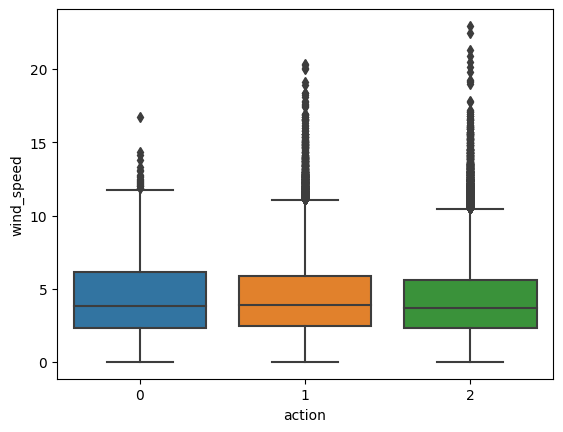

In [126]:
sns.boxplot(x='action', y='wind_speed', data=rewards_df)
# plt.savefig("./plots/ws_per_action.png");

<AxesSubplot:xlabel='action', ylabel='prices'>

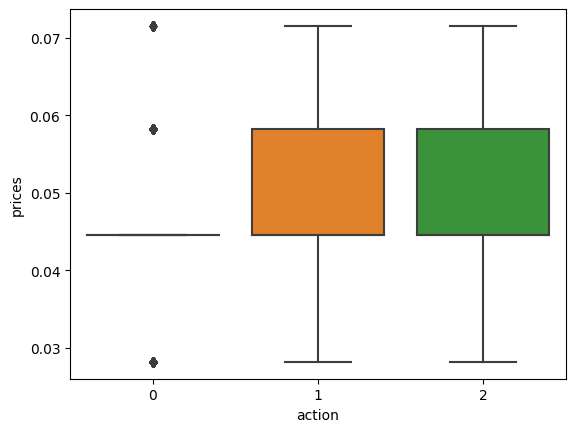

In [127]:
sns.boxplot(x='action', y='prices', data=rewards_df)
# plt.savefig("./plots/prices_per_action.png");

Text(0.5, 1.0, 'Reward evolution')

<Figure size 1400x800 with 0 Axes>

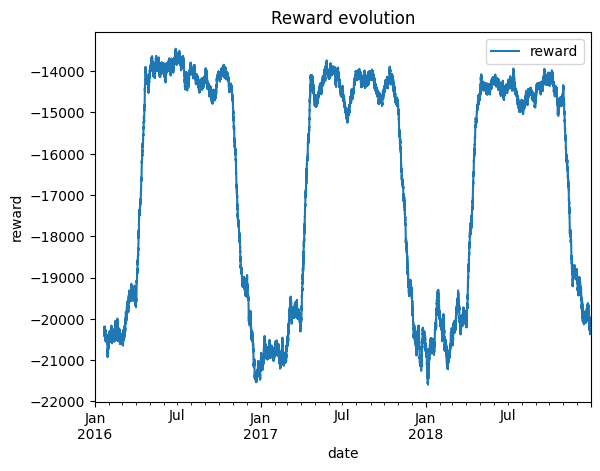

In [128]:
plt.figure(figsize=(14, 8))
pd.DataFrame({"reward":reward_list}, index=wind_hydrogen_15min.index[:-1]).rolling(window=2000).mean().plot()
plt.xlabel('date')
plt.ylabel('reward')
plt.title('Reward evolution')
# plt.savefig("./plots/average_reward.png");

In [89]:
# model.save("acc_windhy_3")

# Repredicting with the first A2C model

WARNING: there are changes certainly due to the random seed or initialization which might bring different results.

In [66]:
# del model
# model_2 = A2C.load("acc_windhy_2.zip")
# model_2_1 = A2C.load("acc_windhy_2_1.zip")

In [67]:
model_2_1.get_parameters()

{'policy': OrderedDict([('mlp_extractor.policy_net.0.weight',
               tensor([[ 2.3501e-01, -4.8584e-01, -1.1078e-01, -1.8404e-01, -6.0246e-02,
                         8.4400e-04, -1.7268e-01],
                       [-5.8634e-02, -8.6156e-02,  3.3883e-01,  1.2844e-01, -1.7183e-02,
                        -4.8143e-02, -1.2200e-01],
                       [ 2.4539e-01,  2.6419e-01, -5.6722e-02,  8.1050e-02, -1.5707e-01,
                         7.3248e-02,  3.0742e-01],
                       [ 6.5758e-02, -2.9582e-01, -2.5429e-01,  5.2124e-02,  5.5909e-02,
                        -1.4116e-01, -1.5335e-01],
                       [-6.7203e-02,  2.5865e-02, -2.5925e-01, -2.7949e-01, -2.9891e-01,
                         1.4584e-01,  1.4126e-01],
                       [-5.9343e-01, -6.1212e-02,  5.5303e-03, -3.2888e-01,  1.5849e-02,
                         1.9919e-01, -1.2902e-01],
                       [ 2.3904e-01,  2.9939e-01,  1.7491e-01,  1.3747e-01, -2.2361e-02,
         

In [52]:
# reward_list = []
# action_list = []
# obs = env.reset()
# done = False
# while not done:
#     action, _states = model.predict(obs)
#     obs, rewards, done, info = env.step(action)
#     action_list.append(action)
#     reward_list.append(rewards)
#     env.render()

In [53]:
# rewards_df = pd.DataFrame({"reward":reward_list, 
#                            "wind_speed":wind_hydrogen["wind_speed"][1:],
#                            "prices":wind_hydrogen["prices"][1:],
#                            "action":action_list}, index=wind_hydrogen.index[1:])

In [54]:
# rewards_df.query("action==2").describe()

In [55]:
# sns.boxplot(x='action', y='wind_speed', data=rewards_df)

In [56]:
# sns.boxplot(x='action', y='prices', data=rewards_df)